In [1]:
import sys
import os
sys.path.append(os.path.abspath('../..'))

from utlis.scan_engine_utlis.scan_eng_big_utlis import log_experiment_data
from status_field_config_mini_250220 import STATUS_FIELDS_CONFIG
if __name__ == "__main__":
    root_dir = "/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted" #"/data/big_rim/mir_data/Oct3V1mini/Oct3V1mini_sorted"
    failed_paths_file = None #'/data/big_rim/mir_data/Oct3V1mini/Oct3V1mini_sorted/sync_failed.txt'

    # 1) Delete all parquet files first
    # remove_all_parquet_files(root_dir)

    # 2) Then log only My_V4_Miniscope
    force_reprocess = []
    rescan_days = 0.001  # Lower for quick re-scan testing

    log_experiment_data(root_dir, failed_paths_file, STATUS_FIELDS_CONFIG,
                        force_reprocess=force_reprocess,
                        rescan_days=rescan_days)


Log for 20241002PMCLE1/customEntValHere/2025_02_27/14_00_06 saved at /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20241002PMCLE1/customEntValHere/2025_02_27/14_00_06/folder_log.parquet
Log for 20240910-V1-R/customEntValHere/2024_11_01/12_52_48 saved at /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240910-V1-R/customEntValHere/2024_11_01/12_52_48/folder_log.parquet
Log for 20240919V1L5/customEntValHere/2024_10_31/13_14_16 saved at /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240919V1L5/customEntValHere/2024_10_31/13_14_16/folder_log.parquet
Log for 20240919-V1-R1/customEntValHere/2024_12_31/14_24_53 saved at /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240919-V1-R1/customEntValHere/2024_12_31/14_24_53/folder_log.parquet
Log for 20241212v1l1r1/customEntValHere/2024_12_31/11_31_05 saved at /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20241212v1l1r1/customEntValHere/2024_12_31/11_31_05/folder_log.parquet
Log for 20241212v1l1r1/customEntValHere/2024_12_31/11_41_01 saved at /data/b

In [2]:
# sys.path.append(os.path.abspath('../..'))
from utlis.scan_engine_utlis.scan_engine_utlis import read_all_parquet_files
# base_folder = "/hpc/group/tdunn/Bryan_Rigs/BigOpenField/24summ"
all_mini = read_all_parquet_files(root_dir)

In [3]:
import pyarrow.compute as pc
table = all_mini #combined_df


filter_mask = pc.and_(
    pc.equal(table['minian'], '0'), 
    pc.equal(table['valid_rec'], '1') #not_equal
)


# Apply the filter and print the results
filtered_table_mini = table.filter(filter_mask)

# Print each row of the filtered table
print(filtered_table_mini.to_pandas())  # This will display the filtered data in a familiar pandas-like format


  minian minian_selected valid_rec                   timestamp  \
0      0               0         1  2025-03-25T13:40:23.241058   
1      0               0         1  2025-03-25T13:40:23.251804   
2      0               0         1  2025-03-25T13:40:23.260601   
3      0               0         1  2025-03-25T13:40:23.213273   
4      0               0         1  2025-03-25T13:40:23.262720   
5      0               0         1  2025-03-25T13:40:23.263383   
6      0               0         1  2025-03-25T13:40:23.263615   

         animal_id      custom_label        date       time  
0  20240717-PMC-r1  customEntValHere  2024_10_24  #12_32_37  
1   20241001PMCRE2  customEntValHere  2025_02_12   15_23_02  
2  20241002-PMC-R1  customEntValHere  2024_10_24   13_23_51  
3   20241212v1l1r1  customEntValHere  2024_12_31   11_41_01  
4   20241224PMCLE1  customEntValHere  2025_02_13   11_23_53  
5   20241224PMCLE1  customEntValHere  2025_02_13   11_48_21  
6   20241224PMCLE1  customEntValHere 

In [ ]:
import pyarrow as pa
import subprocess
import os
from utlis.Ca_tools.mini_param_vis_utlis import run_param_search_from_table
# def run_param_search_from_table(filtered_table_mini):
#     """
#     Iterate through each row in `filtered_table_mini` (a PyArrow Table),
#     construct the session_dir from relevant columns, and then call
#     param_search_driver.py in a subprocess with the desired arguments.
#     """
#     # Convert table to a list of dictionaries, each representing one row
#     rows = filtered_table_mini.to_pylist()

#     for row in rows:
#         # Extract needed columns (adjust the column names as necessary)
#         # e.g. row["animal_id"], row["custom_label"], row["date"], row["time"]
#         animal_id    = row["animal_id"]       # e.g. "20241015PMCBE1"
#         custom_label = row["custom_label"]    # e.g. "customEntValHere"
#         date_str     = row["date"]            # e.g. "2025_03_11"
#         time_str     = row["time"]            # e.g. "14_22_12"

#         # Build the session_dir path based on your folder structure.
#         # Example:
#         #   /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/{animal_id}/{custom_label}/{date_str}/{time_str}/My_V4_Miniscope
#         session_dir = os.path.join(
#             "/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted",
#             animal_id,
#             custom_label,
#             date_str,
#             time_str,
#             "My_V4_Miniscope"
#         )

#         # (Optional) Check that it exists or not, or create if needed:
#         if not os.path.exists(session_dir):
#             print(f"Warning: session_dir not found: {session_dir}")
#             # If you want to create it:
#             # os.makedirs(session_dir, exist_ok=True)

#         print(f"\n=== Running param_search_driver for session ===")
#         print(f"Animal:       {animal_id}")
#         print(f"Session dir:  {session_dir}")

#         # Now call param_search_driver.py, passing in the appropriate args.
#         # Adjust environment calls if needed (conda, absolute path, etc.)
#         cmd = [
#             "conda", "run", "-n", "minian",
#             "python",               # or "conda", "run", "-n", "my_env", "python" if you prefer
#             "param_search_driver.py",
#             "--session_dir", session_dir,
#             "--animal", animal_id
#         ]

#         result = subprocess.run(cmd, capture_output=True, text=True)
        
#         if result.stdout:
#             print("[STDOUT]", result.stdout)
#         if result.stderr:
#             print("[STDERR]", result.stderr)

# Example usage:
# Suppose you've already loaded your arrow table into `filtered_table_mini`.
# You can now call:

run_param_search_from_table(filtered_table_mini)



=== Running param_search_driver for session ===
Animal:       2024-016v1l1r1
Session dir:  /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/2024-016v1l1r1/customEntValHere/2025_01_23/19_17_52/My_V4_Miniscope
[STDOUT] Running combination: wnd700_stp700_max25_diff3.5_pnr1.1
loading 5 videos in folder /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/2024-016v1l1r1/customEntValHere/2025_01_23/19_17_52/My_V4_Miniscope
constructing chunks
computing max projections
calculating local maximum
selecting seeds
computing peak-noise ratio
selecting seeds
performing KS test
computing distance
computing correlations
pixel recompute ratio: 0.979381443298969
computing correlations
merging seeds
optimizing computation graph
pixel recompute ratio: 1.1121056264333267
computing correlations
building spatial matrix
computing spatial overlap
computing temporal correlation
pixel recompute ratio: 0.34418604651162793
computing correlations
labeling units to be merged
merging units
estimating penalty parameter
comput

In [7]:
import pyarrow.compute as pc
from functools import reduce
table = all_mini #combined_df


# filter_mask = pc.and_(
#     pc.equal(table['minian'], '0'), 
#     pc.equal(table['valid_rec'], '1') #not_equal
# )

conditions = [
    pc.equal(table['minian'], '1'),
    pc.equal(table['valid_rec'], '1'),
    pc.not_equal(table['minian_selected'], '1')
]

filter_mask = reduce(pc.and_, conditions)


# Apply the filter and print the results
mini_param_for_vis = table.filter(filter_mask)

# Print each row of the filtered table
print(mini_param_for_vis.to_pandas())  # This will display the filtered data in a familiar pandas-like format


   minian minian_selected valid_rec                   timestamp  \
0       1               0         1  2025-03-25T13:40:23.229025   
1       1               0         1  2025-03-25T13:40:23.255001   
2       1               0         1  2025-03-25T13:40:23.256199   
3       1               0         1  2025-03-25T13:40:23.245165   
4       1               0         1  2025-03-25T13:40:23.243323   
5       1               0         1  2025-03-25T13:40:23.235189   
6       1               0         1  2025-03-25T13:40:23.241186   
7       1               0         1  2025-03-25T13:40:23.226456   
8       1               0         1  2025-03-25T13:40:23.216323   
9       1               0         1  2025-03-25T13:40:23.222201   
10      1               0         1  2025-03-25T13:40:23.228019   
11      1               0         1  2025-03-25T13:40:23.257128   
12      1               0         1  2025-03-25T13:40:23.259977   
13      1               0         1  2025-03-25T13:40:23.26085


=== Running vis_param_opti for session ===
Animal:       2024-016v1l1r1
Session dir:  /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/2024-016v1l1r1/customEntValHere/2025_01_23/19_17_52/My_V4_Miniscope
Found 18 output files:
/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/2024-016v1l1r1/customEntValHere/2025_01_23/19_17_52/My_V4_Miniscope/minian_dataset_wnd1000_stp700_max25_diff3.5_pnrauto.nc
/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/2024-016v1l1r1/customEntValHere/2025_01_23/19_17_52/My_V4_Miniscope/minian_dataset_wnd1500_stp700_max25_diff4.0_pnrauto.nc
/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/2024-016v1l1r1/customEntValHere/2025_01_23/19_17_52/My_V4_Miniscope/minian_dataset_wnd1000_stp700_max25_diff3.5_pnr1.1.nc
/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/2024-016v1l1r1/customEntValHere/2025_01_23/19_17_52/My_V4_Miniscope/minian_dataset_wnd1500_stp700_max25_diff5.0_pnrauto.nc
/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/2024-016v1l1r1/customEntValHere/2025_01_23/19_17_52/My_

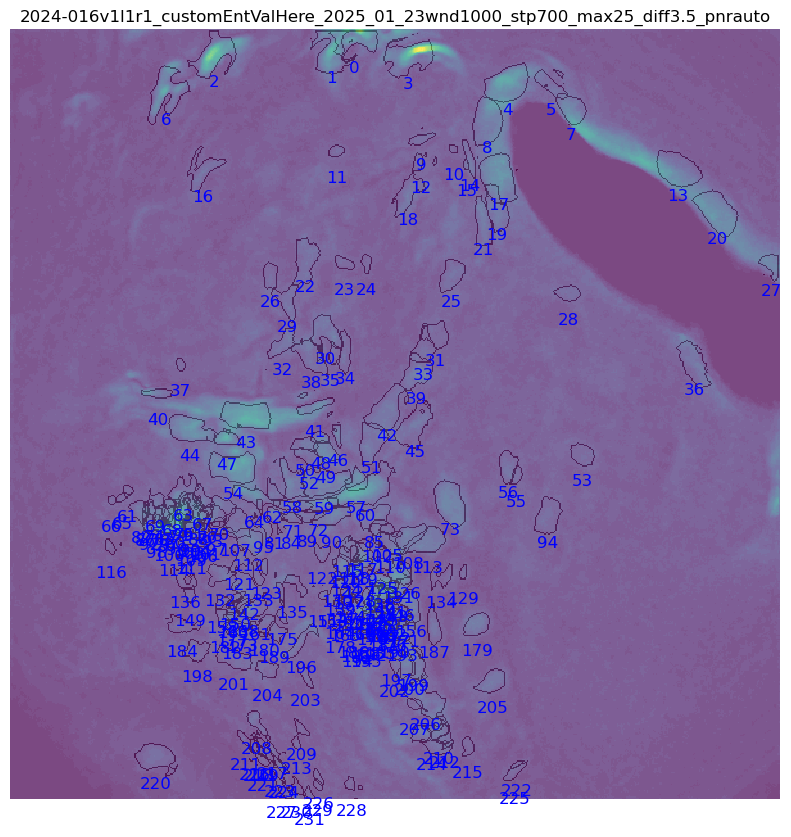

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/2024-016v1l1r1/customEntValHere/2025_01_23/19_17_52/My_V4_Miniscope/minian_dataset_wnd1500_stp700_max25_diff4.0_pnrauto.nc


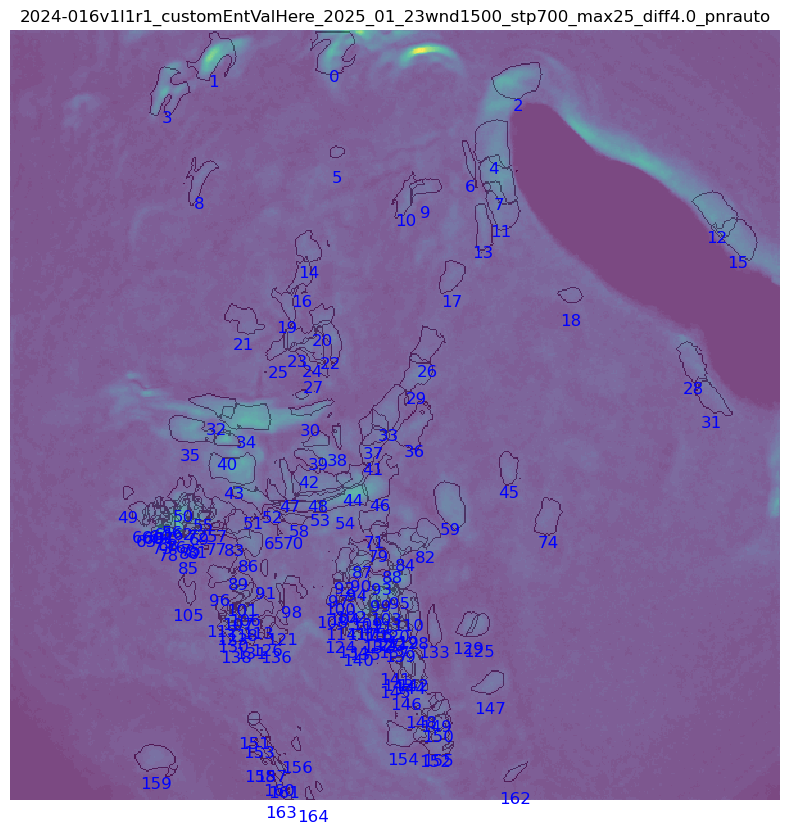

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/2024-016v1l1r1/customEntValHere/2025_01_23/19_17_52/My_V4_Miniscope/minian_dataset_wnd1000_stp700_max25_diff3.5_pnr1.1.nc


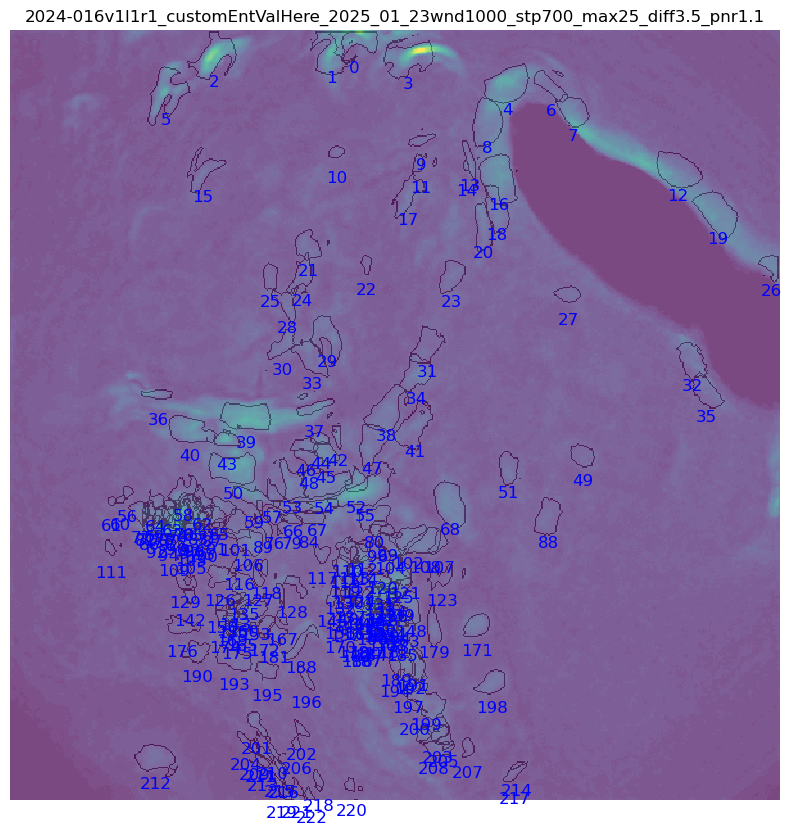

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/2024-016v1l1r1/customEntValHere/2025_01_23/19_17_52/My_V4_Miniscope/minian_dataset_wnd1500_stp700_max25_diff5.0_pnrauto.nc


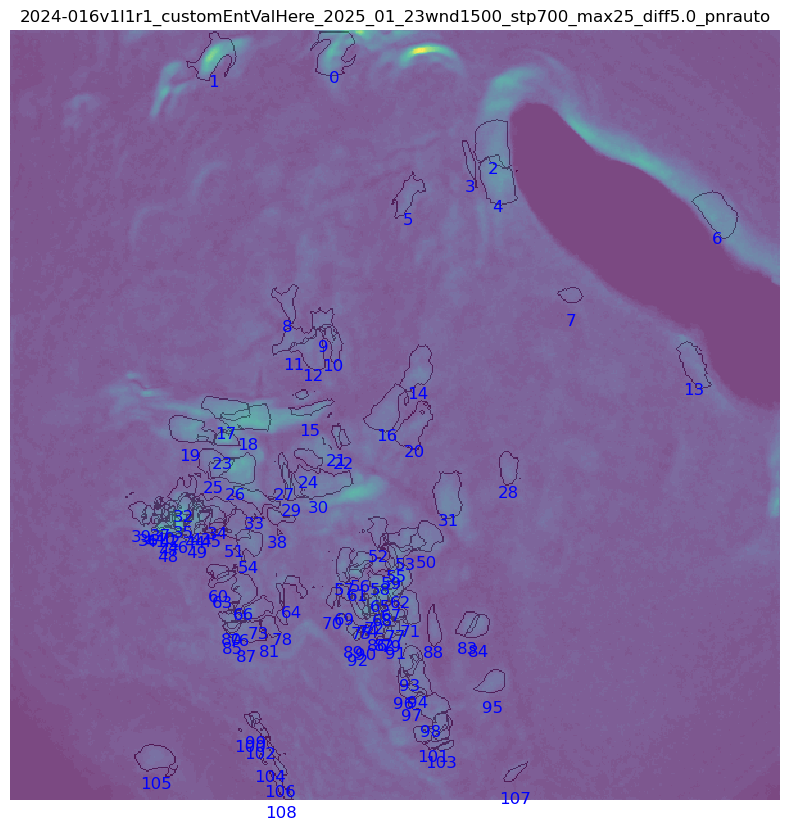

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/2024-016v1l1r1/customEntValHere/2025_01_23/19_17_52/My_V4_Miniscope/minian_dataset_wnd700_stp700_max25_diff5.0_pnr1.1.nc


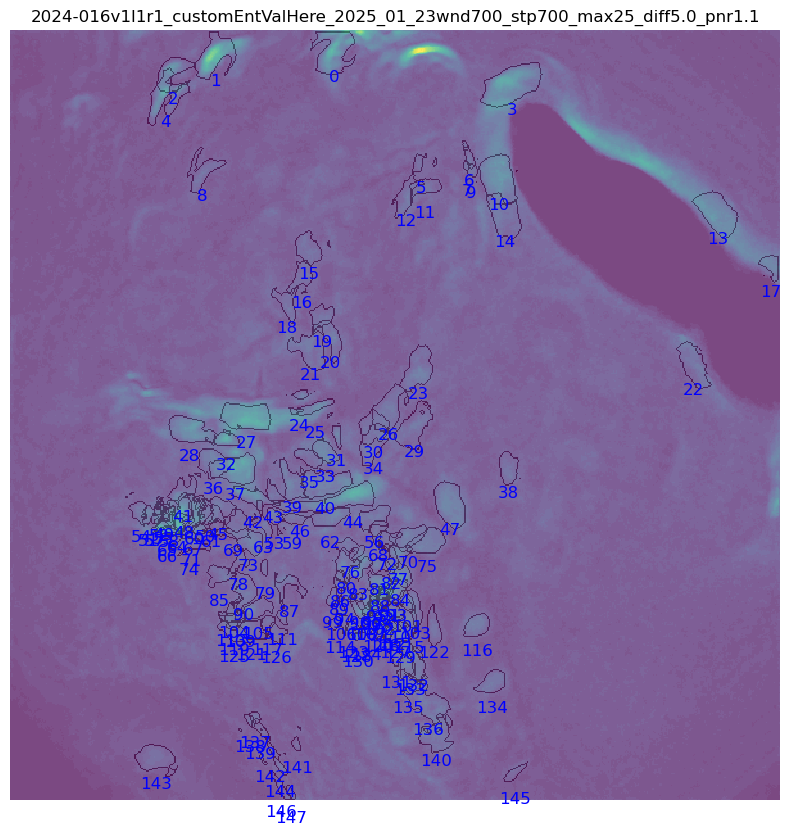

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/2024-016v1l1r1/customEntValHere/2025_01_23/19_17_52/My_V4_Miniscope/minian_dataset_wnd700_stp700_max25_diff4.0_pnrauto.nc


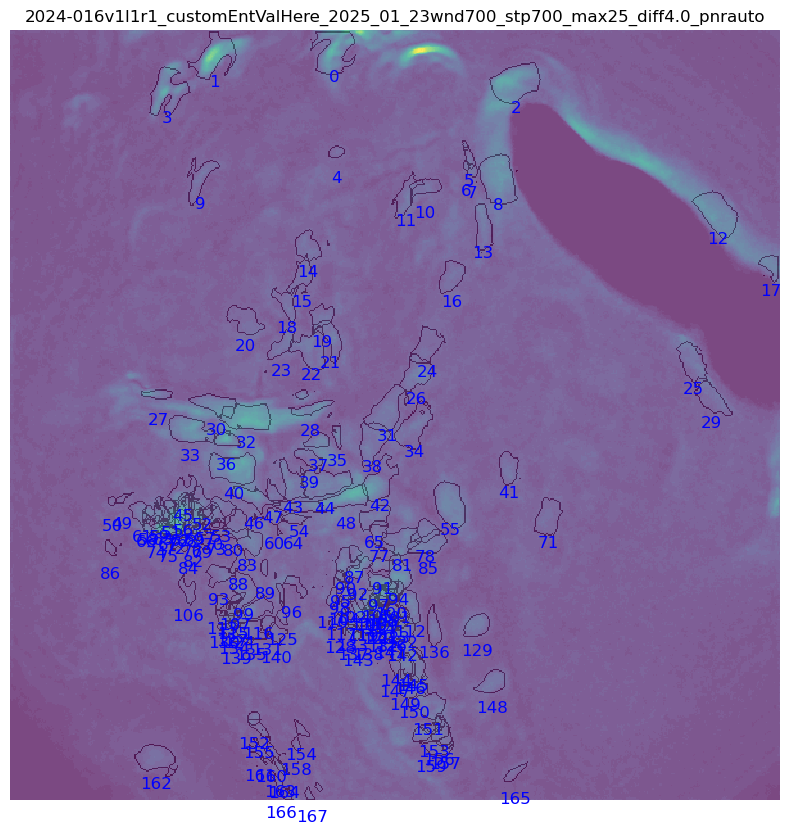

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/2024-016v1l1r1/customEntValHere/2025_01_23/19_17_52/My_V4_Miniscope/minian_dataset_wnd1000_stp700_max25_diff5.0_pnrauto.nc


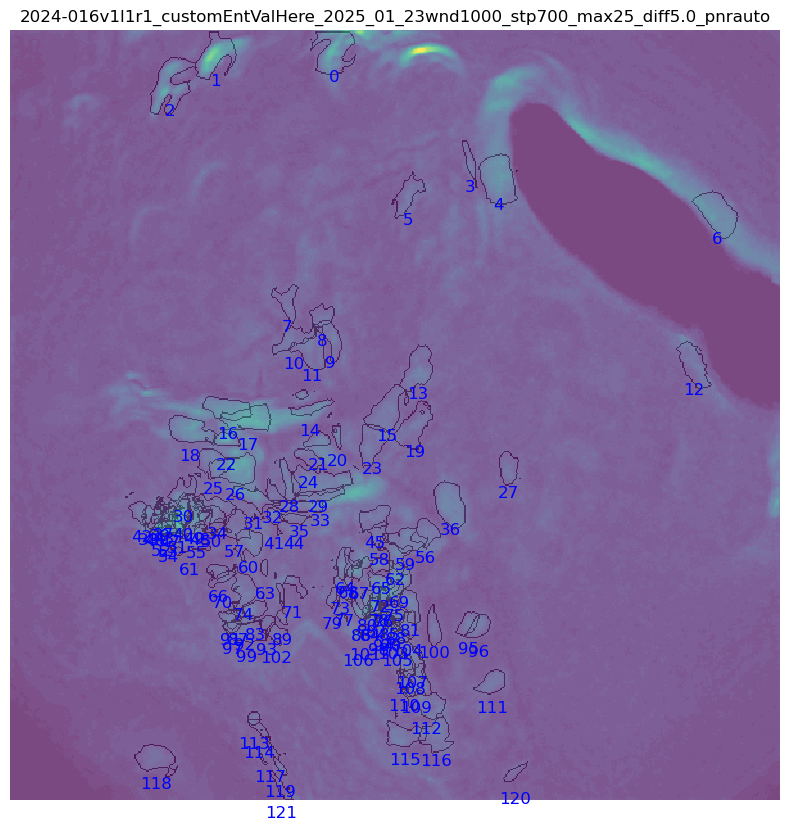

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/2024-016v1l1r1/customEntValHere/2025_01_23/19_17_52/My_V4_Miniscope/minian_dataset_wnd1500_stp700_max25_diff4.0_pnr1.1.nc


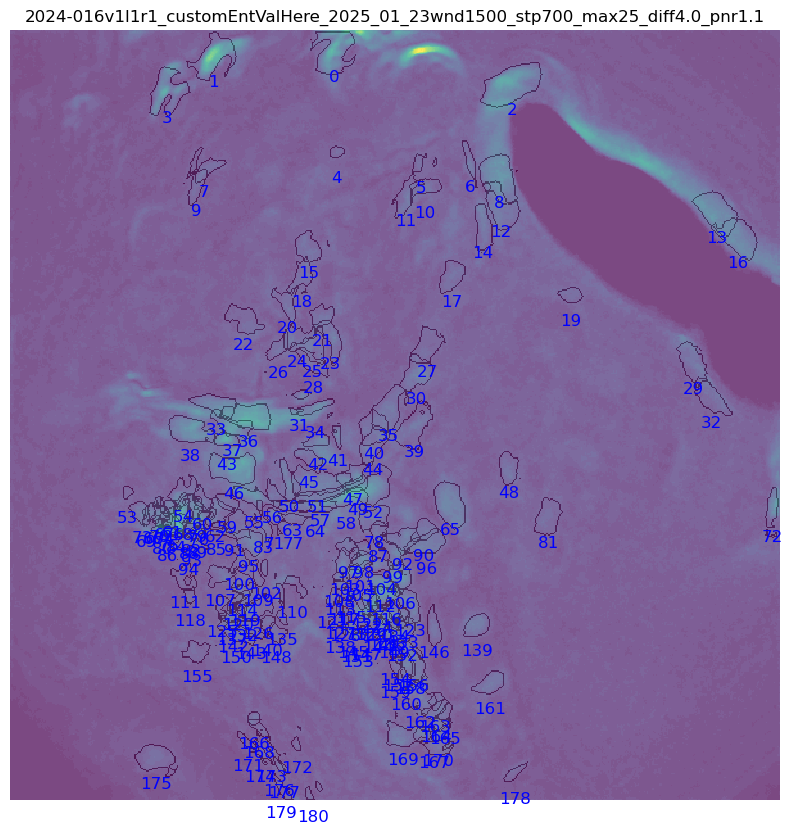

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/2024-016v1l1r1/customEntValHere/2025_01_23/19_17_52/My_V4_Miniscope/minian_dataset_wnd1500_stp700_max25_diff3.5_pnrauto.nc


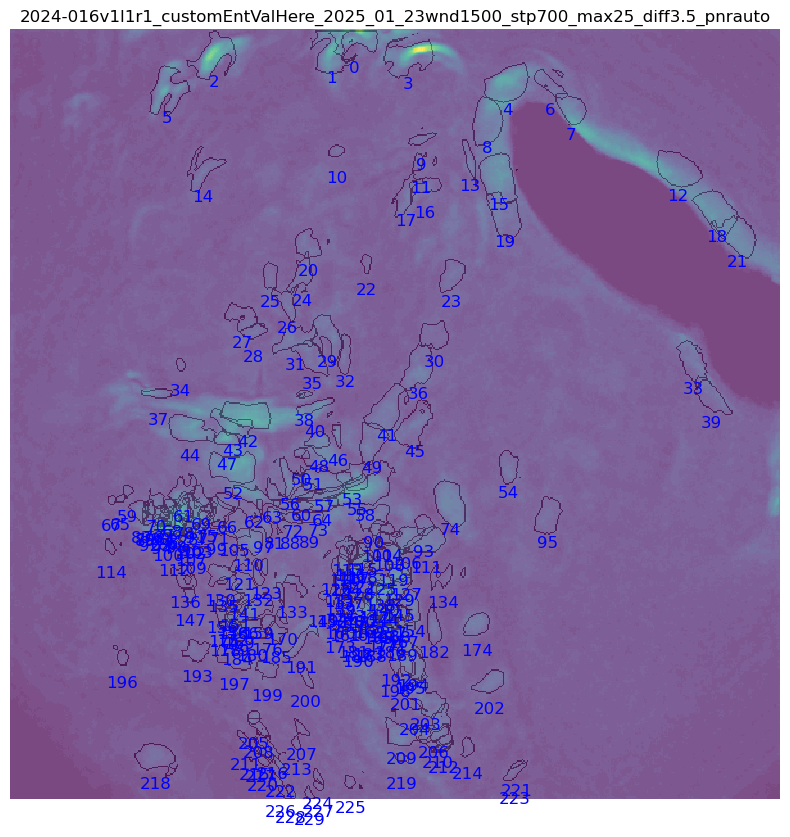

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/2024-016v1l1r1/customEntValHere/2025_01_23/19_17_52/My_V4_Miniscope/minian_dataset_wnd700_stp700_max25_diff3.5_pnr1.1.nc


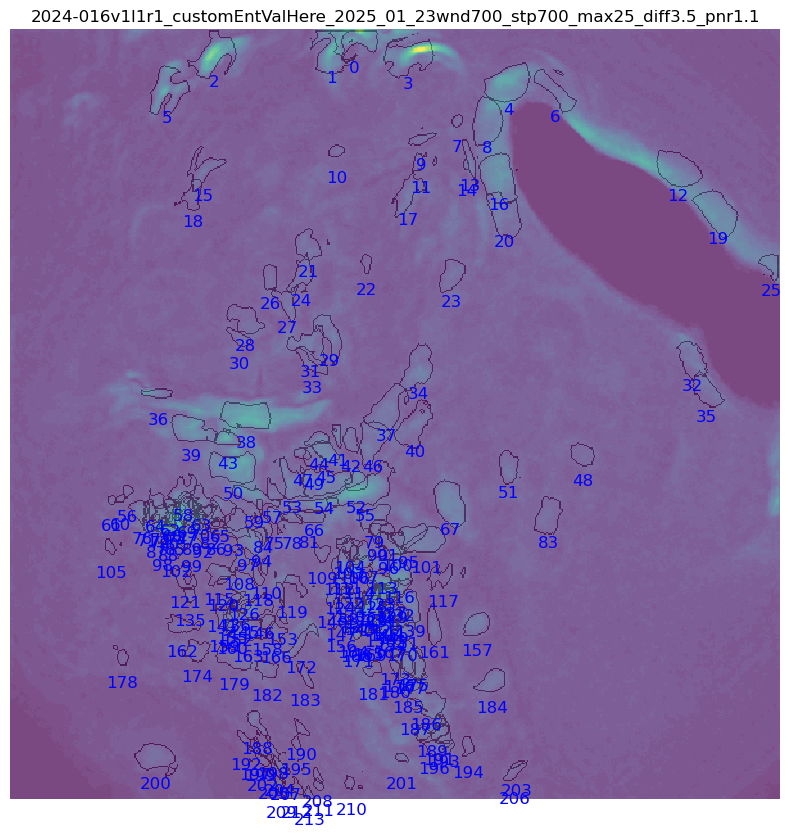

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/2024-016v1l1r1/customEntValHere/2025_01_23/19_17_52/My_V4_Miniscope/minian_dataset_wnd1500_stp700_max25_diff3.5_pnr1.1.nc


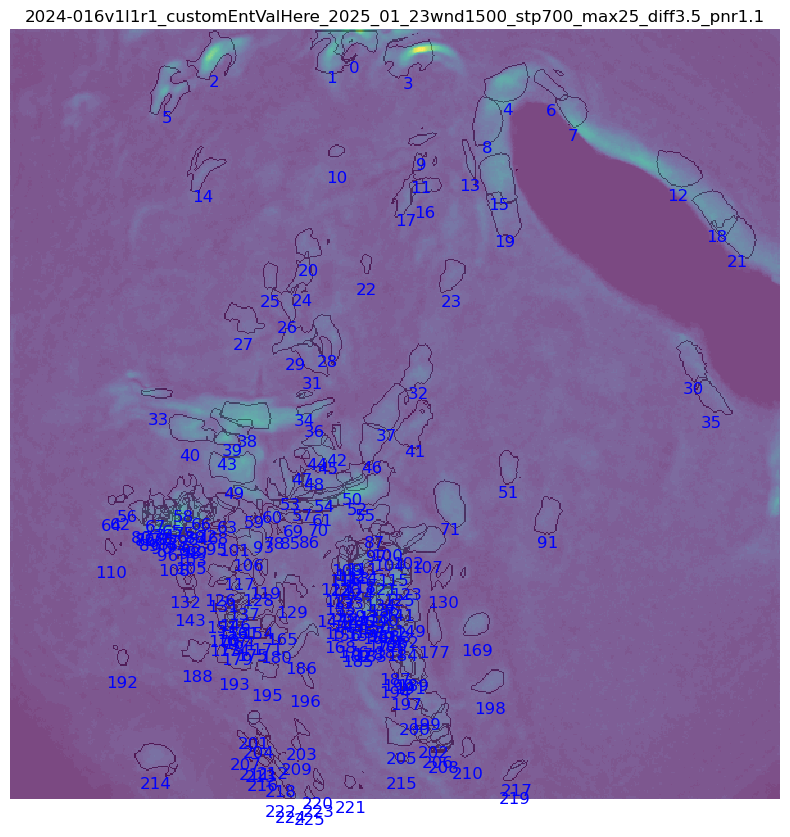

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/2024-016v1l1r1/customEntValHere/2025_01_23/19_17_52/My_V4_Miniscope/minian_dataset_wnd1000_stp700_max25_diff4.0_pnr1.1.nc


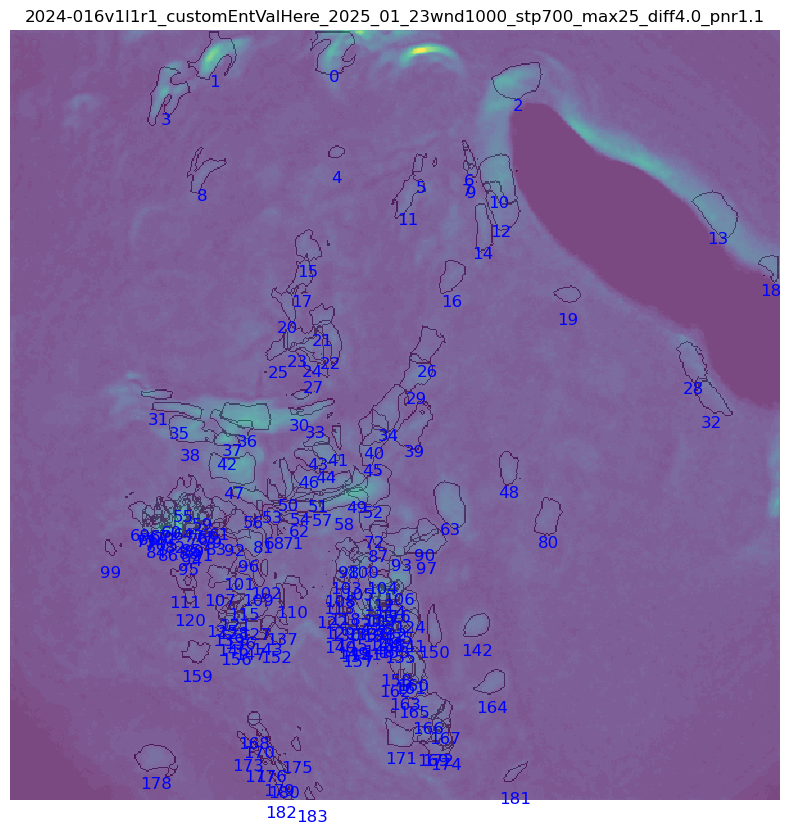

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/2024-016v1l1r1/customEntValHere/2025_01_23/19_17_52/My_V4_Miniscope/minian_dataset_wnd1500_stp700_max25_diff5.0_pnr1.1.nc


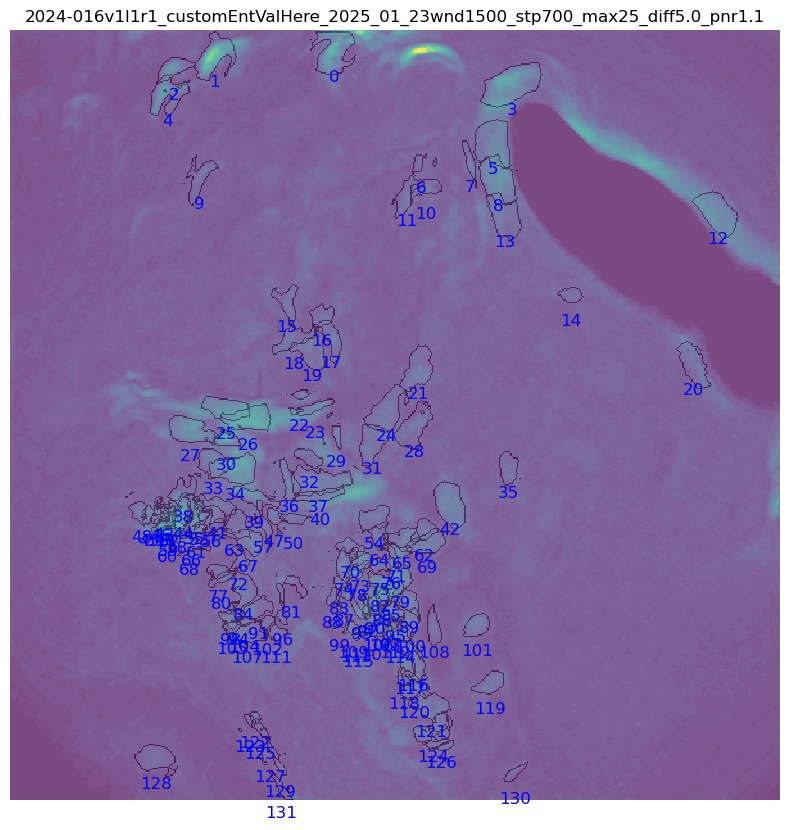

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/2024-016v1l1r1/customEntValHere/2025_01_23/19_17_52/My_V4_Miniscope/minian_dataset_wnd700_stp700_max25_diff3.5_pnrauto.nc


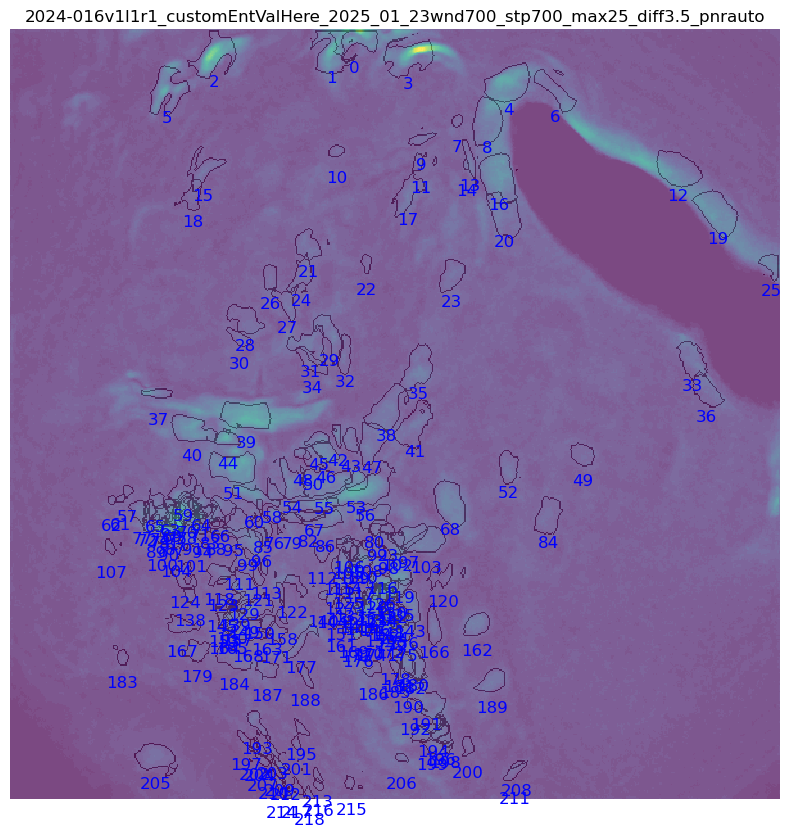

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/2024-016v1l1r1/customEntValHere/2025_01_23/19_17_52/My_V4_Miniscope/minian_dataset_wnd700_stp700_max25_diff4.0_pnr1.1.nc


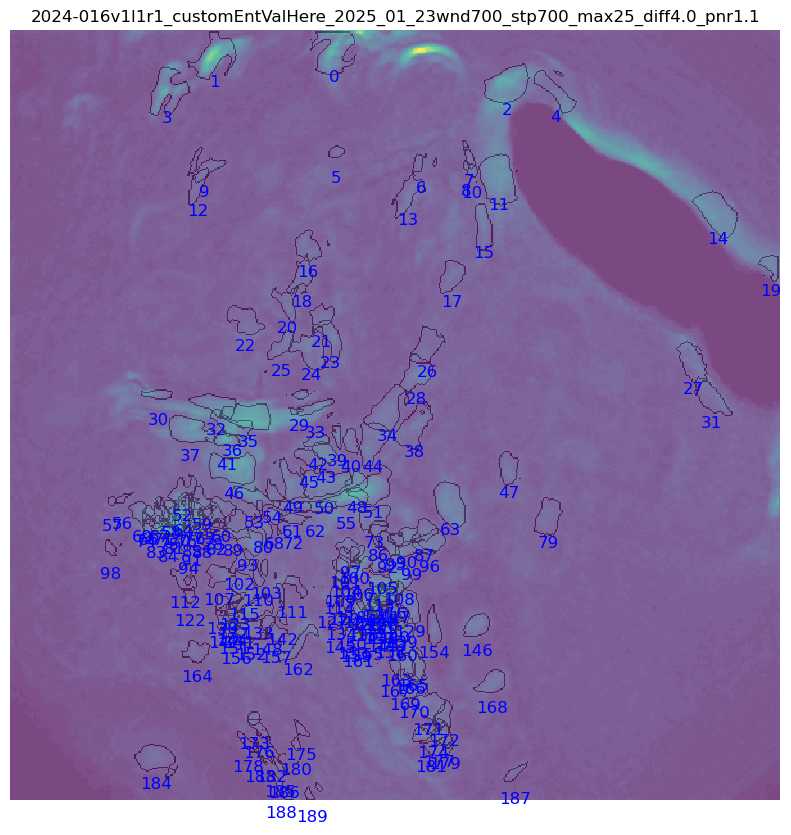

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/2024-016v1l1r1/customEntValHere/2025_01_23/19_17_52/My_V4_Miniscope/minian_dataset_wnd1000_stp700_max25_diff4.0_pnrauto.nc


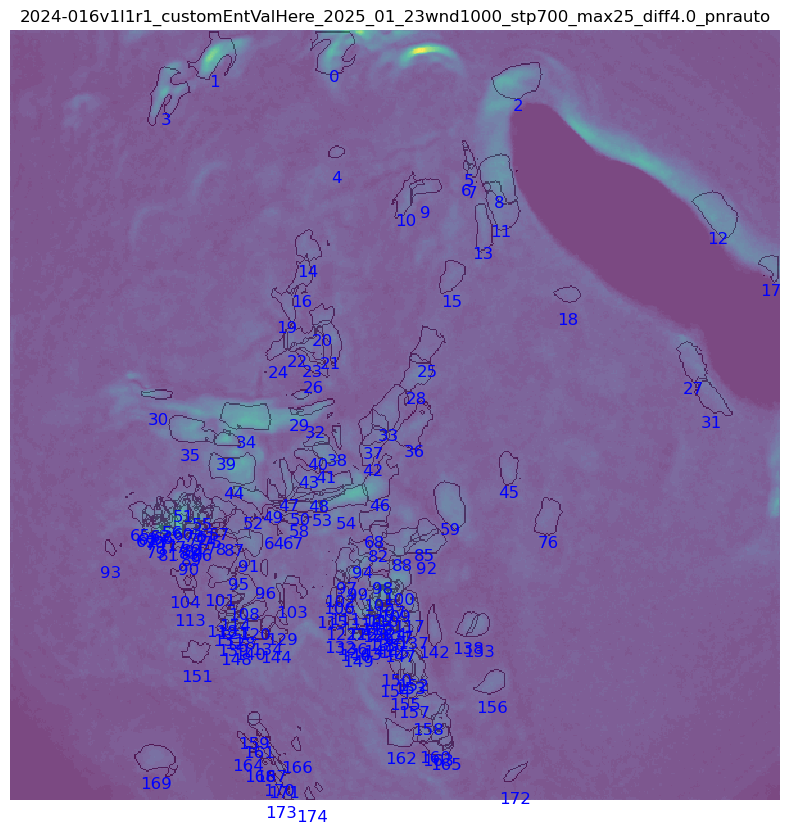

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/2024-016v1l1r1/customEntValHere/2025_01_23/19_17_52/My_V4_Miniscope/minian_dataset_wnd700_stp700_max25_diff5.0_pnrauto.nc


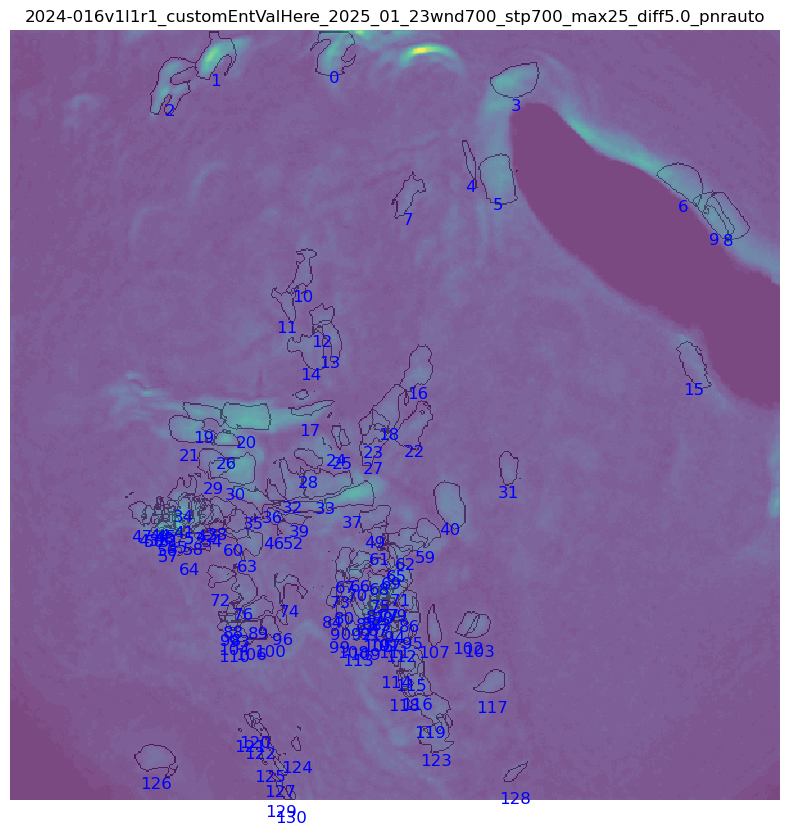

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/2024-016v1l1r1/customEntValHere/2025_01_23/19_17_52/My_V4_Miniscope/minian_dataset_wnd1000_stp700_max25_diff5.0_pnr1.1.nc


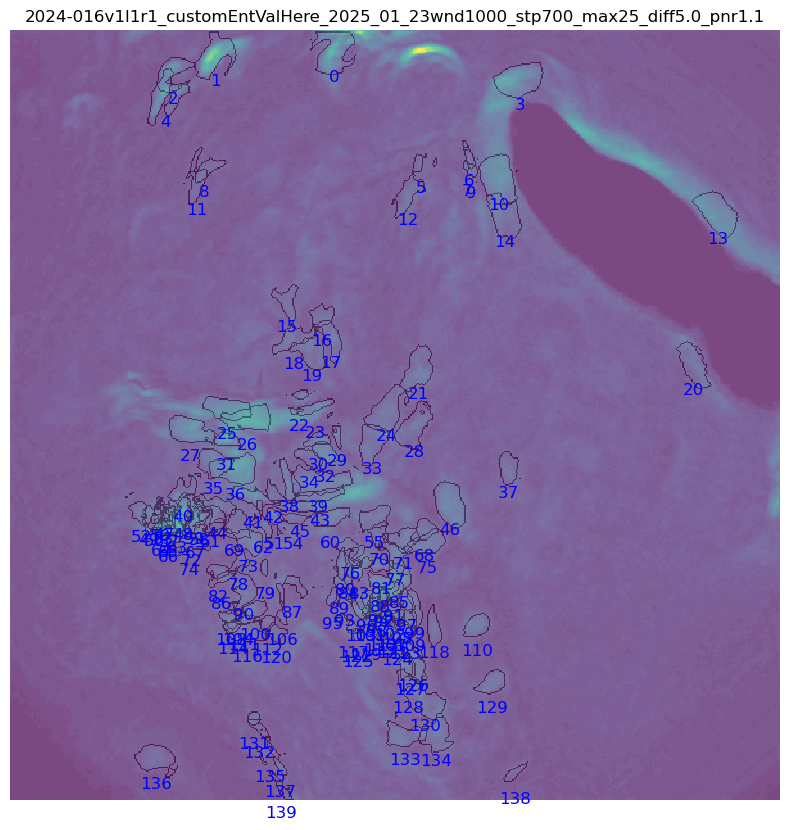


=== Running vis_param_opti for session ===
Animal:       202401015-PMC-r1
Session dir:  /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/202401015-PMC-r1/customEntValHere/2024_11_06/16_16_30/My_V4_Miniscope
Found 1 output files:
/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/202401015-PMC-r1/customEntValHere/2024_11_06/16_16_30/My_V4_Miniscope/minian_dataset_241104_denoised.nc
Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/202401015-PMC-r1/customEntValHere/2024_11_06/16_16_30/My_V4_Miniscope/minian_dataset_241104_denoised.nc


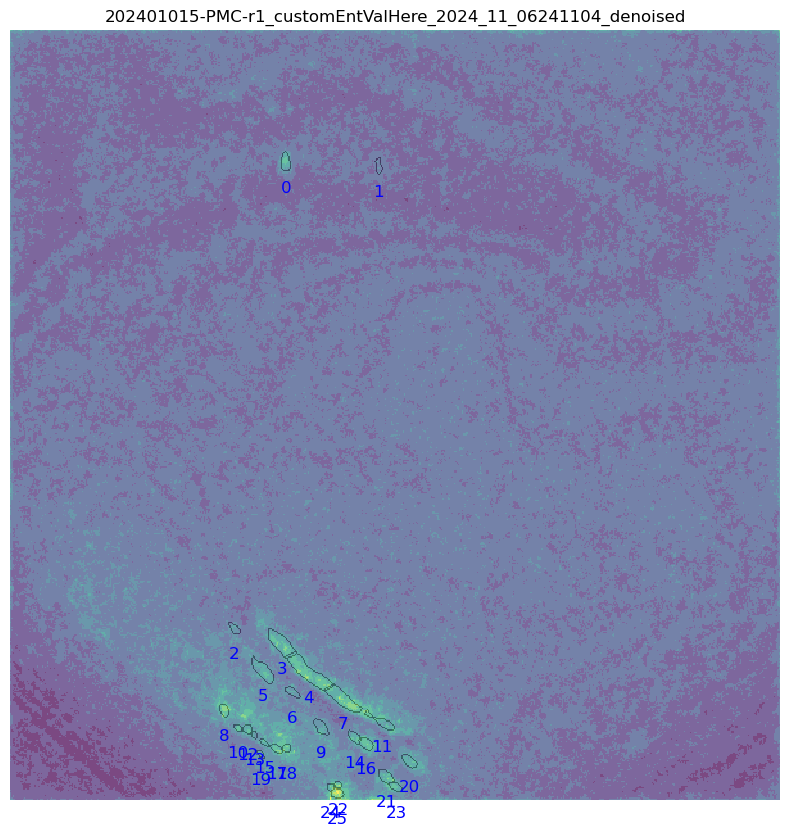


=== Running vis_param_opti for session ===
Animal:       202401015-PMC-r2
Session dir:  /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/202401015-PMC-r2/customEntValHere/2024_11_06/16_57_35/My_V4_Miniscope
Found 1 output files:
/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/202401015-PMC-r2/customEntValHere/2024_11_06/16_57_35/My_V4_Miniscope/minian_dataset_241104_denoised.nc
Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/202401015-PMC-r2/customEntValHere/2024_11_06/16_57_35/My_V4_Miniscope/minian_dataset_241104_denoised.nc


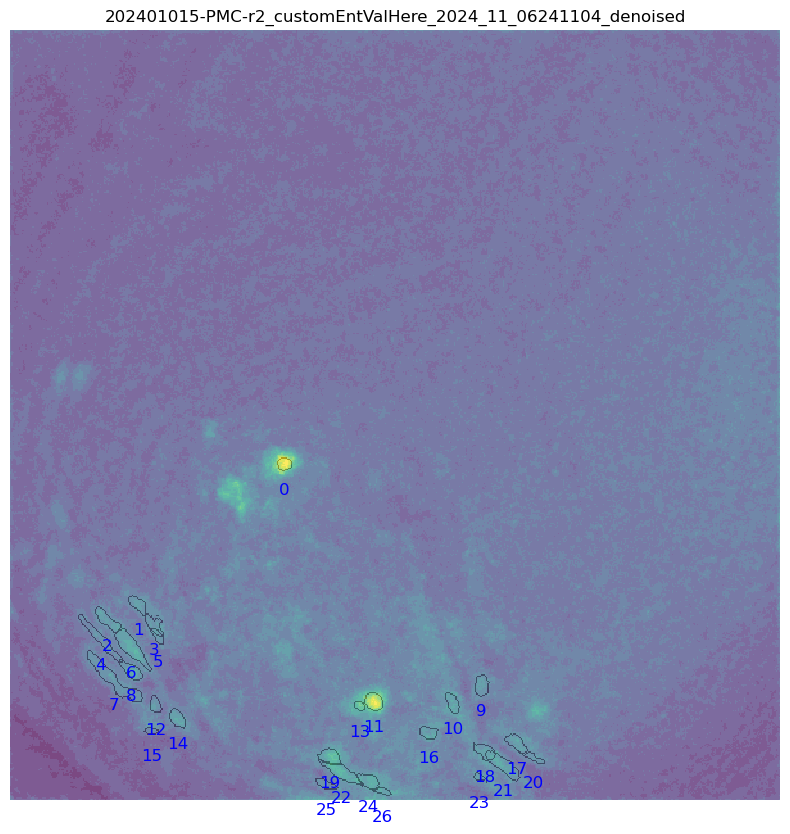


=== Running vis_param_opti for session ===
Animal:       202401015-PMC-r2
Session dir:  /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/202401015-PMC-r2/customEntValHere/2024_11_06/17_13_26/My_V4_Miniscope
Found 6 output files:
/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/202401015-PMC-r2/customEntValHere/2024_11_06/17_13_26/My_V4_Miniscope/minian_dataset_wnd1000_stp700_max15_diff3.5_pnrauto.nc
/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/202401015-PMC-r2/customEntValHere/2024_11_06/17_13_26/My_V4_Miniscope/minian_dataset_wnd700_stp700_max15_diff4.0_pnr1.1.nc
/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/202401015-PMC-r2/customEntValHere/2024_11_06/17_13_26/My_V4_Miniscope/minian_dataset_wnd700_stp700_max15_diff3.5_pnrauto.nc
/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/202401015-PMC-r2/customEntValHere/2024_11_06/17_13_26/My_V4_Miniscope/minian_dataset_wnd1000_stp700_max15_diff4.0_pnr1.1.nc
/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/202401015-PMC-r2/customEntValHere/2024_11_06/17

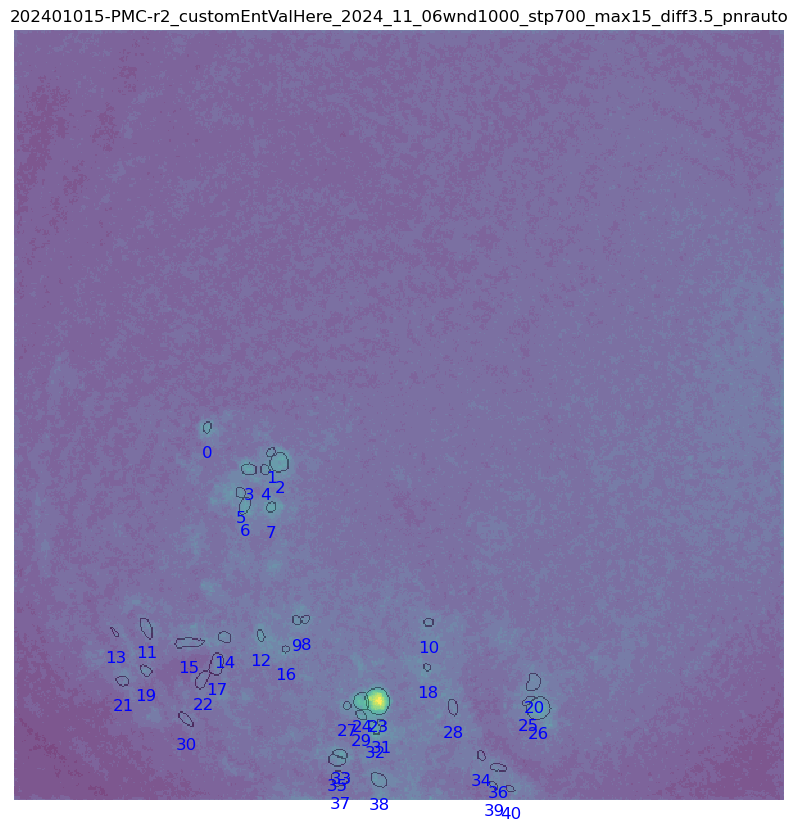

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/202401015-PMC-r2/customEntValHere/2024_11_06/17_13_26/My_V4_Miniscope/minian_dataset_wnd700_stp700_max15_diff4.0_pnr1.1.nc


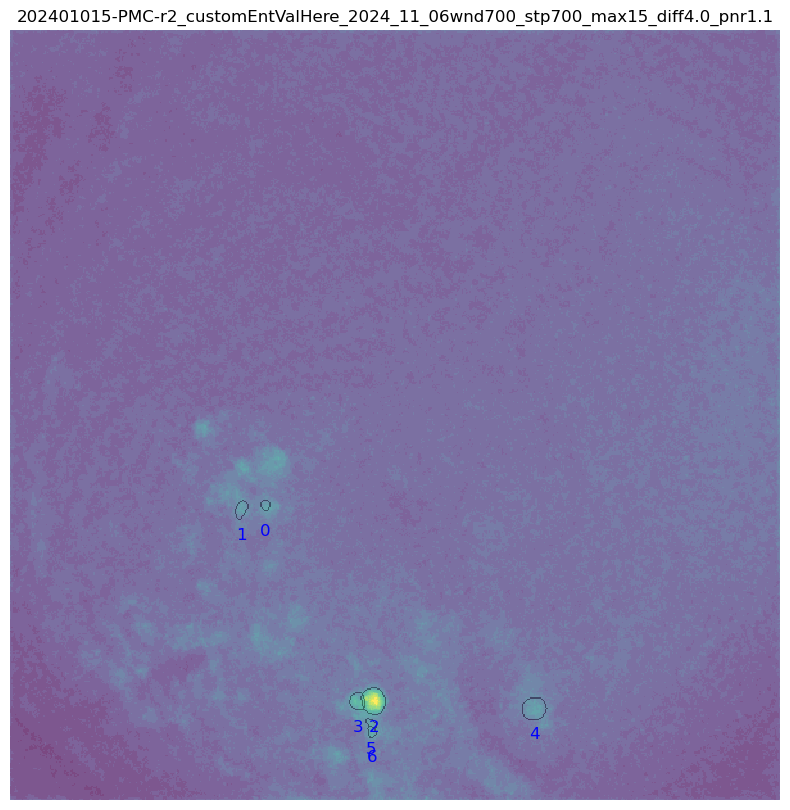

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/202401015-PMC-r2/customEntValHere/2024_11_06/17_13_26/My_V4_Miniscope/minian_dataset_wnd700_stp700_max15_diff3.5_pnrauto.nc


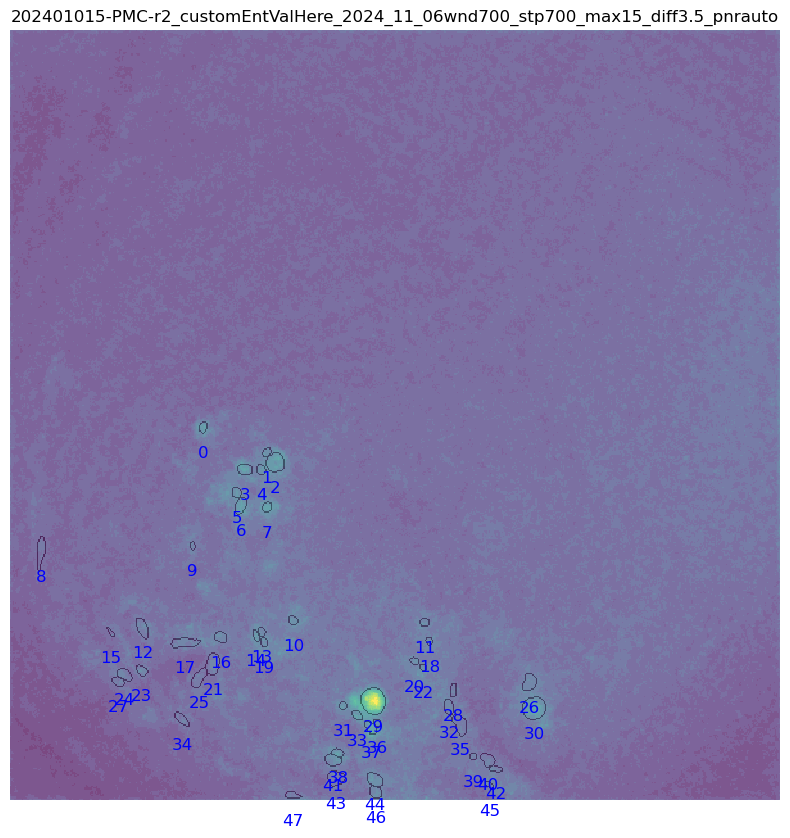

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/202401015-PMC-r2/customEntValHere/2024_11_06/17_13_26/My_V4_Miniscope/minian_dataset_wnd1000_stp700_max15_diff4.0_pnr1.1.nc


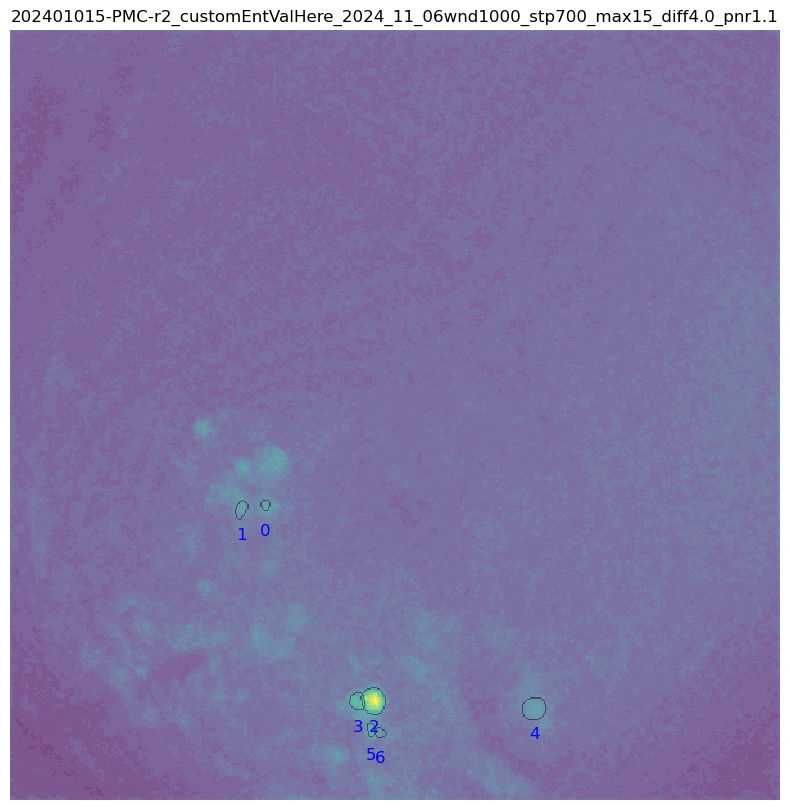

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/202401015-PMC-r2/customEntValHere/2024_11_06/17_13_26/My_V4_Miniscope/minian_dataset_wnd1000_stp700_max15_diff4.0_pnrauto.nc


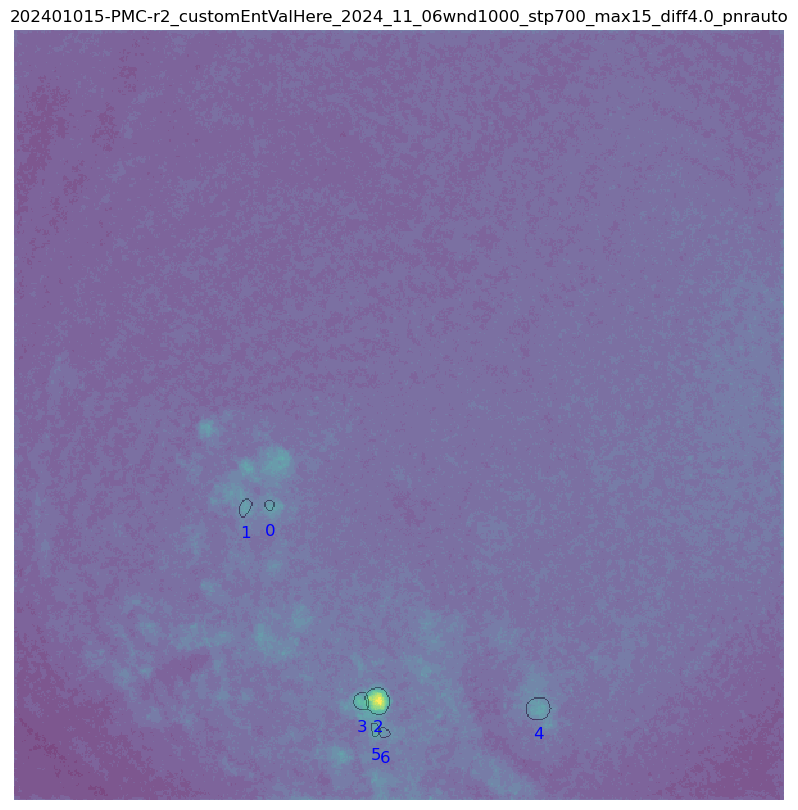

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/202401015-PMC-r2/customEntValHere/2024_11_06/17_13_26/My_V4_Miniscope/minian_dataset_wnd1500_stp700_max15_diff3.5_pnrauto.nc


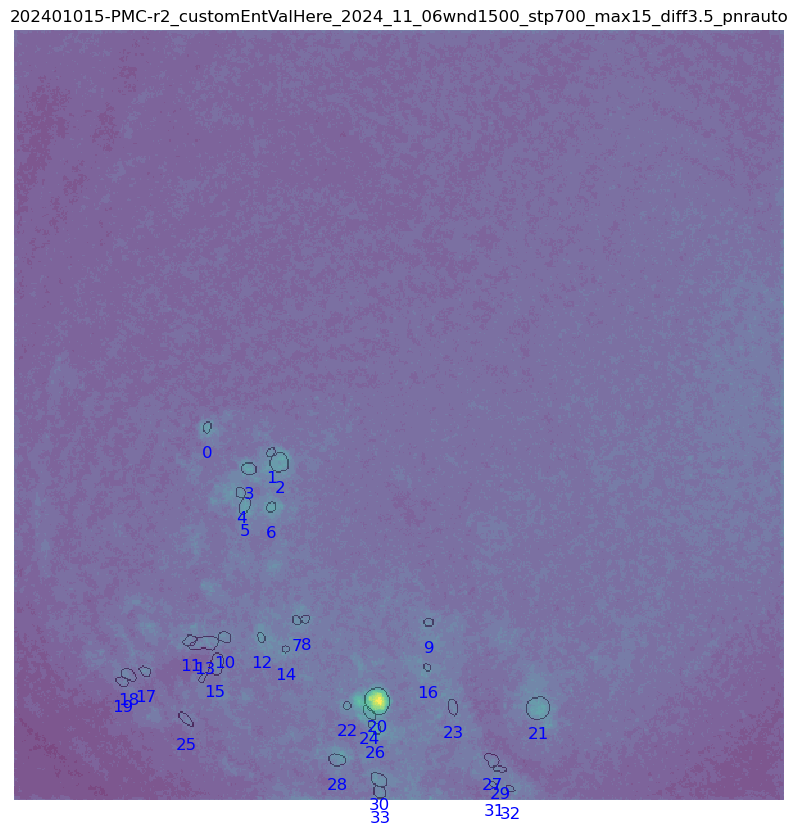


=== Running vis_param_opti for session ===
Animal:       20240819-V1-r1
Session dir:  /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240819-V1-r1/customEntValHere/2024_10_08/19_44_49/My_V4_Miniscope
Found 15 output files:
/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240819-V1-r1/customEntValHere/2024_10_08/19_44_49/My_V4_Miniscope/minian_dataset_wnd1000_stp700_max25_diff3.5_pnrauto.nc
/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240819-V1-r1/customEntValHere/2024_10_08/19_44_49/My_V4_Miniscope/minian_dataset_wnd1500_stp700_max25_diff4.0_pnrauto.nc
/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240819-V1-r1/customEntValHere/2024_10_08/19_44_49/My_V4_Miniscope/minian_dataset_wnd1000_stp700_max25_diff3.5_pnr1.1.nc
/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240819-V1-r1/customEntValHere/2024_10_08/19_44_49/My_V4_Miniscope/minian_dataset_wnd1500_stp700_max25_diff5.0_pnrauto.nc
/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240819-V1-r1/customEntValHere/2024_10_08/19_44_49/My_

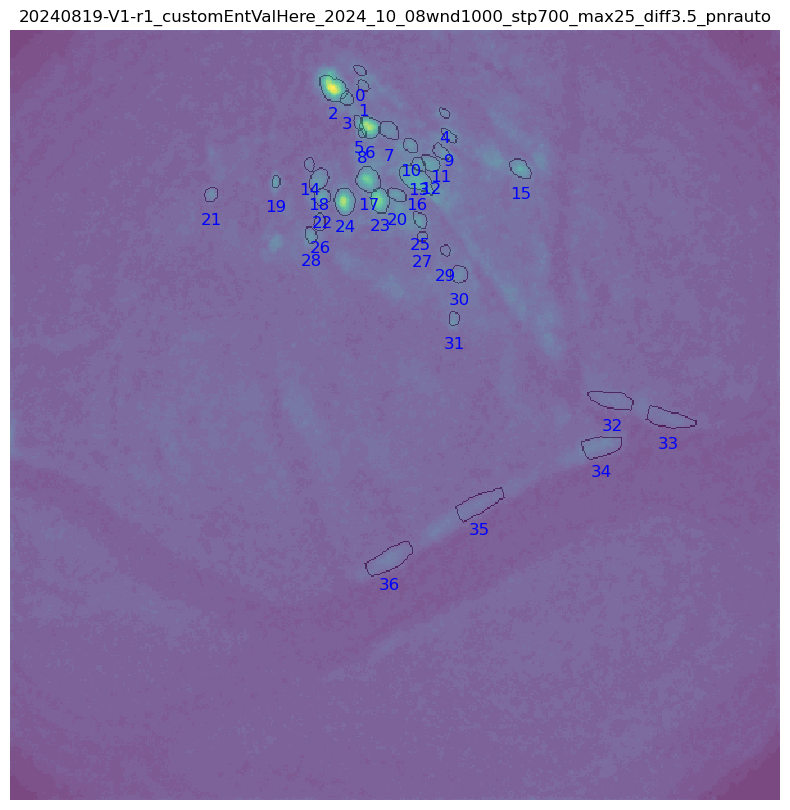

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240819-V1-r1/customEntValHere/2024_10_08/19_44_49/My_V4_Miniscope/minian_dataset_wnd1500_stp700_max25_diff4.0_pnrauto.nc


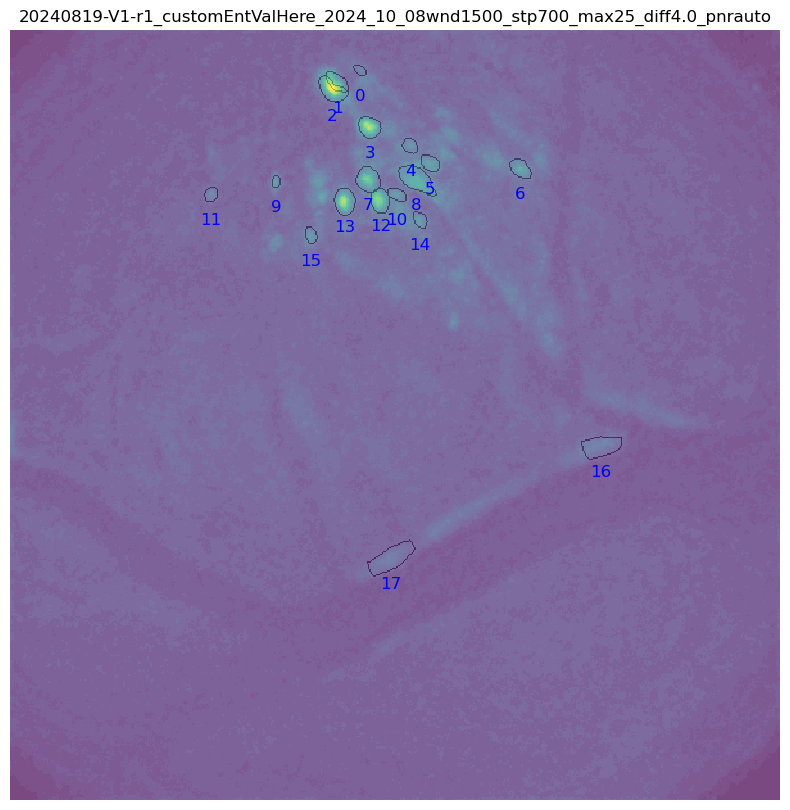

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240819-V1-r1/customEntValHere/2024_10_08/19_44_49/My_V4_Miniscope/minian_dataset_wnd1000_stp700_max25_diff3.5_pnr1.1.nc


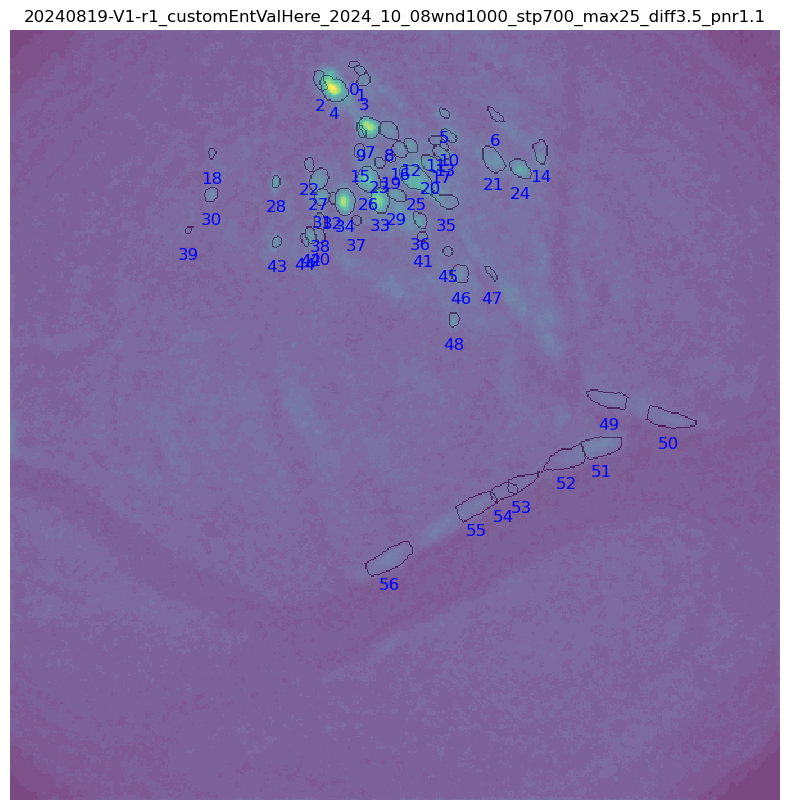

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240819-V1-r1/customEntValHere/2024_10_08/19_44_49/My_V4_Miniscope/minian_dataset_wnd1500_stp700_max25_diff5.0_pnrauto.nc


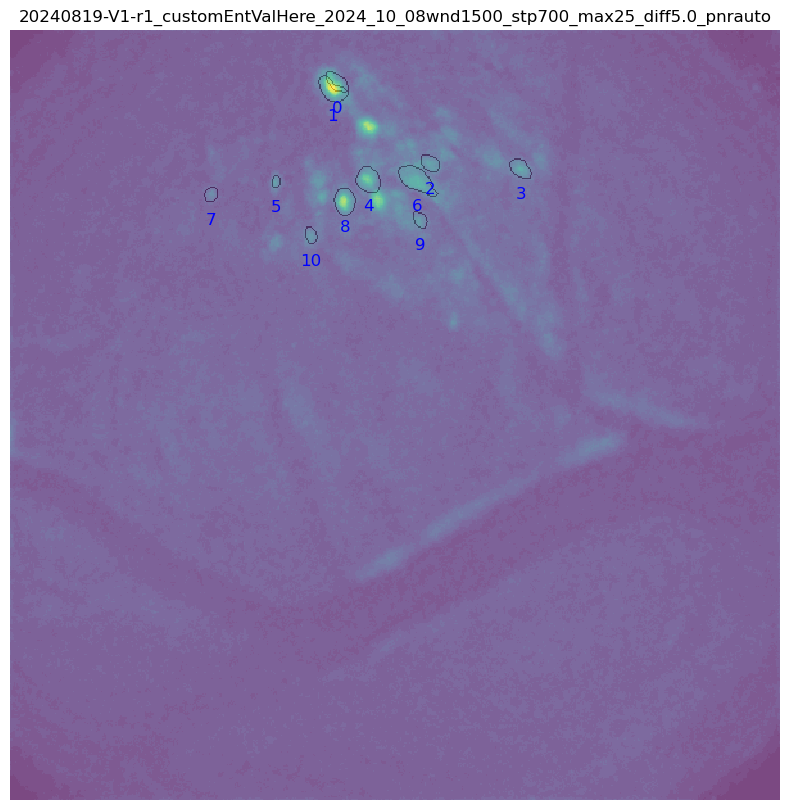

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240819-V1-r1/customEntValHere/2024_10_08/19_44_49/My_V4_Miniscope/minian_dataset_wnd700_stp700_max25_diff5.0_pnr1.1.nc


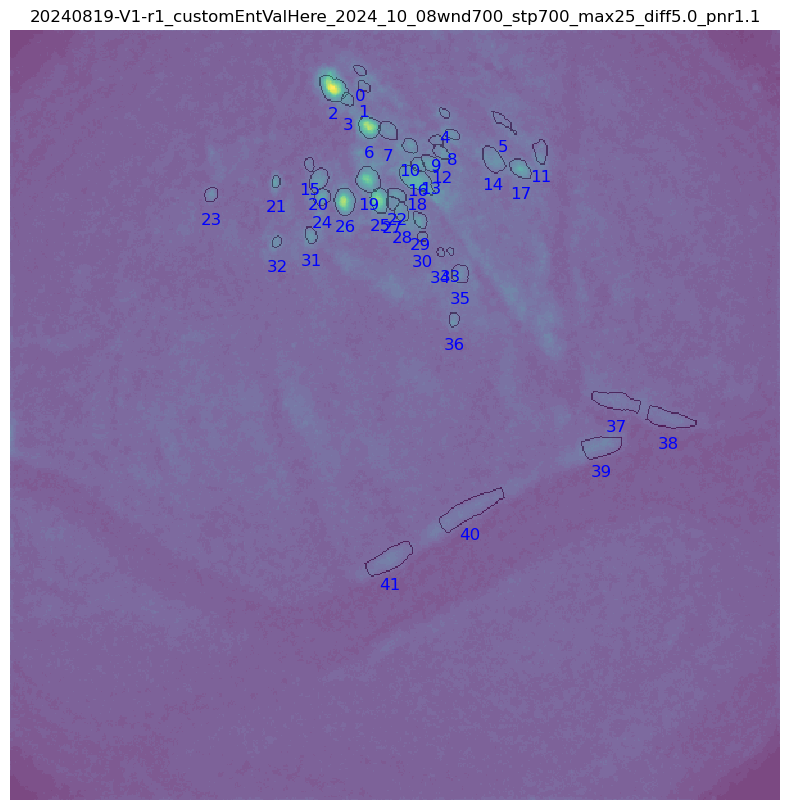

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240819-V1-r1/customEntValHere/2024_10_08/19_44_49/My_V4_Miniscope/minian_dataset_wnd700_stp700_max25_diff4.0_pnrauto.nc


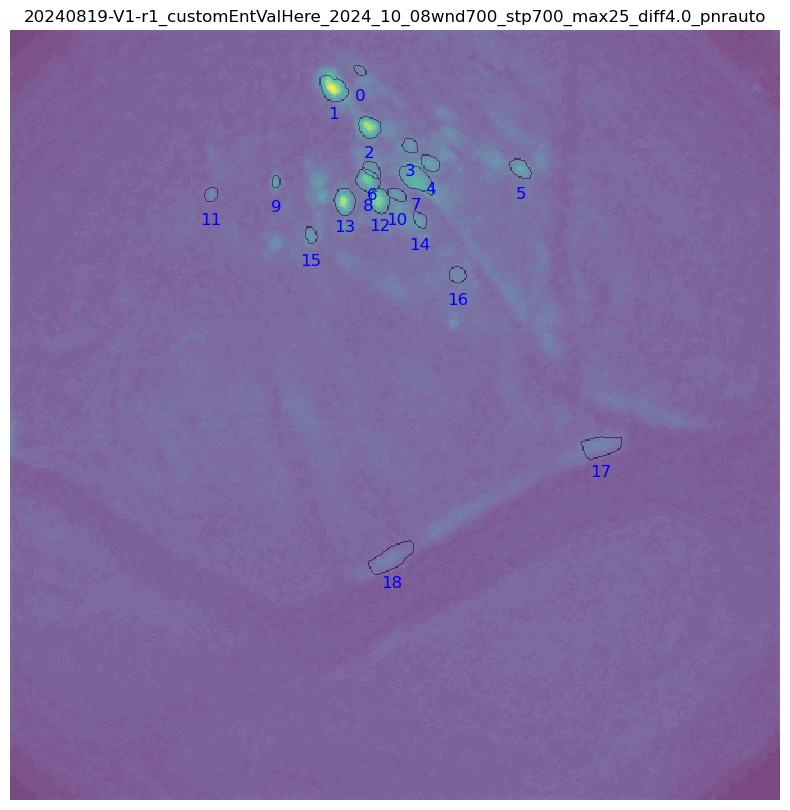

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240819-V1-r1/customEntValHere/2024_10_08/19_44_49/My_V4_Miniscope/minian_dataset_wnd1500_stp700_max25_diff4.0_pnr1.1.nc


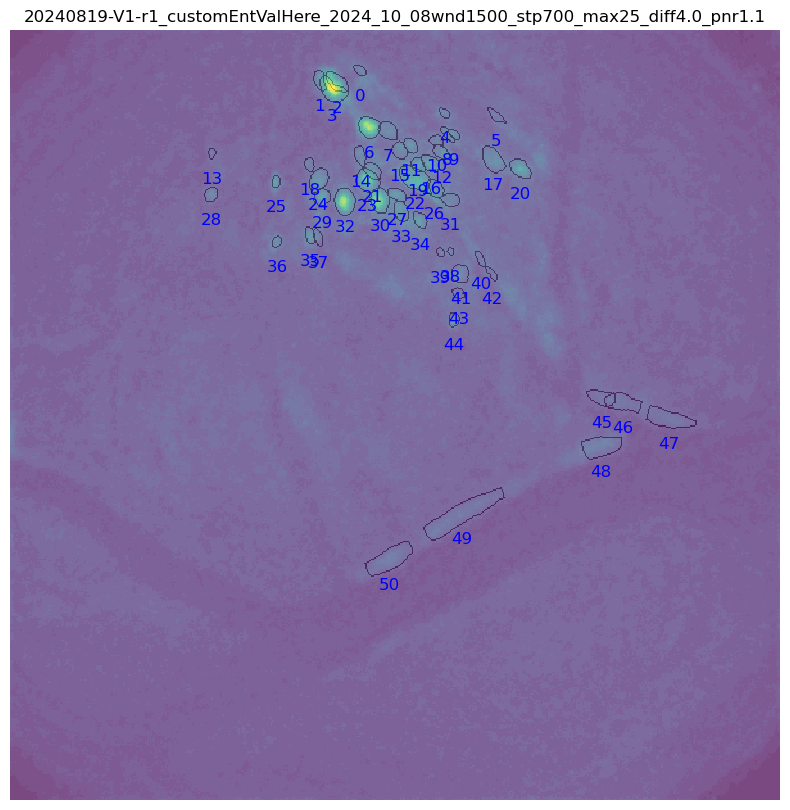

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240819-V1-r1/customEntValHere/2024_10_08/19_44_49/My_V4_Miniscope/minian_dataset_wnd1500_stp700_max25_diff3.5_pnrauto.nc


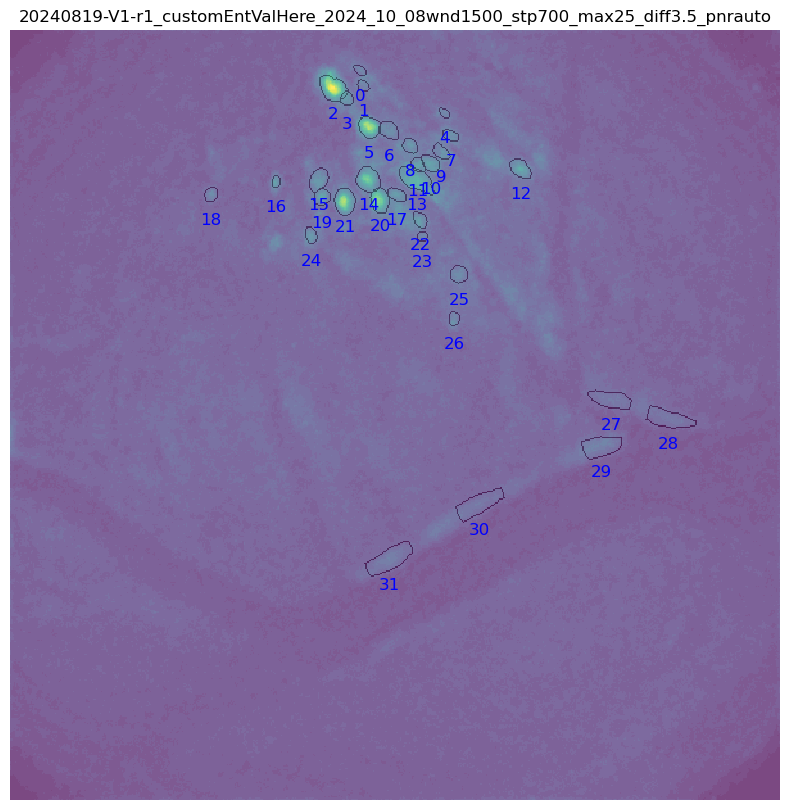

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240819-V1-r1/customEntValHere/2024_10_08/19_44_49/My_V4_Miniscope/minian_dataset_wnd700_stp700_max25_diff3.5_pnr1.1.nc


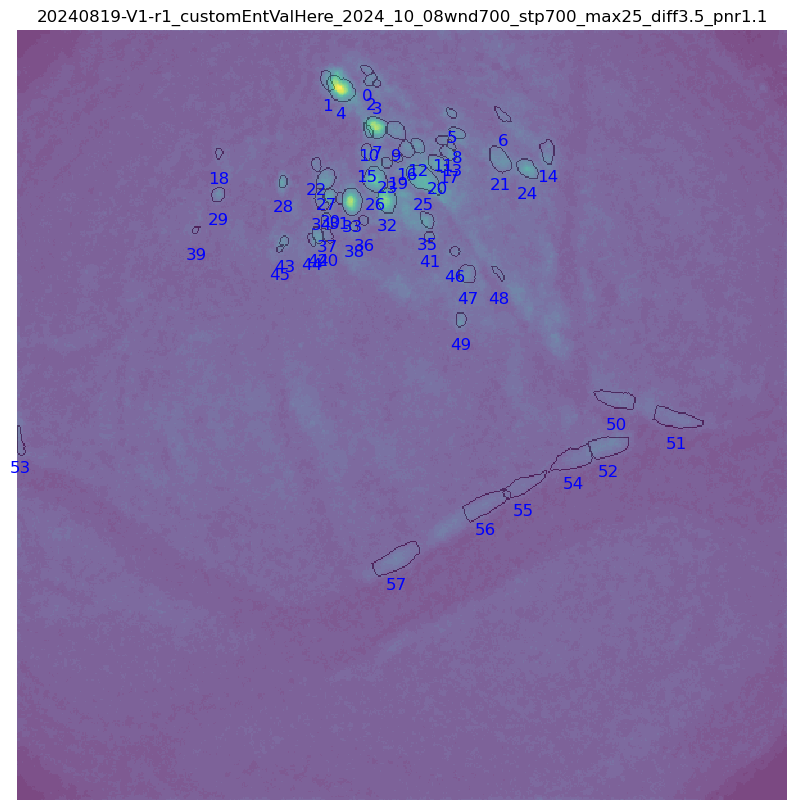

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240819-V1-r1/customEntValHere/2024_10_08/19_44_49/My_V4_Miniscope/minian_dataset_wnd1500_stp700_max25_diff3.5_pnr1.1.nc


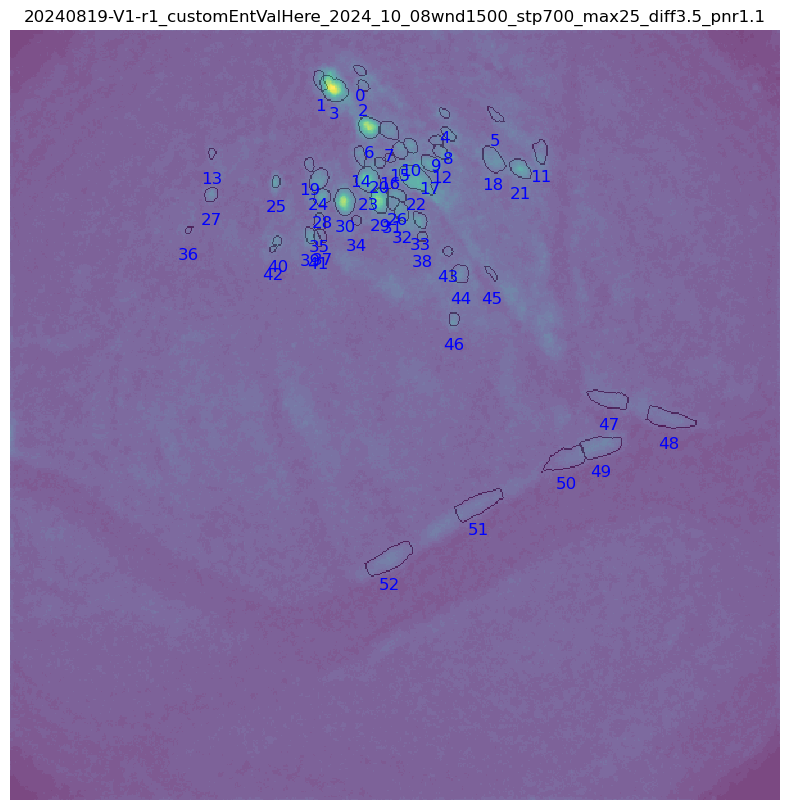

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240819-V1-r1/customEntValHere/2024_10_08/19_44_49/My_V4_Miniscope/minian_dataset_wnd1000_stp700_max25_diff4.0_pnr1.1.nc


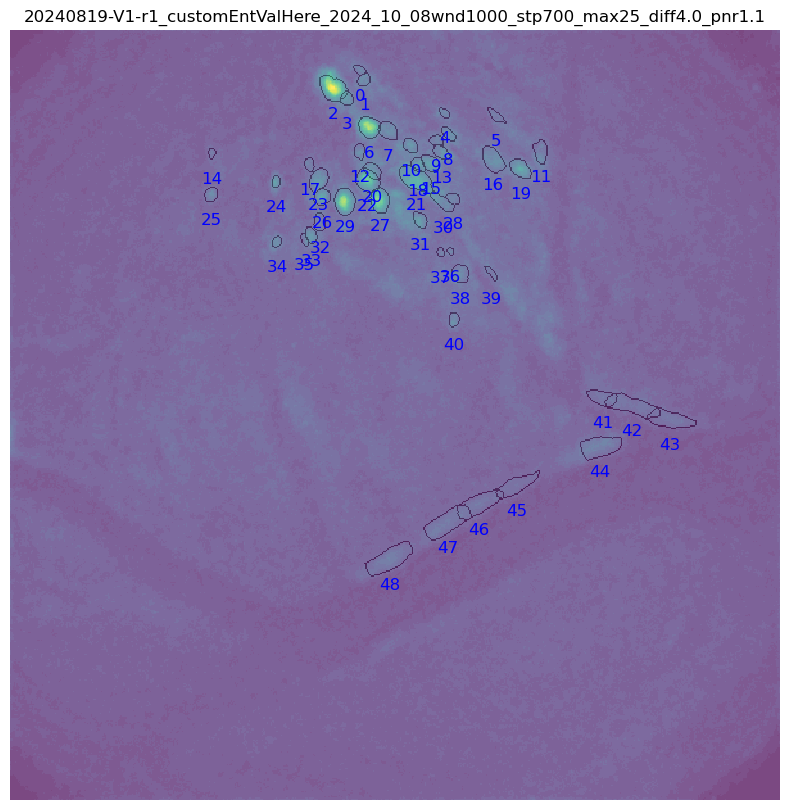

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240819-V1-r1/customEntValHere/2024_10_08/19_44_49/My_V4_Miniscope/minian_dataset_wnd1500_stp700_max25_diff5.0_pnr1.1.nc


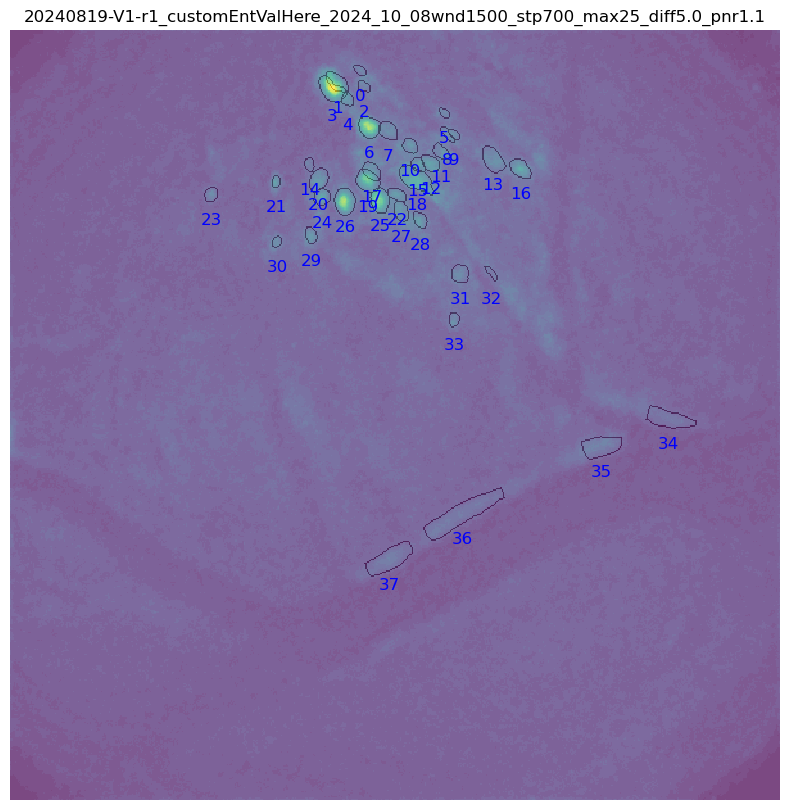

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240819-V1-r1/customEntValHere/2024_10_08/19_44_49/My_V4_Miniscope/minian_dataset_wnd700_stp700_max25_diff3.5_pnrauto.nc


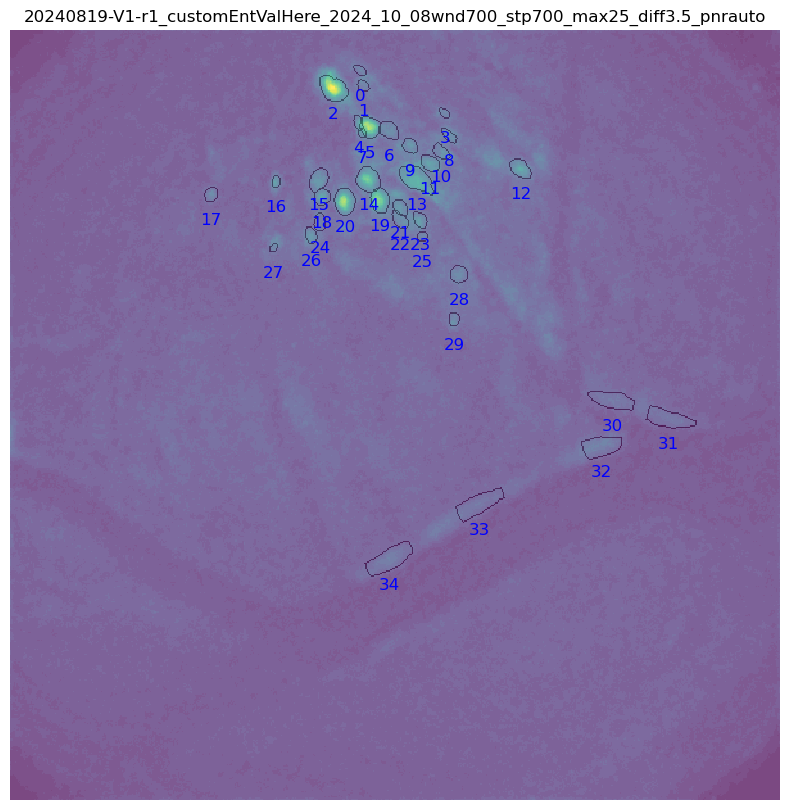

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240819-V1-r1/customEntValHere/2024_10_08/19_44_49/My_V4_Miniscope/minian_dataset_wnd700_stp700_max25_diff4.0_pnr1.1.nc


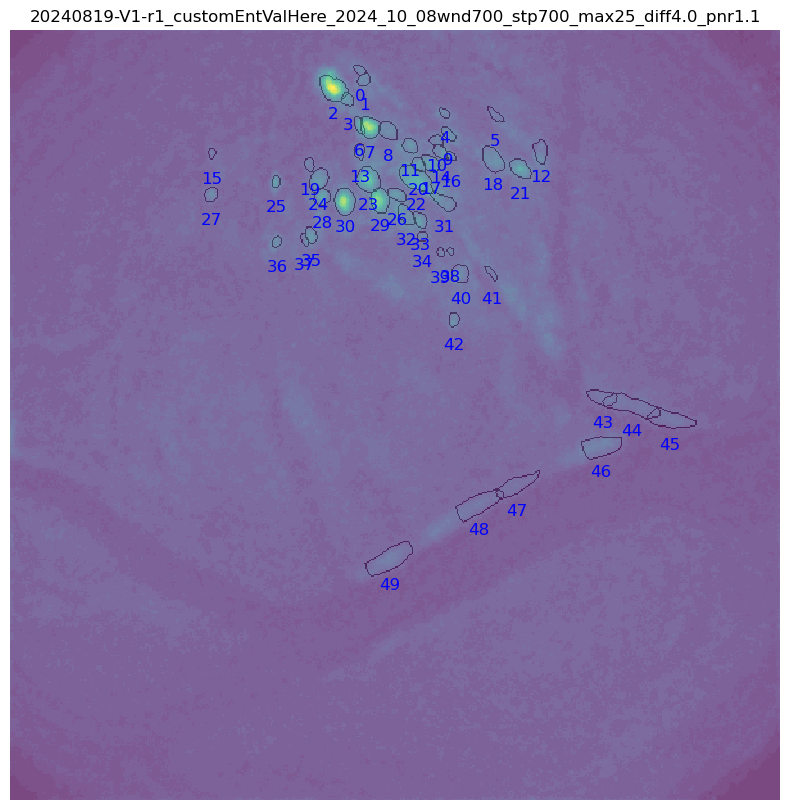

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240819-V1-r1/customEntValHere/2024_10_08/19_44_49/My_V4_Miniscope/minian_dataset_wnd1000_stp700_max25_diff5.0_pnr1.1.nc


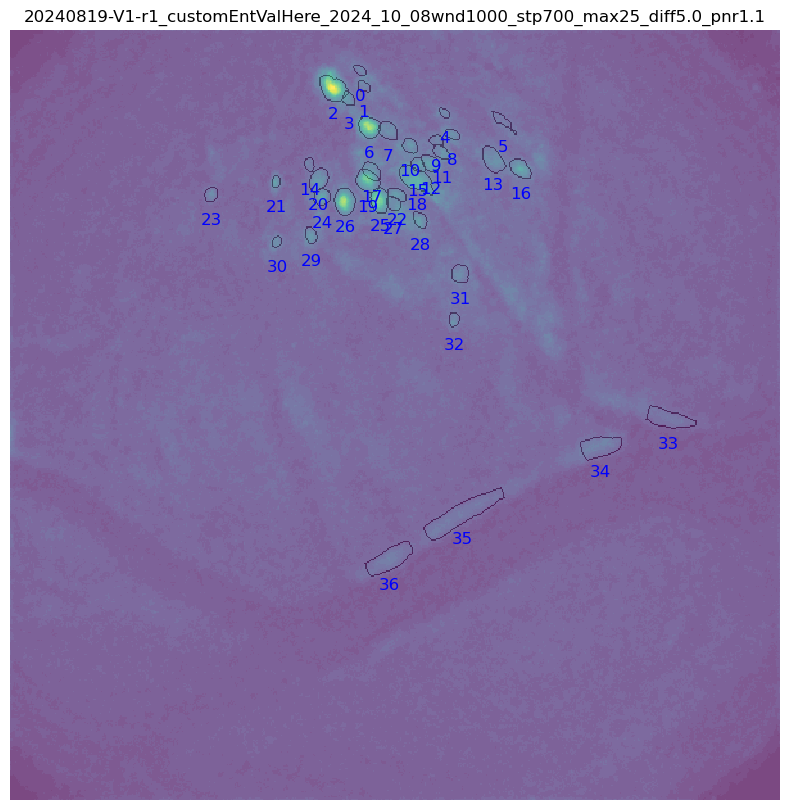


=== Running vis_param_opti for session ===
Animal:       20240819-V1-r1
Session dir:  /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240819-V1-r1/customEntValHere/2024_10_08/20_00_58/My_V4_Miniscope
Found 12 output files:
/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240819-V1-r1/customEntValHere/2024_10_08/20_00_58/My_V4_Miniscope/minian_dataset_wnd1000_stp700_max25_diff3.5_pnrauto.nc
/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240819-V1-r1/customEntValHere/2024_10_08/20_00_58/My_V4_Miniscope/minian_dataset_wnd1000_stp700_max25_diff3.5_pnr1.1.nc
/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240819-V1-r1/customEntValHere/2024_10_08/20_00_58/My_V4_Miniscope/minian_dataset_wnd1500_stp700_max25_diff5.0_pnrauto.nc
/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240819-V1-r1/customEntValHere/2024_10_08/20_00_58/My_V4_Miniscope/minian_dataset_wnd700_stp700_max25_diff5.0_pnr1.1.nc
/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240819-V1-r1/customEntValHere/2024_10_08/20_00_58/My_V4

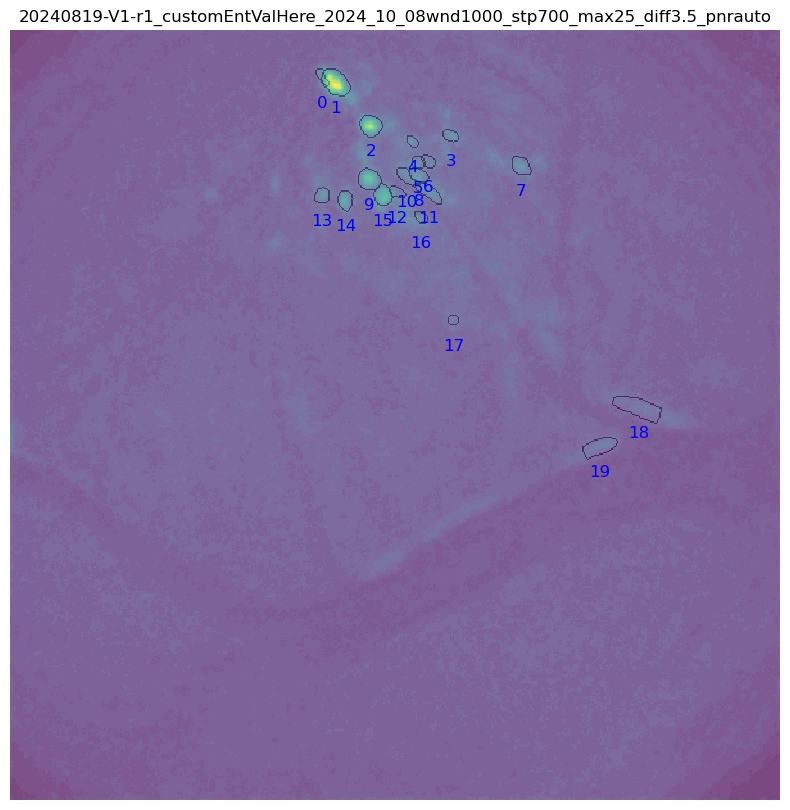

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240819-V1-r1/customEntValHere/2024_10_08/20_00_58/My_V4_Miniscope/minian_dataset_wnd1000_stp700_max25_diff3.5_pnr1.1.nc


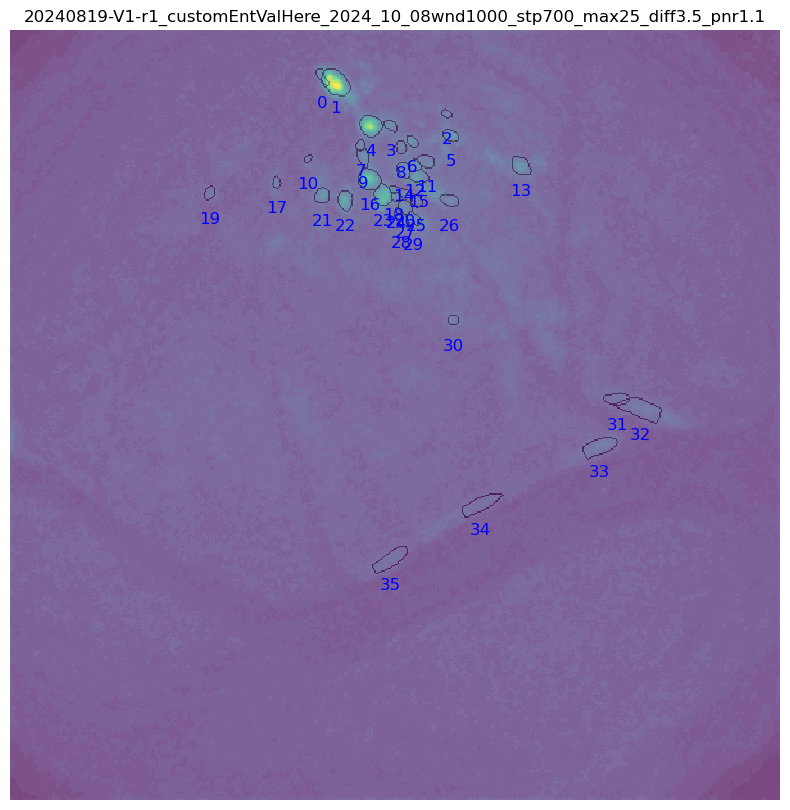

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240819-V1-r1/customEntValHere/2024_10_08/20_00_58/My_V4_Miniscope/minian_dataset_wnd1500_stp700_max25_diff5.0_pnrauto.nc


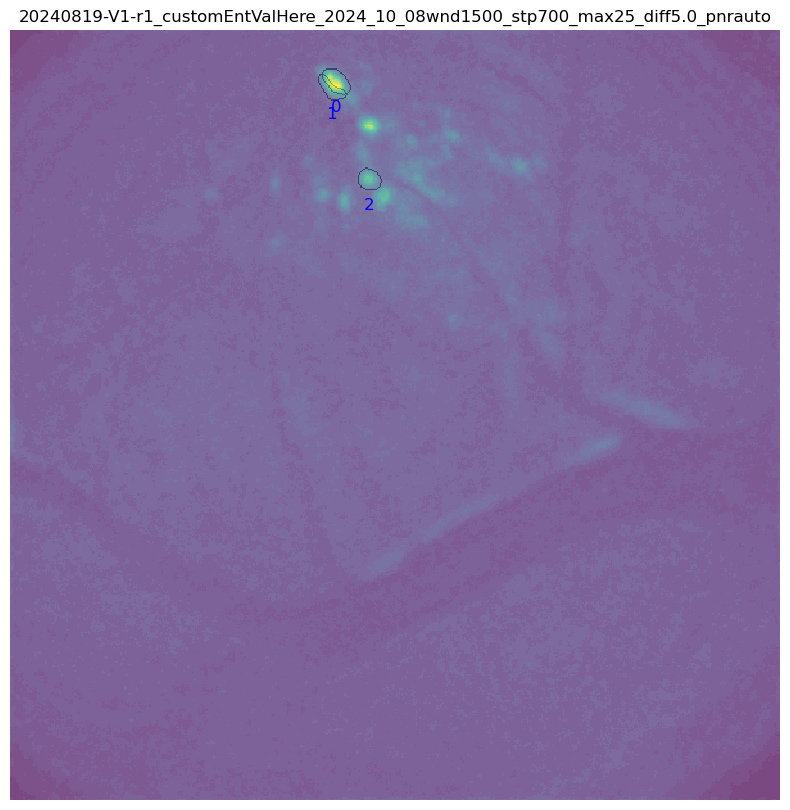

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240819-V1-r1/customEntValHere/2024_10_08/20_00_58/My_V4_Miniscope/minian_dataset_wnd700_stp700_max25_diff5.0_pnr1.1.nc


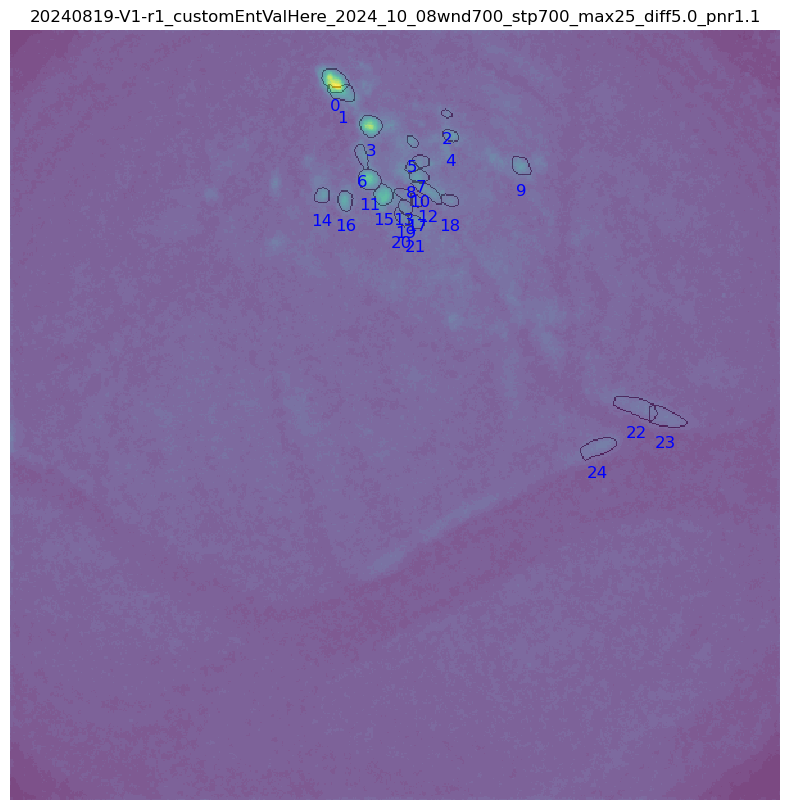

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240819-V1-r1/customEntValHere/2024_10_08/20_00_58/My_V4_Miniscope/minian_dataset_wnd1500_stp700_max25_diff4.0_pnr1.1.nc


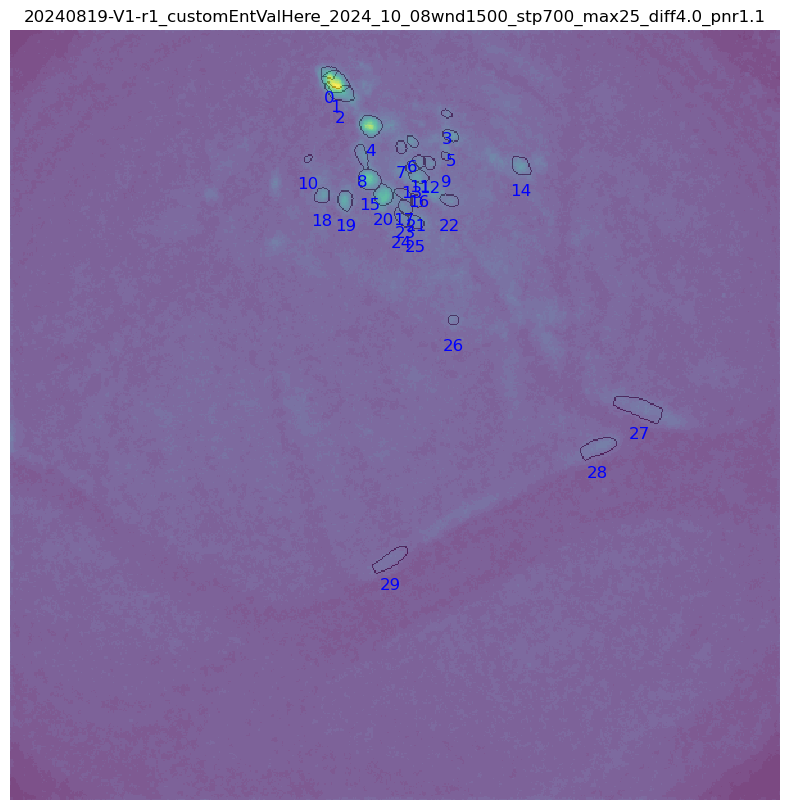

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240819-V1-r1/customEntValHere/2024_10_08/20_00_58/My_V4_Miniscope/minian_dataset_wnd700_stp700_max25_diff3.5_pnr1.1.nc


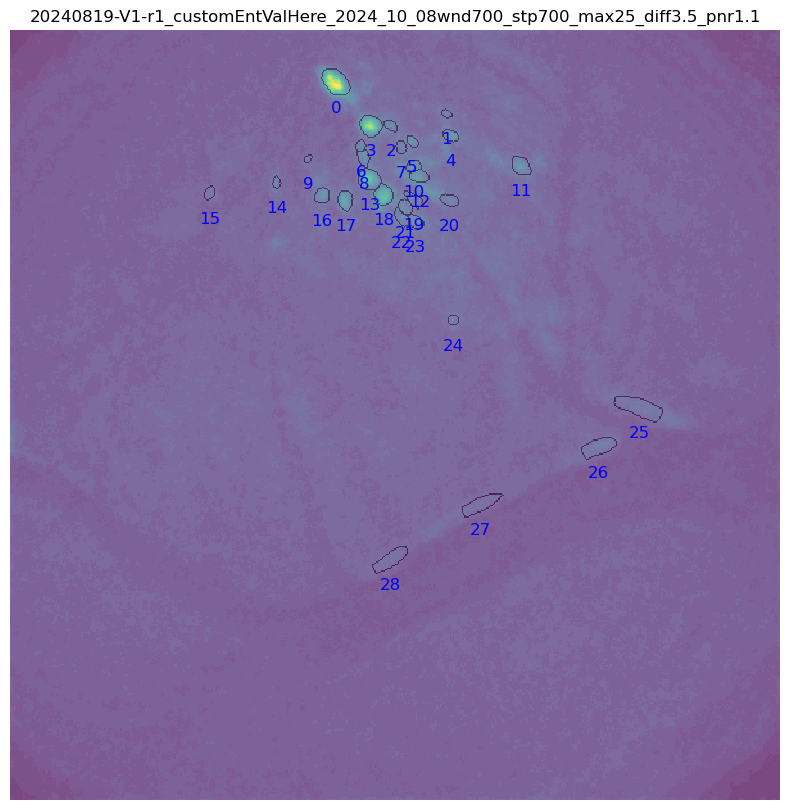

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240819-V1-r1/customEntValHere/2024_10_08/20_00_58/My_V4_Miniscope/minian_dataset_wnd1500_stp700_max25_diff3.5_pnr1.1.nc


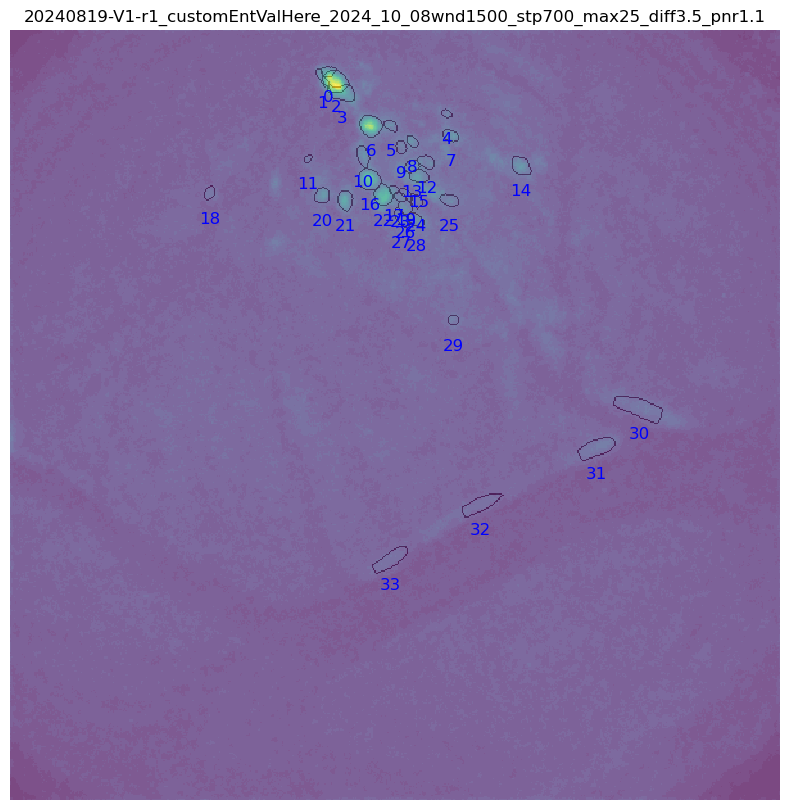

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240819-V1-r1/customEntValHere/2024_10_08/20_00_58/My_V4_Miniscope/minian_dataset_wnd1000_stp700_max25_diff4.0_pnr1.1.nc


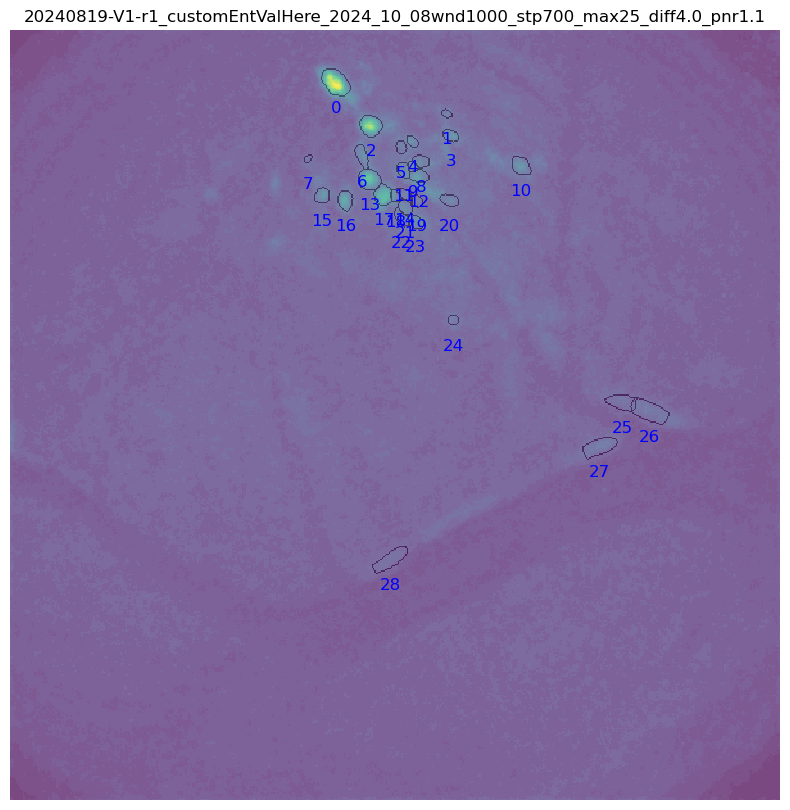

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240819-V1-r1/customEntValHere/2024_10_08/20_00_58/My_V4_Miniscope/minian_dataset_wnd1500_stp700_max25_diff5.0_pnr1.1.nc


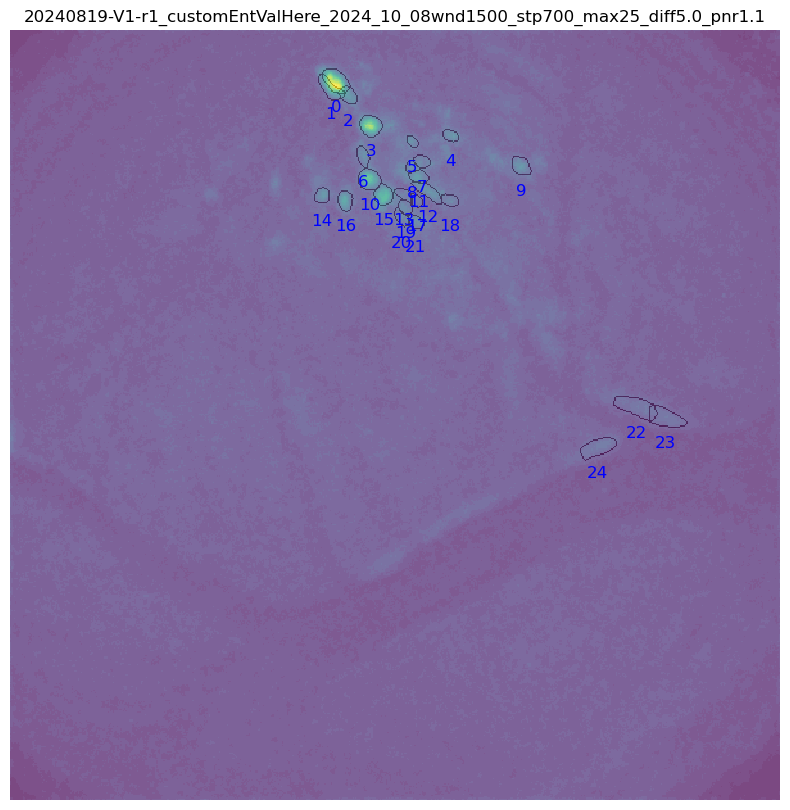

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240819-V1-r1/customEntValHere/2024_10_08/20_00_58/My_V4_Miniscope/minian_dataset_wnd700_stp700_max25_diff3.5_pnrauto.nc


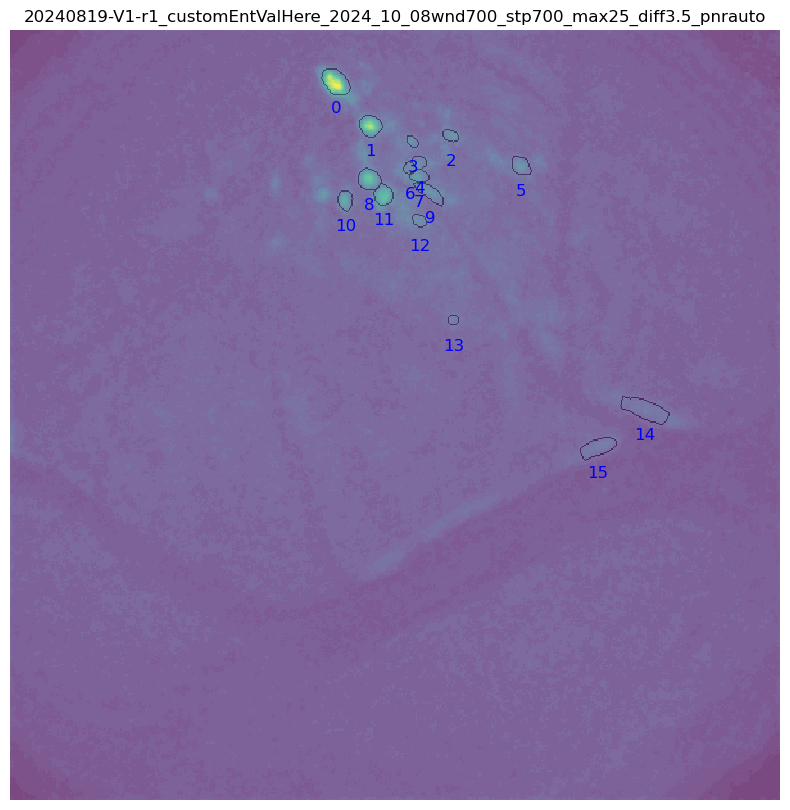

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240819-V1-r1/customEntValHere/2024_10_08/20_00_58/My_V4_Miniscope/minian_dataset_wnd700_stp700_max25_diff4.0_pnr1.1.nc


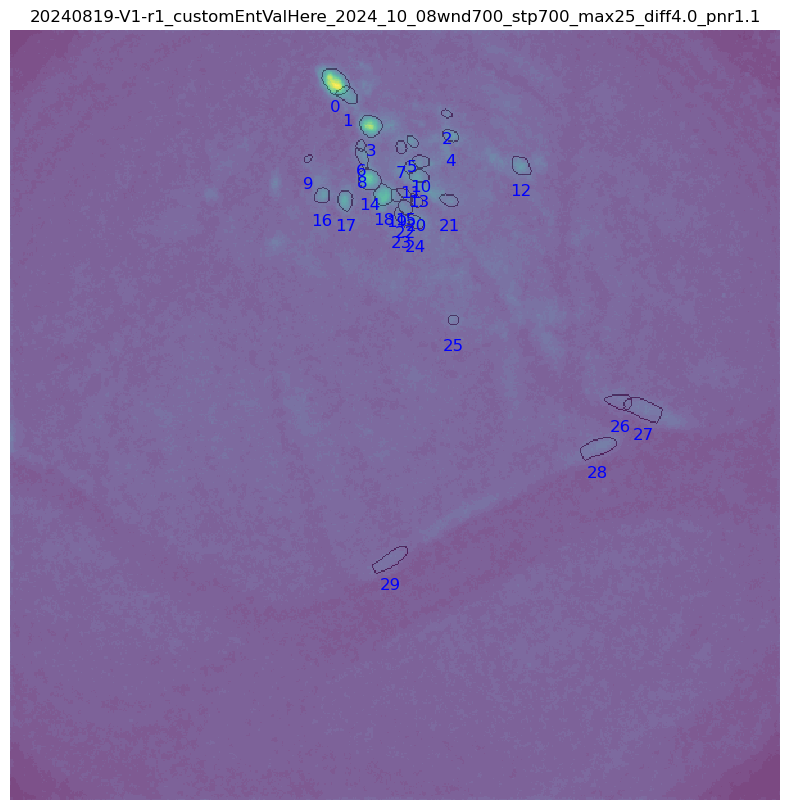

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240819-V1-r1/customEntValHere/2024_10_08/20_00_58/My_V4_Miniscope/minian_dataset_wnd1000_stp700_max25_diff5.0_pnr1.1.nc


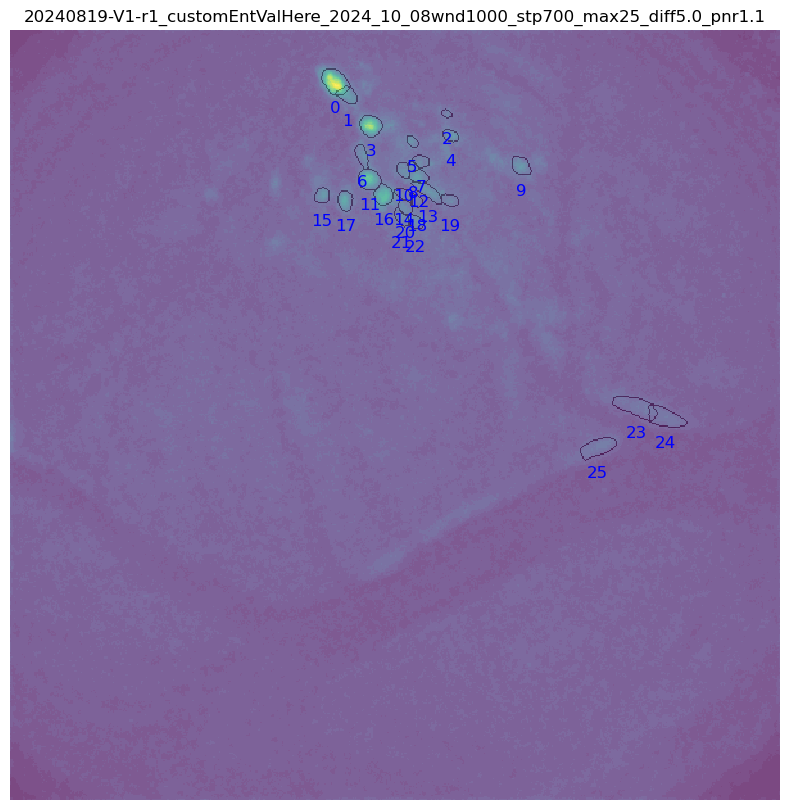


=== Running vis_param_opti for session ===
Animal:       20240819-V1-r1
Session dir:  /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240819-V1-r1/customEntValHere/2024_10_08/20_32_38/My_V4_Miniscope
Found 7 output files:
/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240819-V1-r1/customEntValHere/2024_10_08/20_32_38/My_V4_Miniscope/minian_dataset_wnd1000_stp700_max25_diff3.5_pnr1.1.nc
/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240819-V1-r1/customEntValHere/2024_10_08/20_32_38/My_V4_Miniscope/minian_dataset_wnd1500_stp700_max25_diff4.0_pnr1.1.nc
/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240819-V1-r1/customEntValHere/2024_10_08/20_32_38/My_V4_Miniscope/minian_dataset_wnd1500_stp700_max25_diff3.5_pnr1.1.nc
/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240819-V1-r1/customEntValHere/2024_10_08/20_32_38/My_V4_Miniscope/minian_dataset_wnd1000_stp700_max25_diff4.0_pnr1.1.nc
/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240819-V1-r1/customEntValHere/2024_10_08/20_32_38/My_V4_M

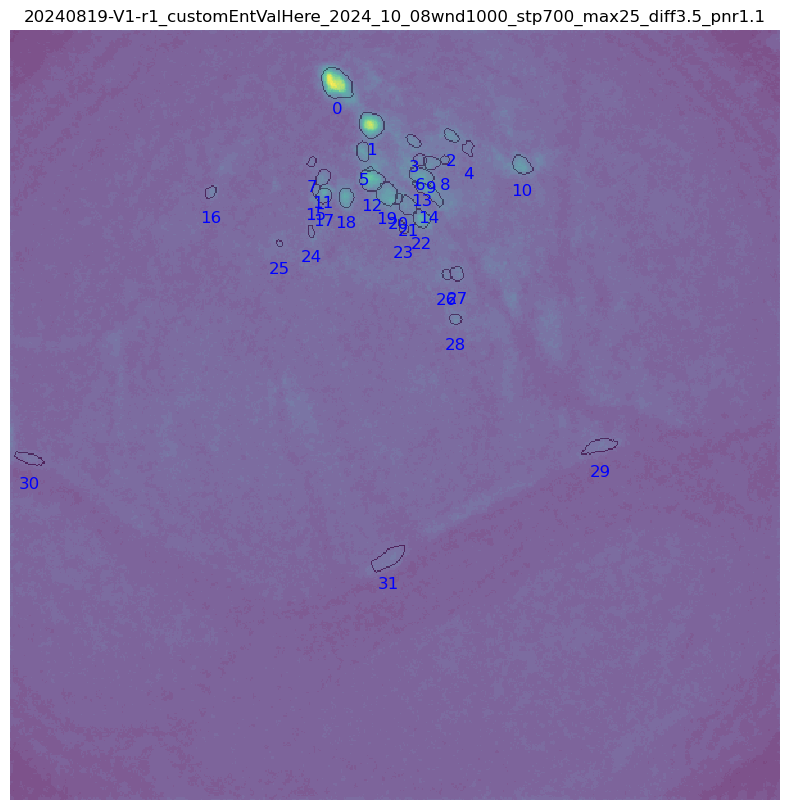

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240819-V1-r1/customEntValHere/2024_10_08/20_32_38/My_V4_Miniscope/minian_dataset_wnd1500_stp700_max25_diff4.0_pnr1.1.nc


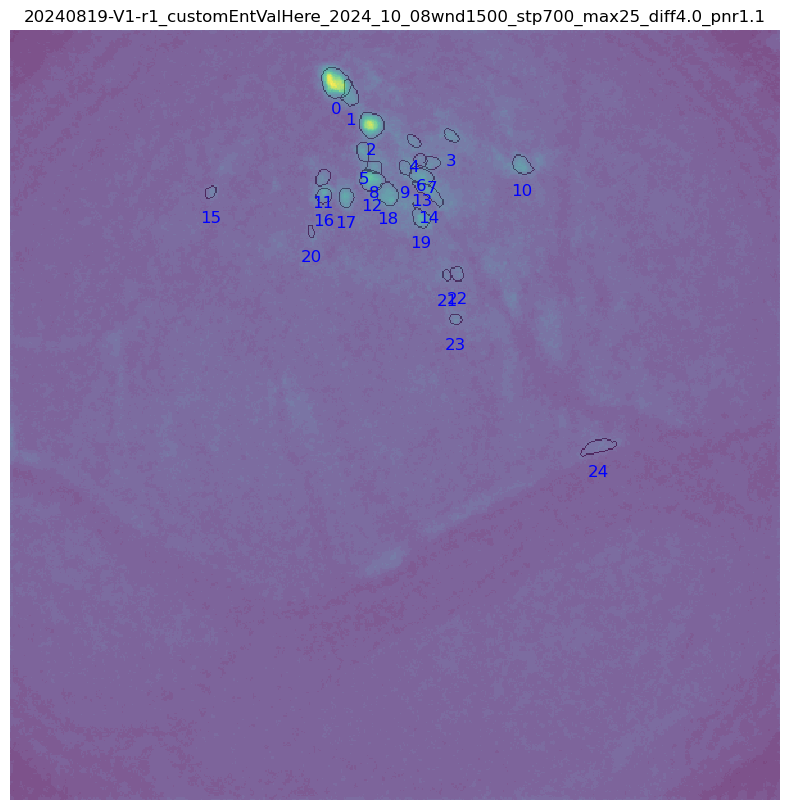

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240819-V1-r1/customEntValHere/2024_10_08/20_32_38/My_V4_Miniscope/minian_dataset_wnd1500_stp700_max25_diff3.5_pnr1.1.nc


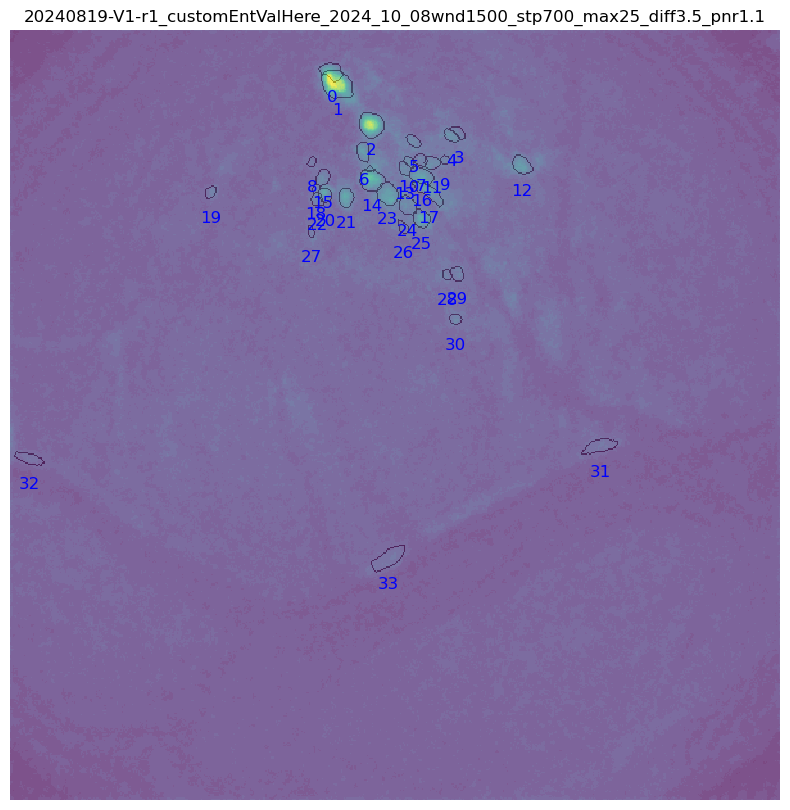

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240819-V1-r1/customEntValHere/2024_10_08/20_32_38/My_V4_Miniscope/minian_dataset_wnd1000_stp700_max25_diff4.0_pnr1.1.nc


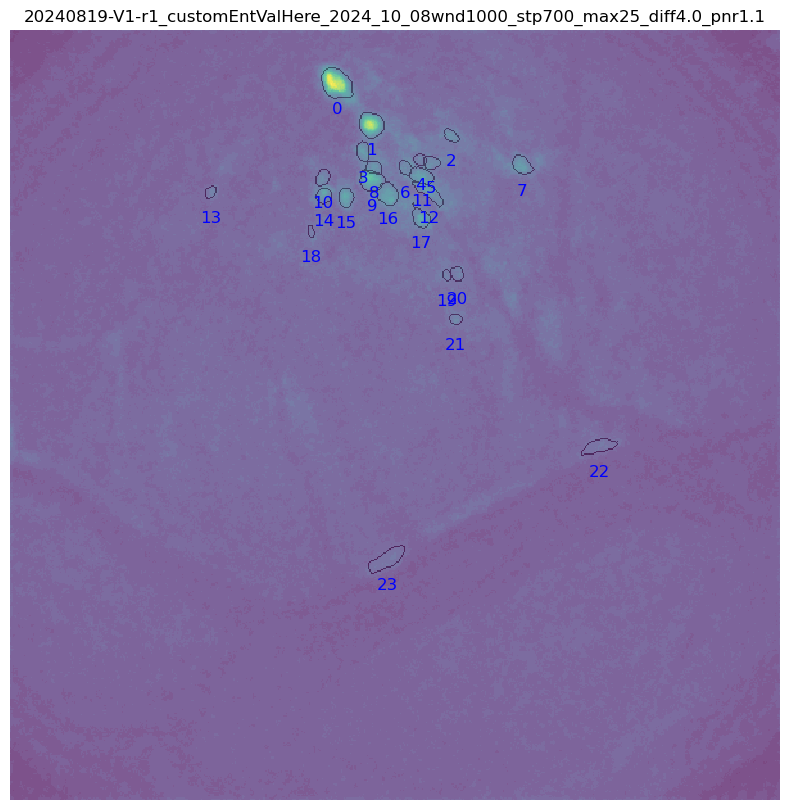

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240819-V1-r1/customEntValHere/2024_10_08/20_32_38/My_V4_Miniscope/minian_dataset_wnd1500_stp700_max25_diff5.0_pnr1.1.nc


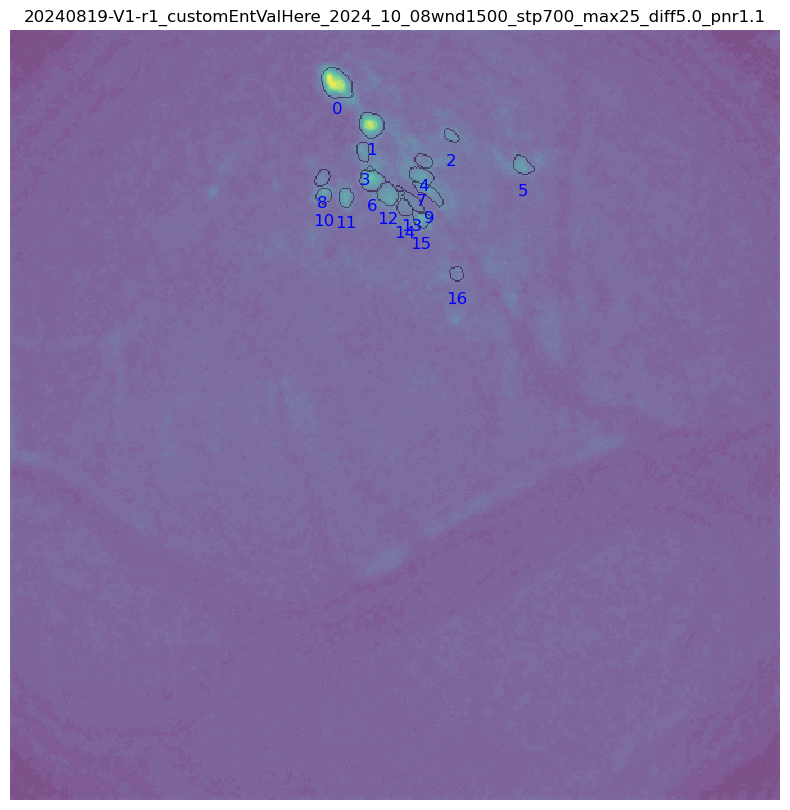

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240819-V1-r1/customEntValHere/2024_10_08/20_32_38/My_V4_Miniscope/minian_dataset_wnd700_stp700_max25_diff3.5_pnrauto.nc


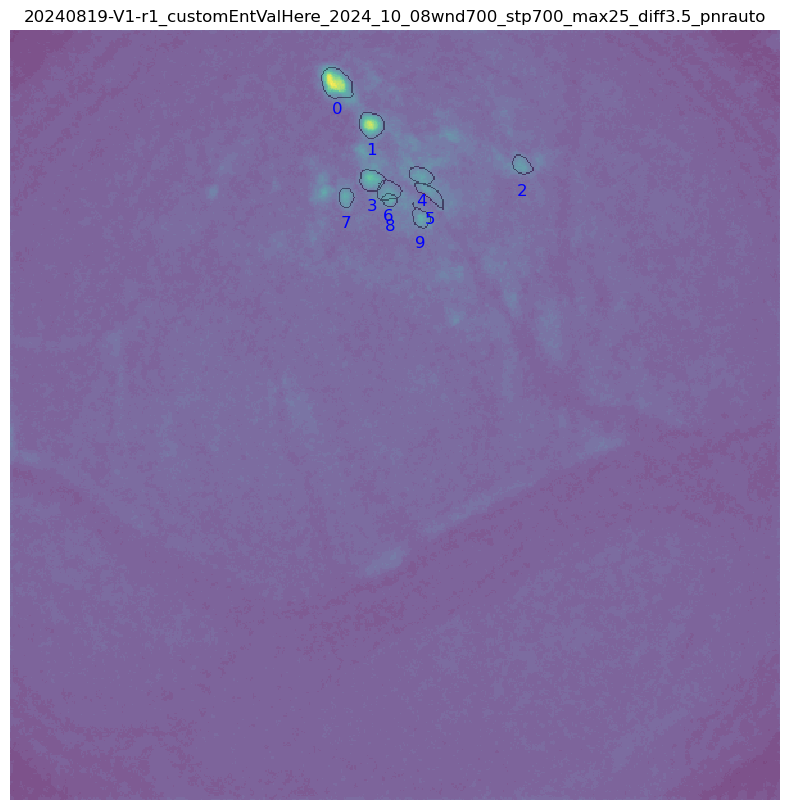

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240819-V1-r1/customEntValHere/2024_10_08/20_32_38/My_V4_Miniscope/minian_dataset_wnd700_stp700_max25_diff4.0_pnr1.1.nc


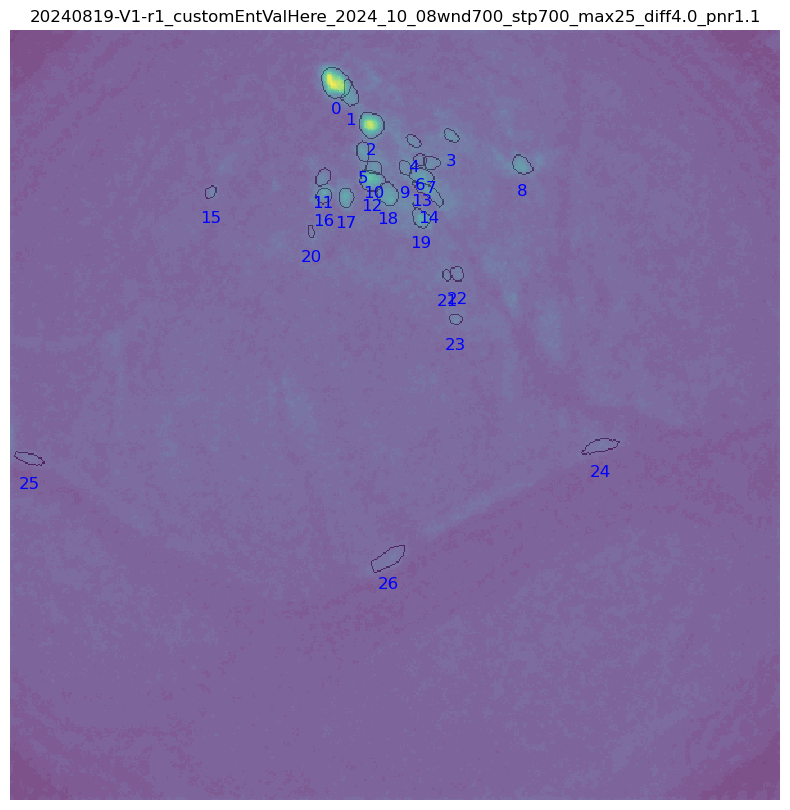


=== Running vis_param_opti for session ===
Animal:       20240819-V1-r1
Session dir:  /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240819-V1-r1/customEntValHere/2024_10_17/14_25_32/My_V4_Miniscope
Found 9 output files:
/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240819-V1-r1/customEntValHere/2024_10_17/14_25_32/My_V4_Miniscope/minian_dataset_wnd1000_stp700_max25_diff3.5_pnr1.1.nc
/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240819-V1-r1/customEntValHere/2024_10_17/14_25_32/My_V4_Miniscope/minian_dataset_wnd700_stp700_max25_diff5.0_pnr1.1.nc
/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240819-V1-r1/customEntValHere/2024_10_17/14_25_32/My_V4_Miniscope/minian_dataset_wnd1500_stp700_max25_diff4.0_pnr1.1.nc
/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240819-V1-r1/customEntValHere/2024_10_17/14_25_32/My_V4_Miniscope/minian_dataset_wnd700_stp700_max25_diff3.5_pnr1.1.nc
/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240819-V1-r1/customEntValHere/2024_10_17/14_25_32/My_V4_Min

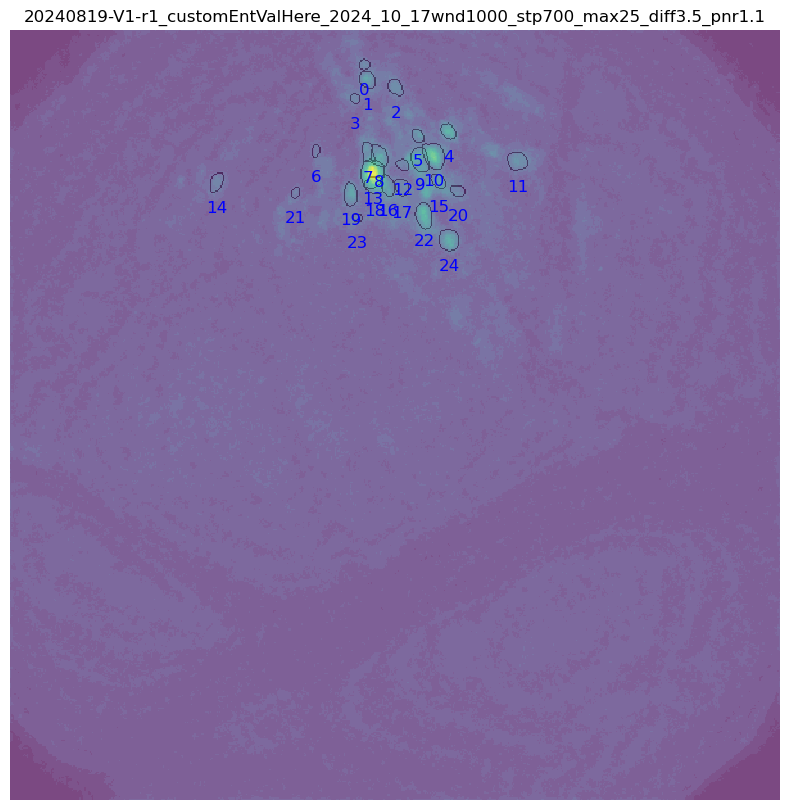

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240819-V1-r1/customEntValHere/2024_10_17/14_25_32/My_V4_Miniscope/minian_dataset_wnd700_stp700_max25_diff5.0_pnr1.1.nc


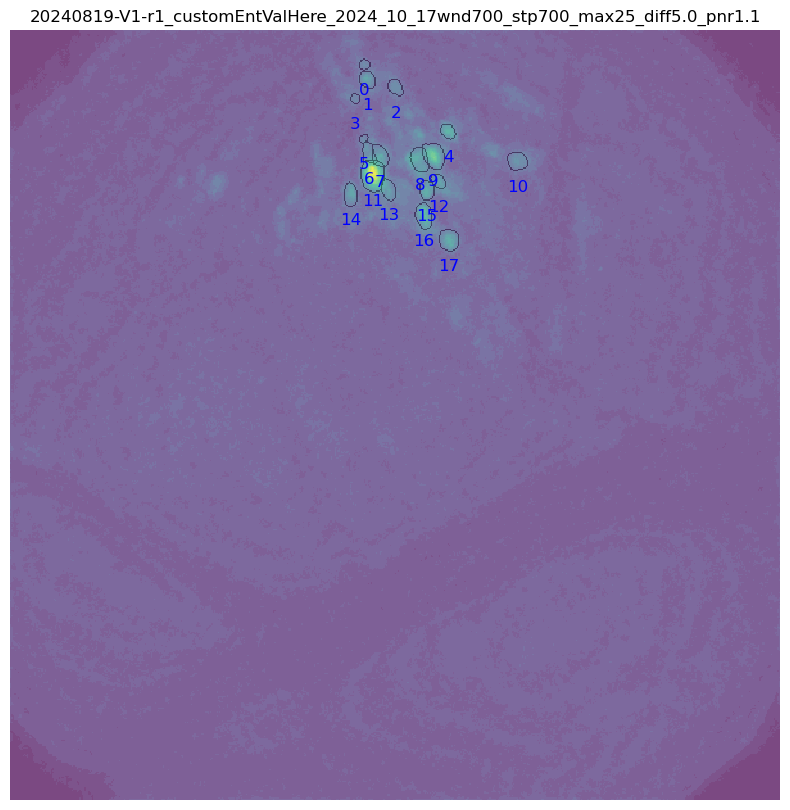

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240819-V1-r1/customEntValHere/2024_10_17/14_25_32/My_V4_Miniscope/minian_dataset_wnd1500_stp700_max25_diff4.0_pnr1.1.nc


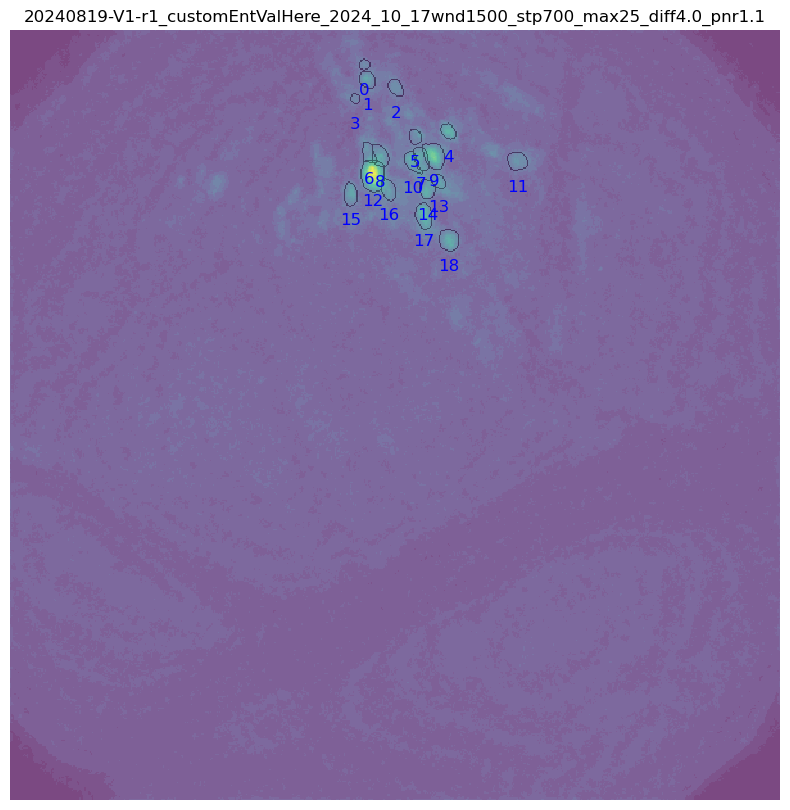

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240819-V1-r1/customEntValHere/2024_10_17/14_25_32/My_V4_Miniscope/minian_dataset_wnd700_stp700_max25_diff3.5_pnr1.1.nc


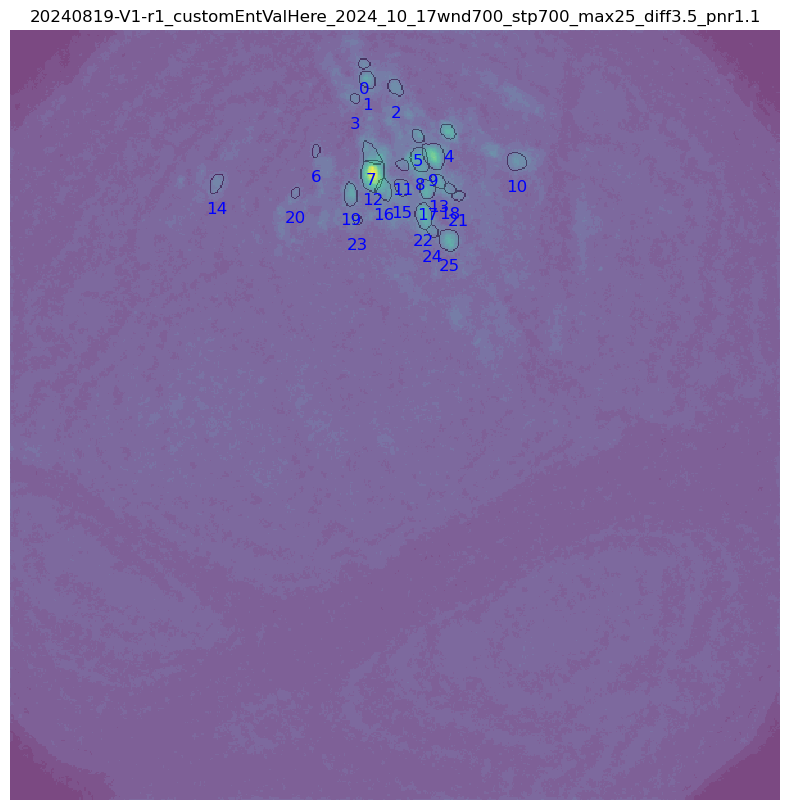

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240819-V1-r1/customEntValHere/2024_10_17/14_25_32/My_V4_Miniscope/minian_dataset_wnd1500_stp700_max25_diff3.5_pnr1.1.nc


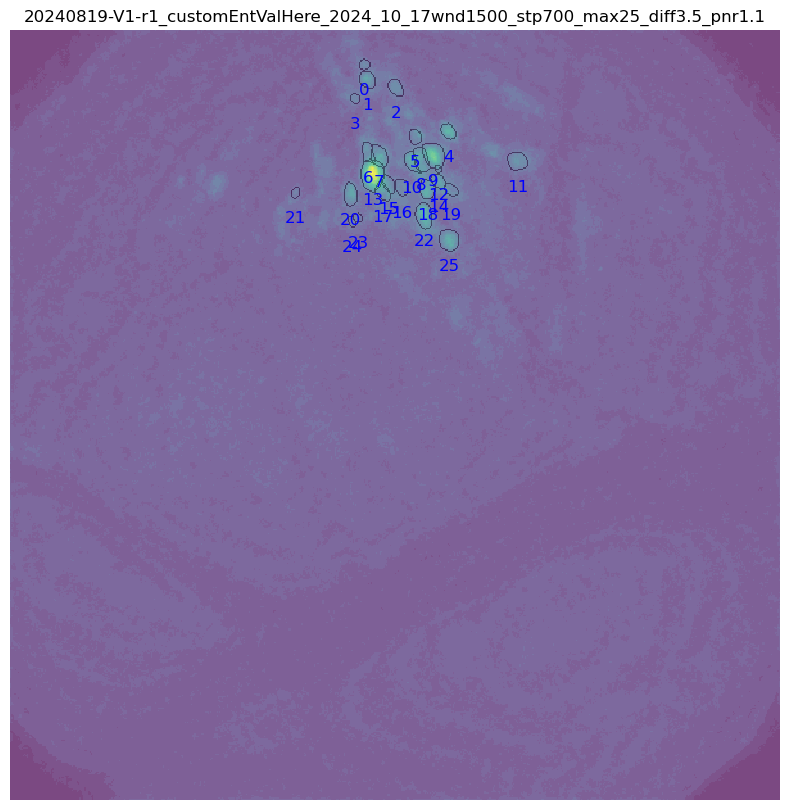

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240819-V1-r1/customEntValHere/2024_10_17/14_25_32/My_V4_Miniscope/minian_dataset_wnd1000_stp700_max25_diff4.0_pnr1.1.nc


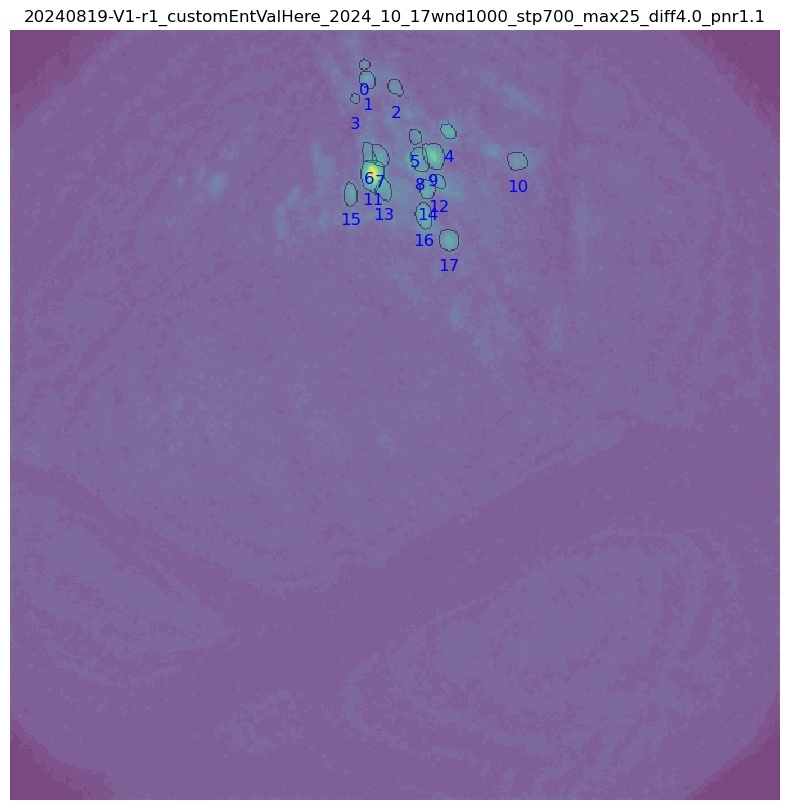

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240819-V1-r1/customEntValHere/2024_10_17/14_25_32/My_V4_Miniscope/minian_dataset_wnd1500_stp700_max25_diff5.0_pnr1.1.nc


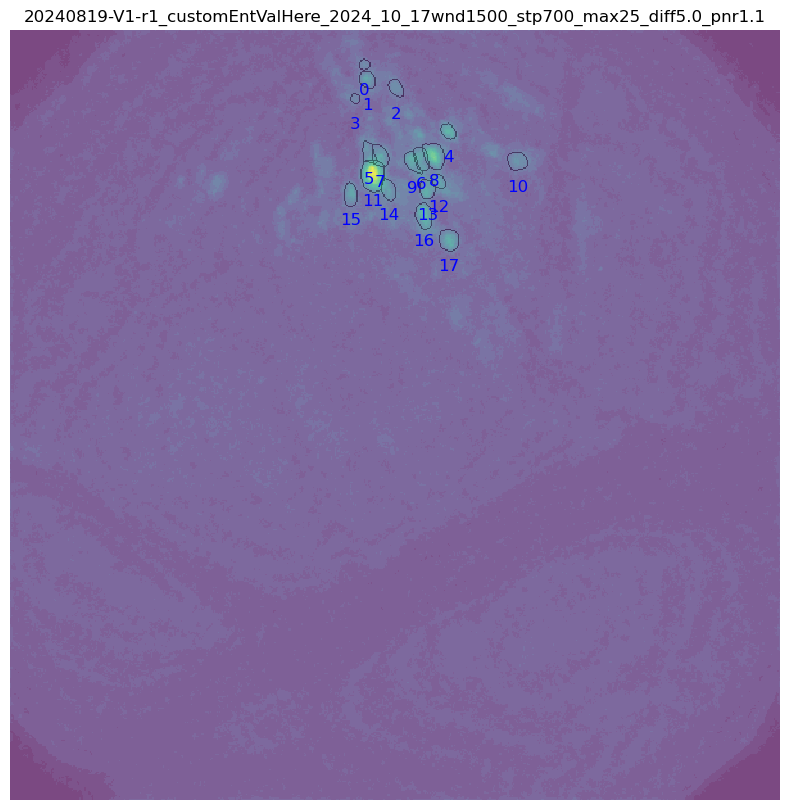

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240819-V1-r1/customEntValHere/2024_10_17/14_25_32/My_V4_Miniscope/minian_dataset_wnd700_stp700_max25_diff4.0_pnr1.1.nc


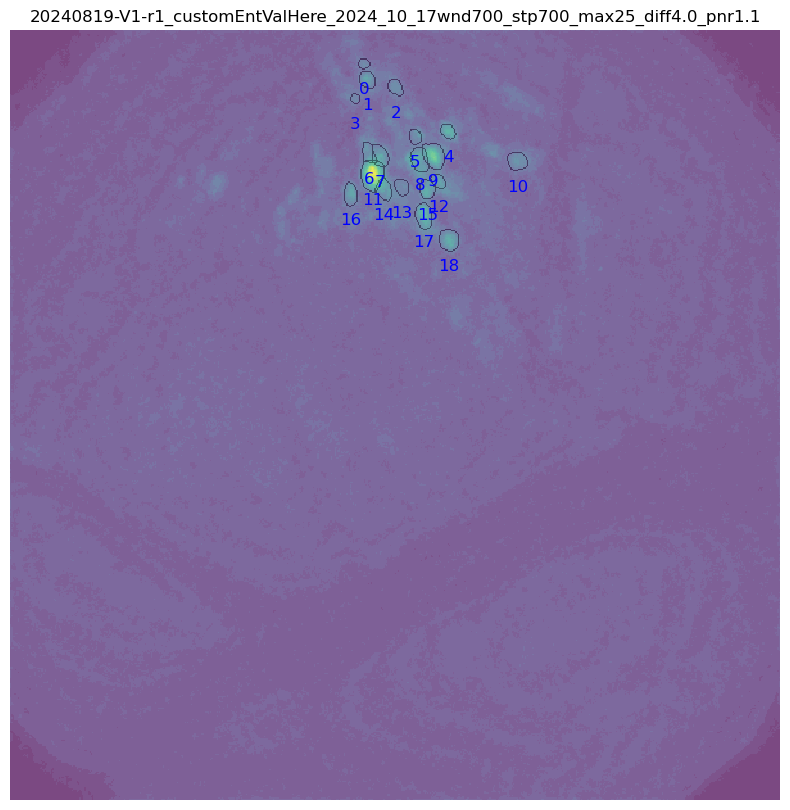

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240819-V1-r1/customEntValHere/2024_10_17/14_25_32/My_V4_Miniscope/minian_dataset_wnd1000_stp700_max25_diff5.0_pnr1.1.nc


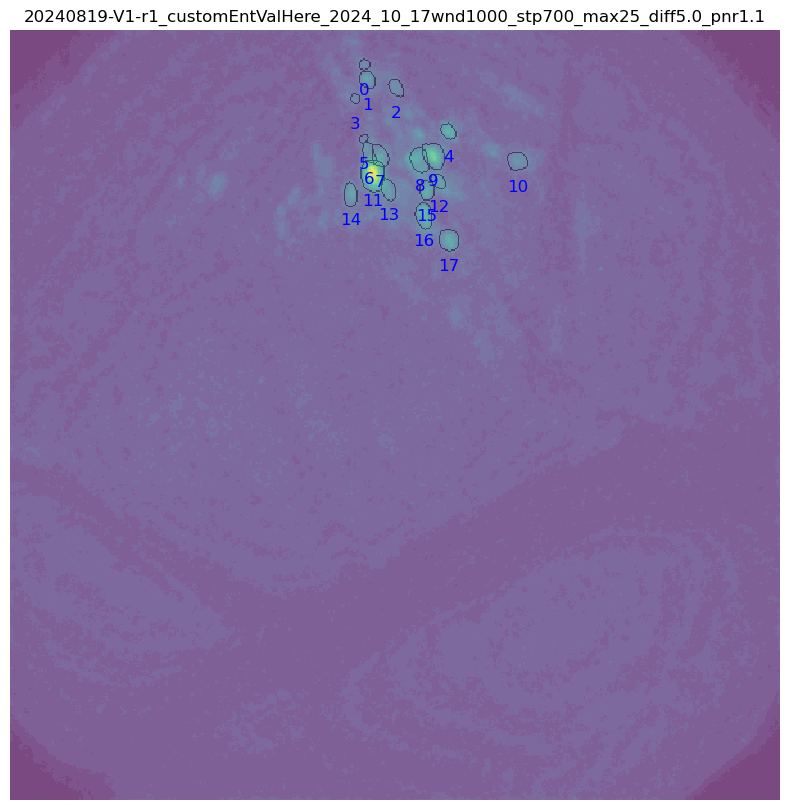


=== Running vis_param_opti for session ===
Animal:       20240910-V1-R
Session dir:  /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240910-V1-R/customEntValHere/2024_11_01/11_39_00/My_V4_Miniscope
Found 1 output files:
/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240910-V1-R/customEntValHere/2024_11_01/11_39_00/My_V4_Miniscope/minian_dataset_241010_denoised.nc
Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240910-V1-R/customEntValHere/2024_11_01/11_39_00/My_V4_Miniscope/minian_dataset_241010_denoised.nc


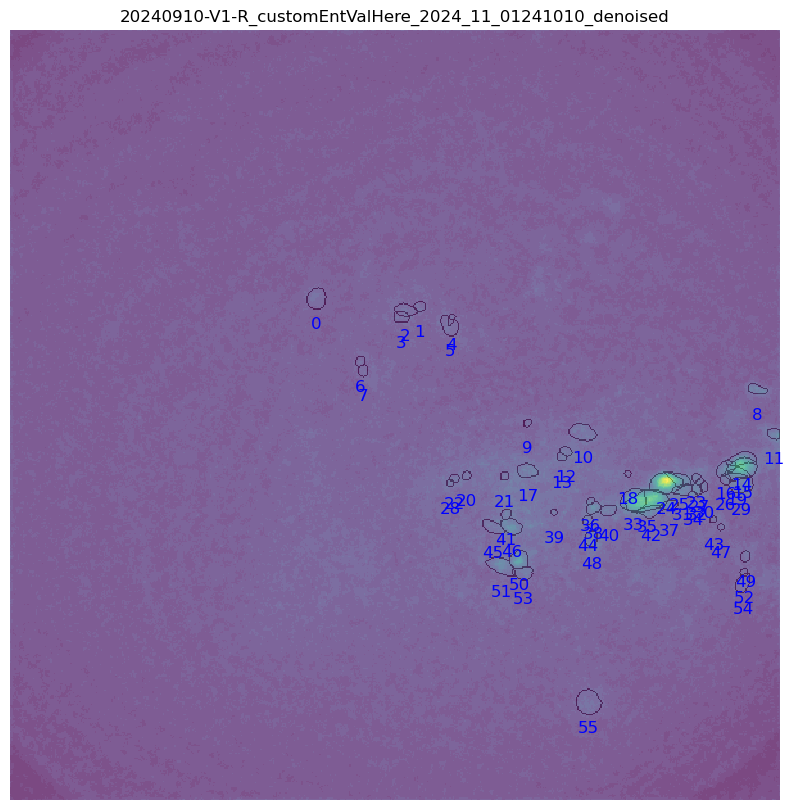


=== Running vis_param_opti for session ===
Animal:       20240919-V1-R1
Session dir:  /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240919-V1-R1/customEntValHere/2024_12_18/11_22_07/My_V4_Miniscope
Found 8 output files:
/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240919-V1-R1/customEntValHere/2024_12_18/11_22_07/My_V4_Miniscope/minian_dataset_wnd1000_stp700_max25_diff3.5_pnrauto.nc
/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240919-V1-R1/customEntValHere/2024_12_18/11_22_07/My_V4_Miniscope/minian_dataset_wnd1000_stp700_max25_diff3.5_pnr1.1.nc
/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240919-V1-R1/customEntValHere/2024_12_18/11_22_07/My_V4_Miniscope/minian_dataset_wnd700_stp700_max25_diff5.0_pnr1.1.nc
/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240919-V1-R1/customEntValHere/2024_12_18/11_22_07/My_V4_Miniscope/minian_dataset_wnd700_stp700_max25_diff4.0_pnrauto.nc
/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240919-V1-R1/customEntValHere/2024_12_18/11_22_07/My_V4_M

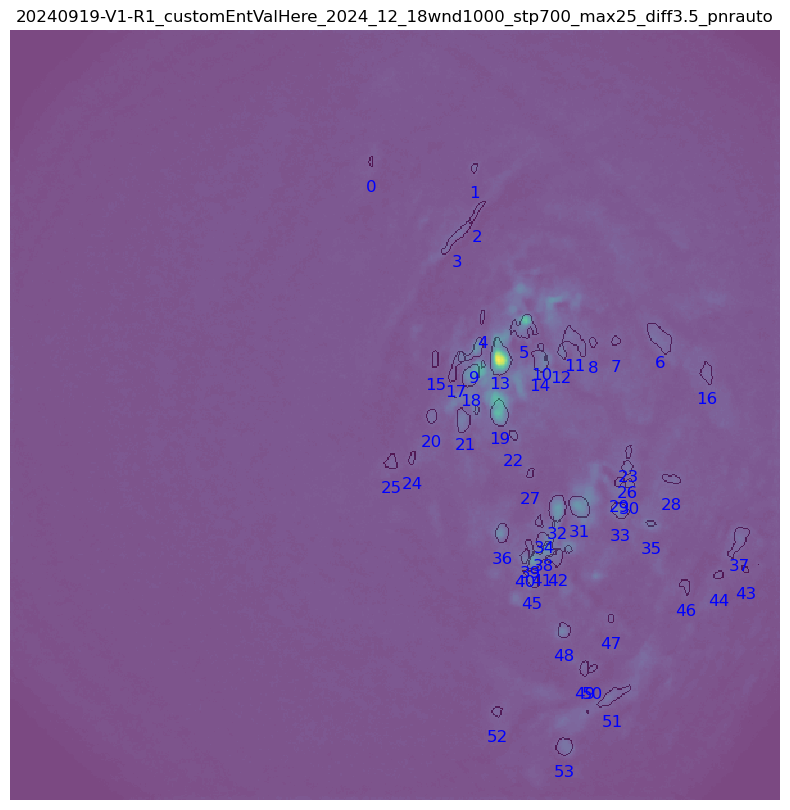

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240919-V1-R1/customEntValHere/2024_12_18/11_22_07/My_V4_Miniscope/minian_dataset_wnd1000_stp700_max25_diff3.5_pnr1.1.nc


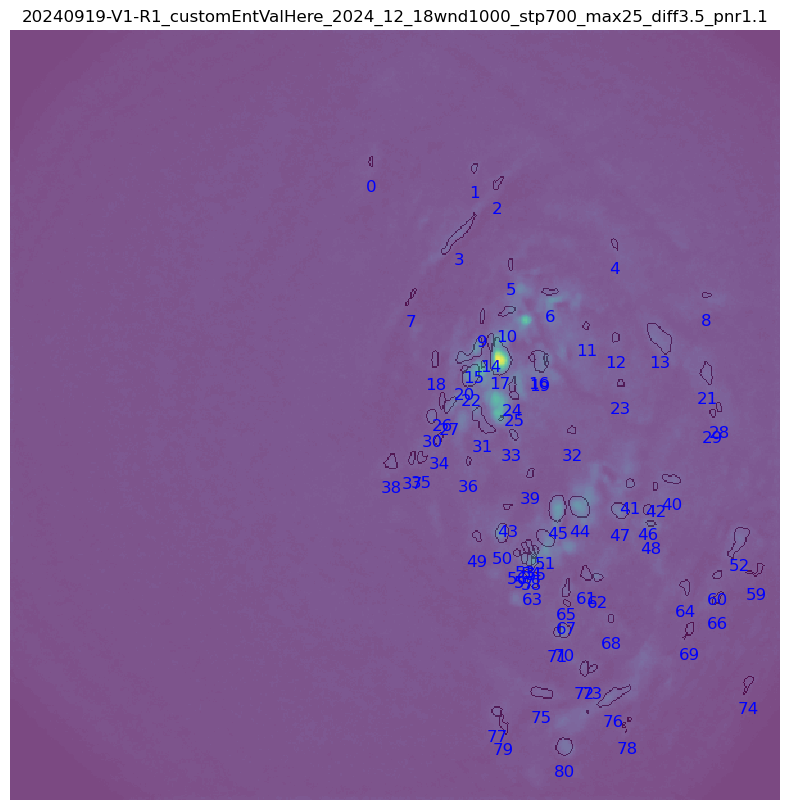

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240919-V1-R1/customEntValHere/2024_12_18/11_22_07/My_V4_Miniscope/minian_dataset_wnd700_stp700_max25_diff5.0_pnr1.1.nc


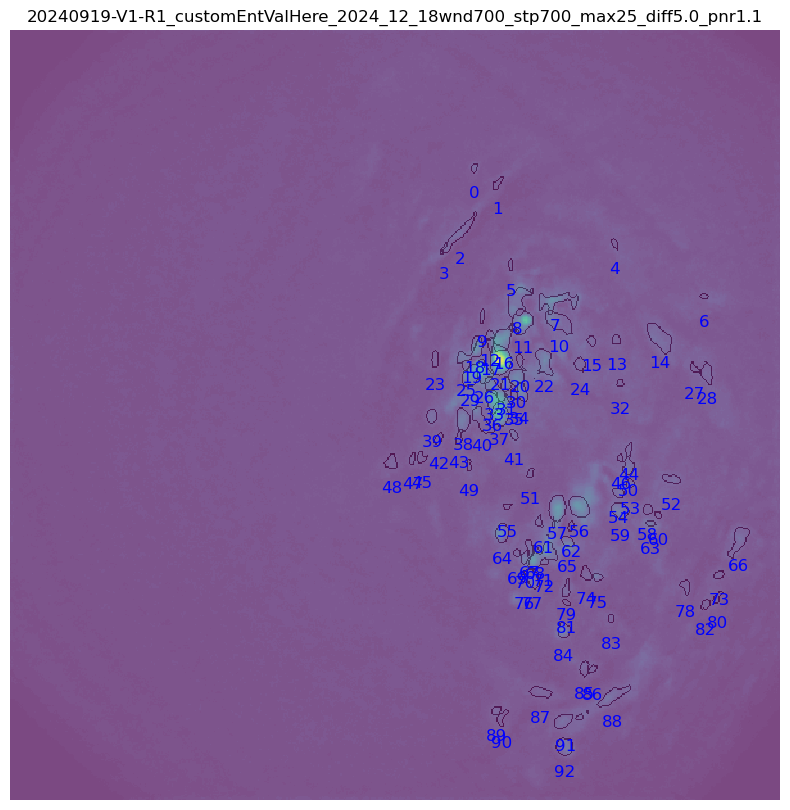

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240919-V1-R1/customEntValHere/2024_12_18/11_22_07/My_V4_Miniscope/minian_dataset_wnd700_stp700_max25_diff4.0_pnrauto.nc


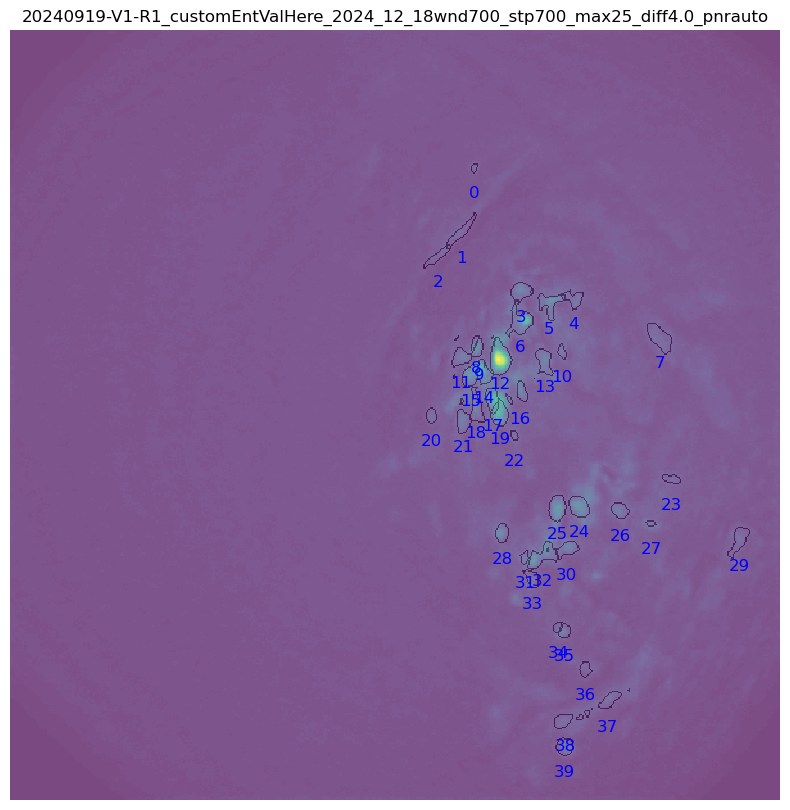

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240919-V1-R1/customEntValHere/2024_12_18/11_22_07/My_V4_Miniscope/minian_dataset_wnd700_stp700_max25_diff3.5_pnr1.1.nc


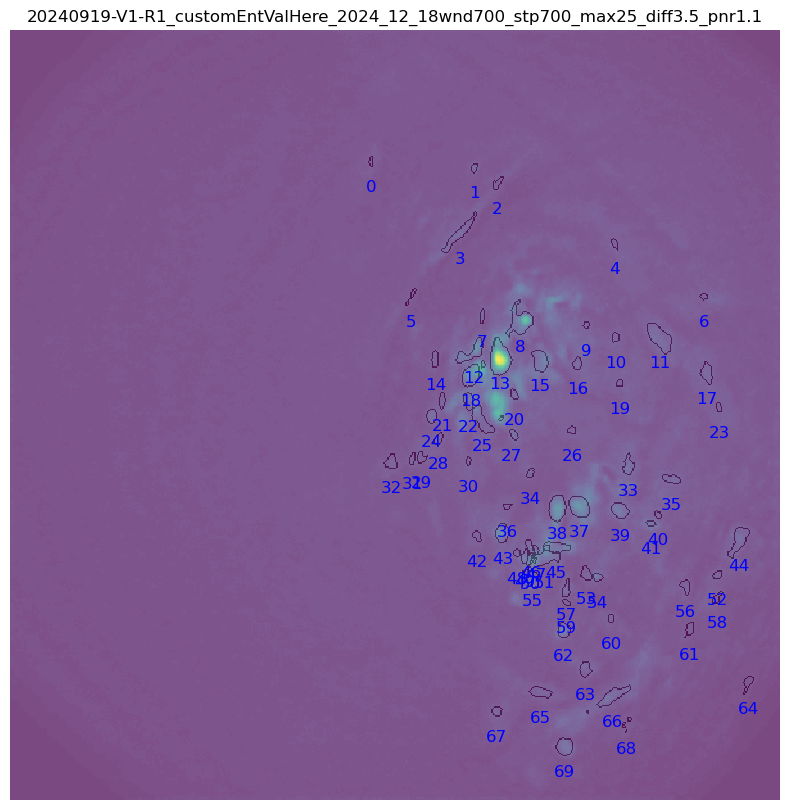

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240919-V1-R1/customEntValHere/2024_12_18/11_22_07/My_V4_Miniscope/minian_dataset_wnd700_stp700_max25_diff3.5_pnrauto.nc


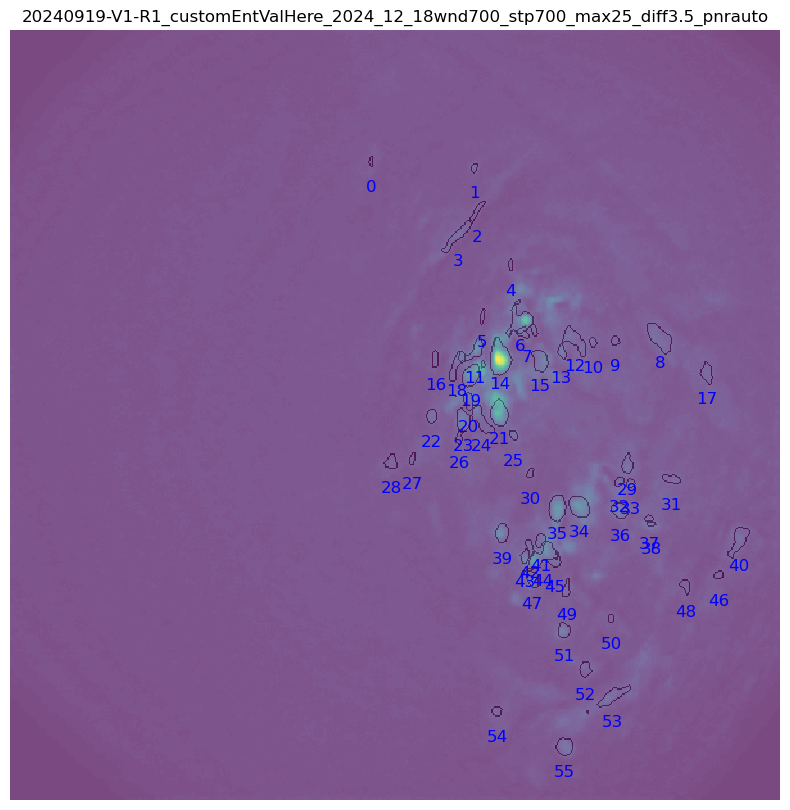

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240919-V1-R1/customEntValHere/2024_12_18/11_22_07/My_V4_Miniscope/minian_dataset_wnd700_stp700_max25_diff4.0_pnr1.1.nc


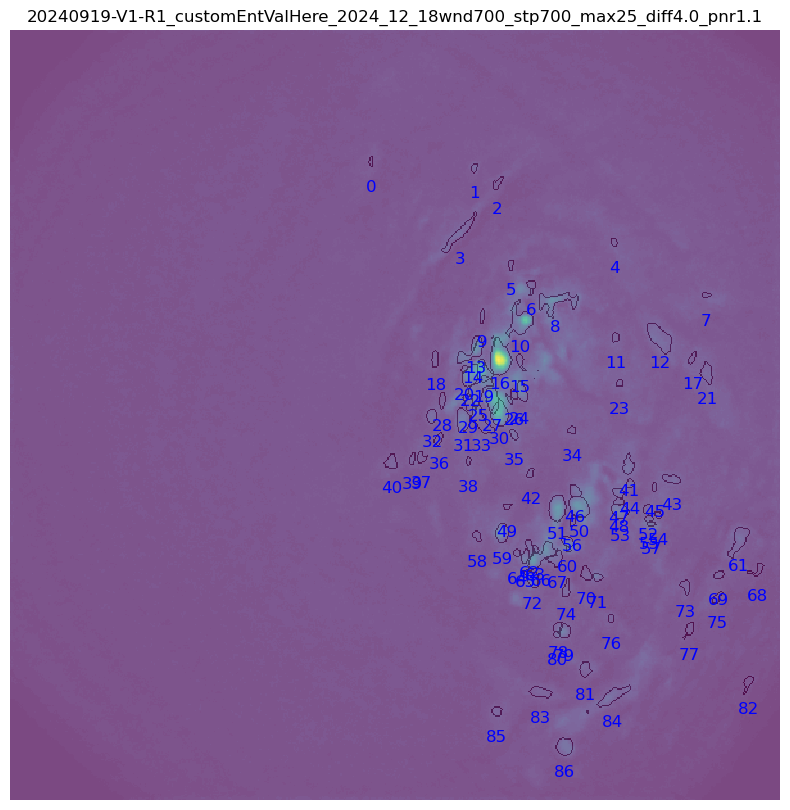

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240919-V1-R1/customEntValHere/2024_12_18/11_22_07/My_V4_Miniscope/minian_dataset_wnd700_stp700_max25_diff5.0_pnrauto.nc


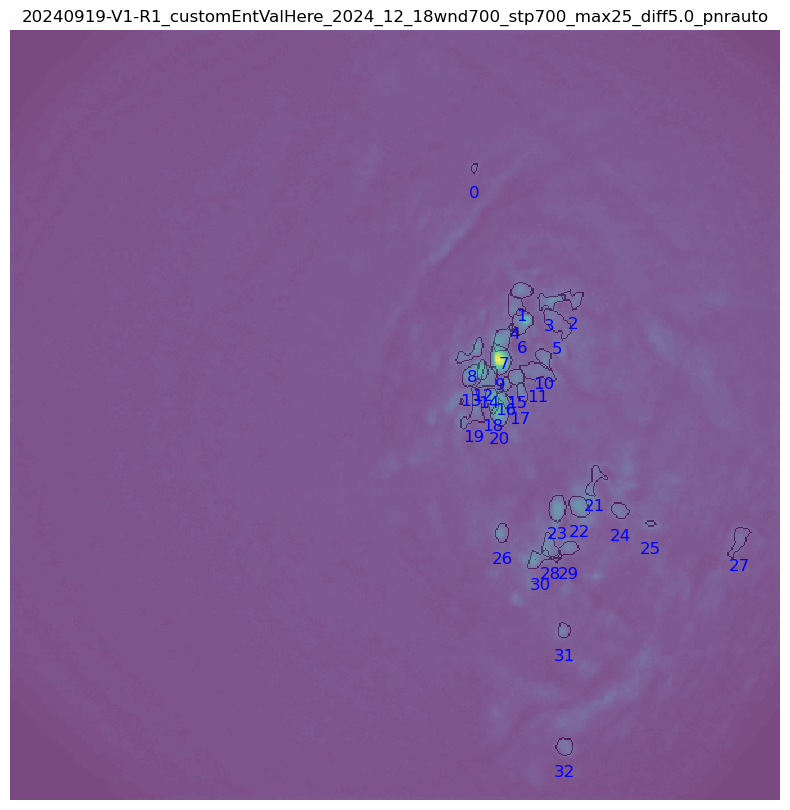


=== Running vis_param_opti for session ===
Animal:       20240919-V1-R1
Session dir:  /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240919-V1-R1/customEntValHere/2024_12_18/11_33_01/My_V4_Miniscope
Found 14 output files:
/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240919-V1-R1/customEntValHere/2024_12_18/11_33_01/My_V4_Miniscope/minian_dataset_wnd1000_stp700_max25_diff3.5_pnrauto.nc
/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240919-V1-R1/customEntValHere/2024_12_18/11_33_01/My_V4_Miniscope/minian_dataset_wnd1000_stp700_max25_diff3.5_pnr1.1.nc
/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240919-V1-R1/customEntValHere/2024_12_18/11_33_01/My_V4_Miniscope/minian_dataset_wnd700_stp700_max25_diff5.0_pnr1.1.nc
/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240919-V1-R1/customEntValHere/2024_12_18/11_33_01/My_V4_Miniscope/minian_dataset_wnd700_stp700_max25_diff4.0_pnrauto.nc
/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240919-V1-R1/customEntValHere/2024_12_18/11_33_01/My_V4_

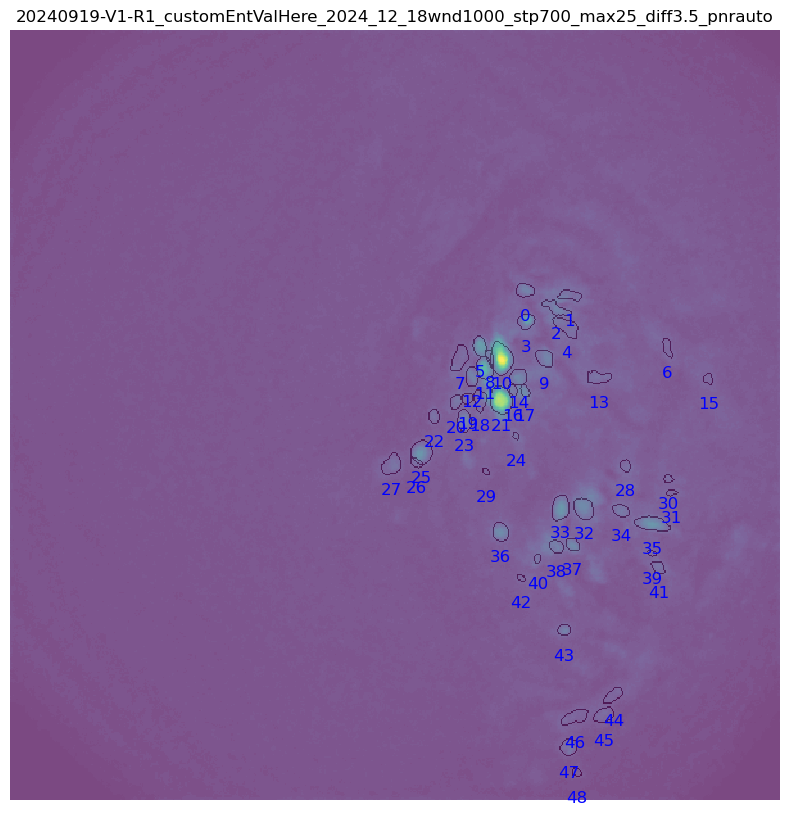

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240919-V1-R1/customEntValHere/2024_12_18/11_33_01/My_V4_Miniscope/minian_dataset_wnd1000_stp700_max25_diff3.5_pnr1.1.nc


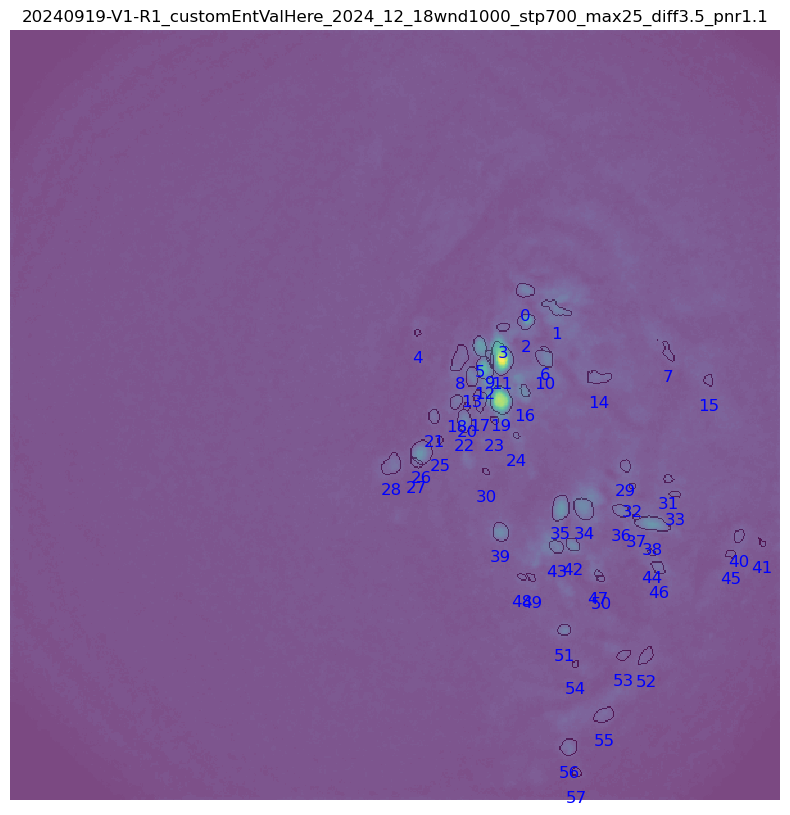

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240919-V1-R1/customEntValHere/2024_12_18/11_33_01/My_V4_Miniscope/minian_dataset_wnd700_stp700_max25_diff5.0_pnr1.1.nc


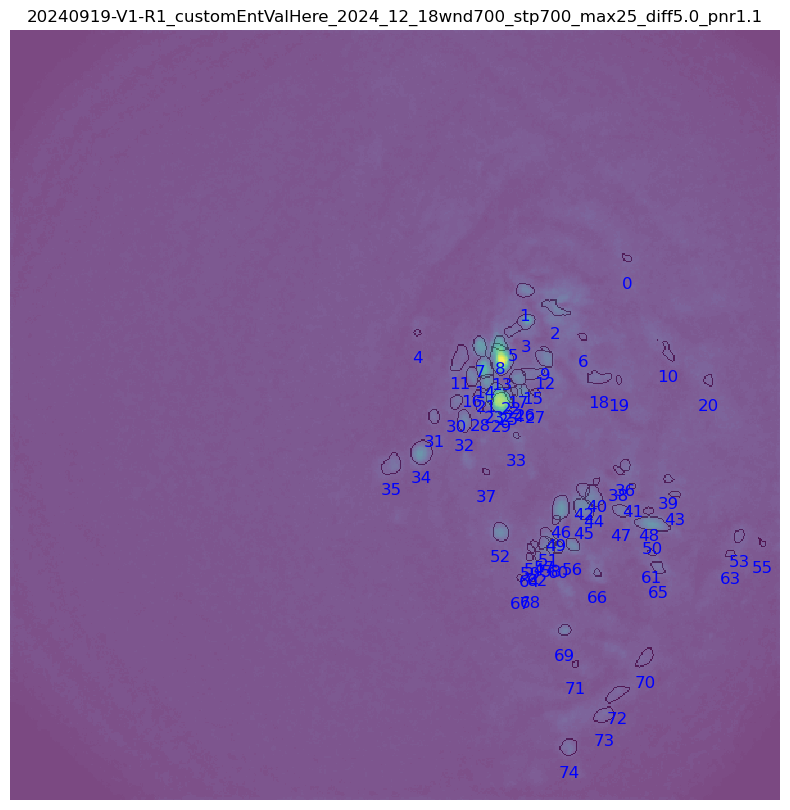

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240919-V1-R1/customEntValHere/2024_12_18/11_33_01/My_V4_Miniscope/minian_dataset_wnd700_stp700_max25_diff4.0_pnrauto.nc


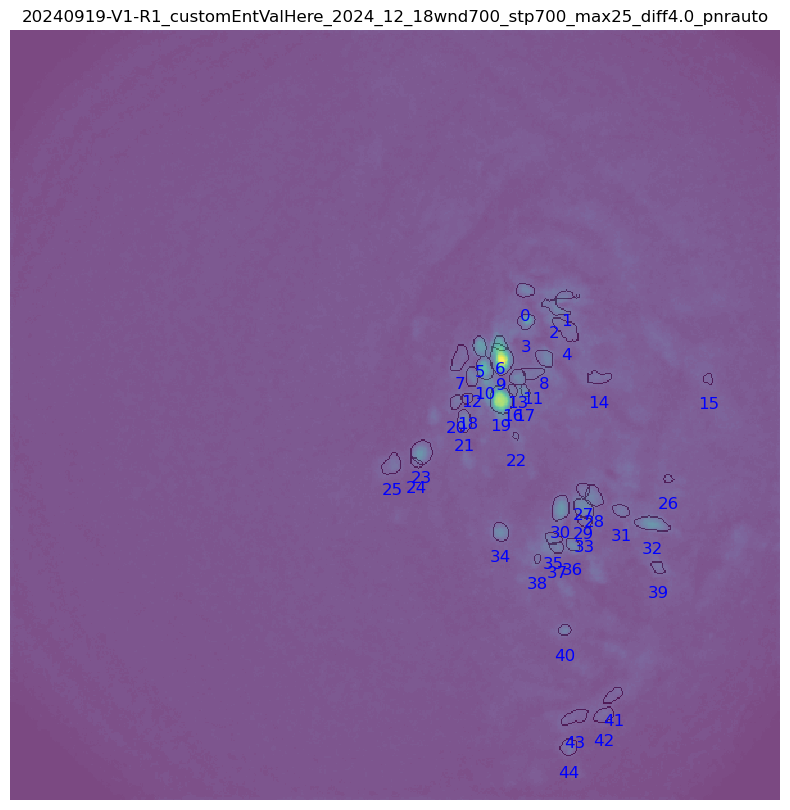

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240919-V1-R1/customEntValHere/2024_12_18/11_33_01/My_V4_Miniscope/minian_dataset_wnd1000_stp700_max25_diff5.0_pnrauto.nc


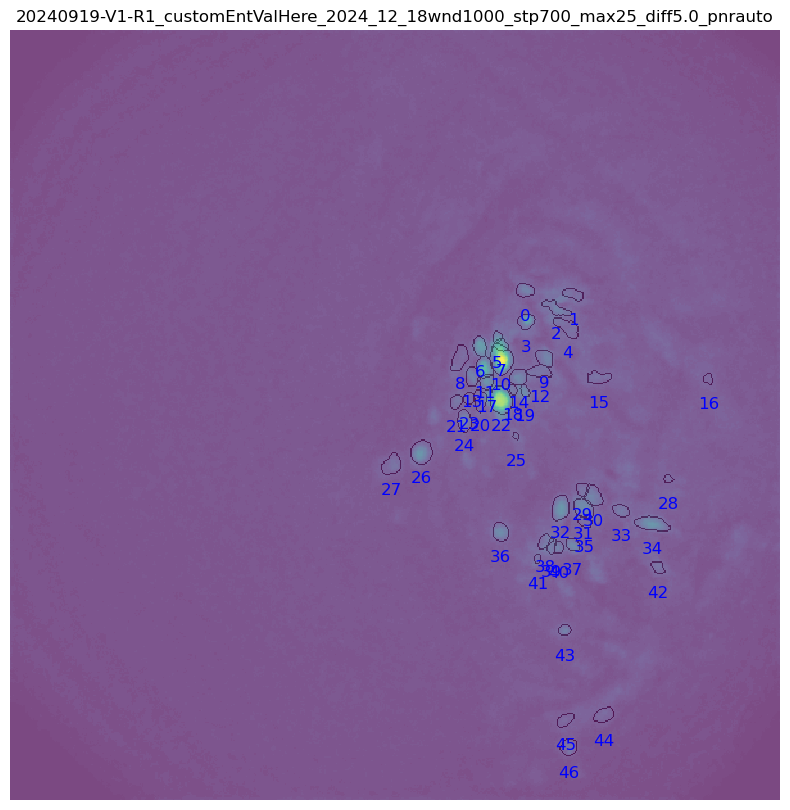

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240919-V1-R1/customEntValHere/2024_12_18/11_33_01/My_V4_Miniscope/minian_dataset_wnd1500_stp700_max25_diff3.5_pnrauto.nc


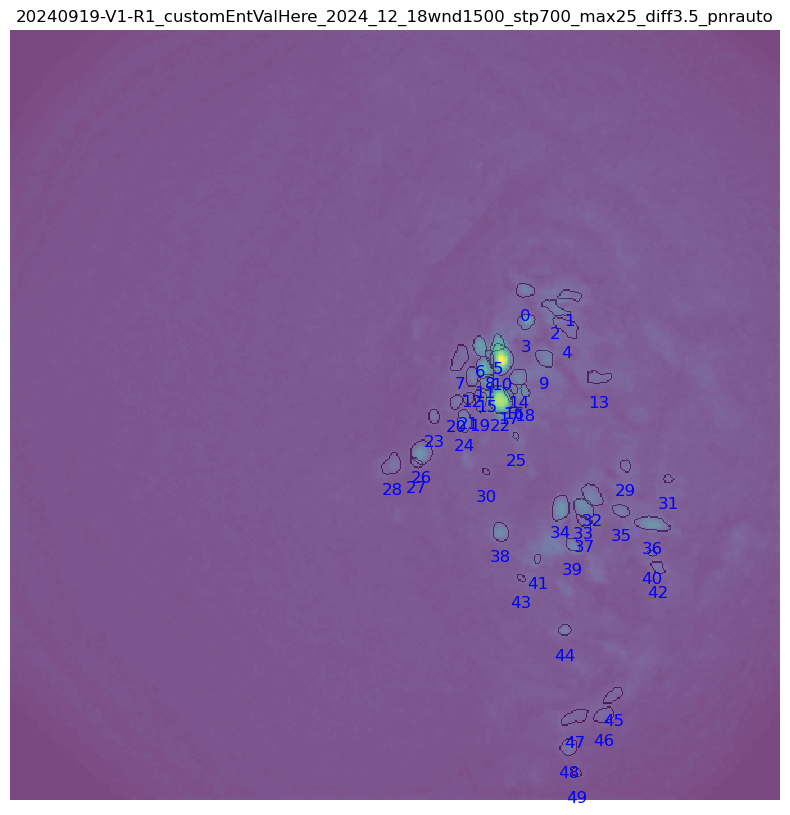

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240919-V1-R1/customEntValHere/2024_12_18/11_33_01/My_V4_Miniscope/minian_dataset_wnd700_stp700_max25_diff3.5_pnr1.1.nc


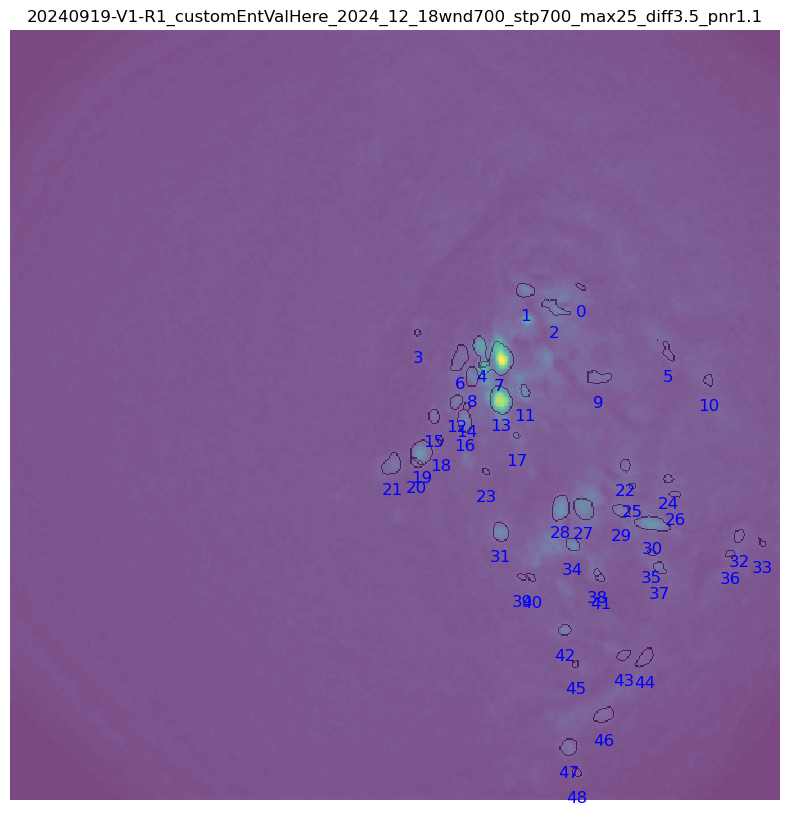

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240919-V1-R1/customEntValHere/2024_12_18/11_33_01/My_V4_Miniscope/minian_dataset_wnd1500_stp700_max25_diff3.5_pnr1.1.nc


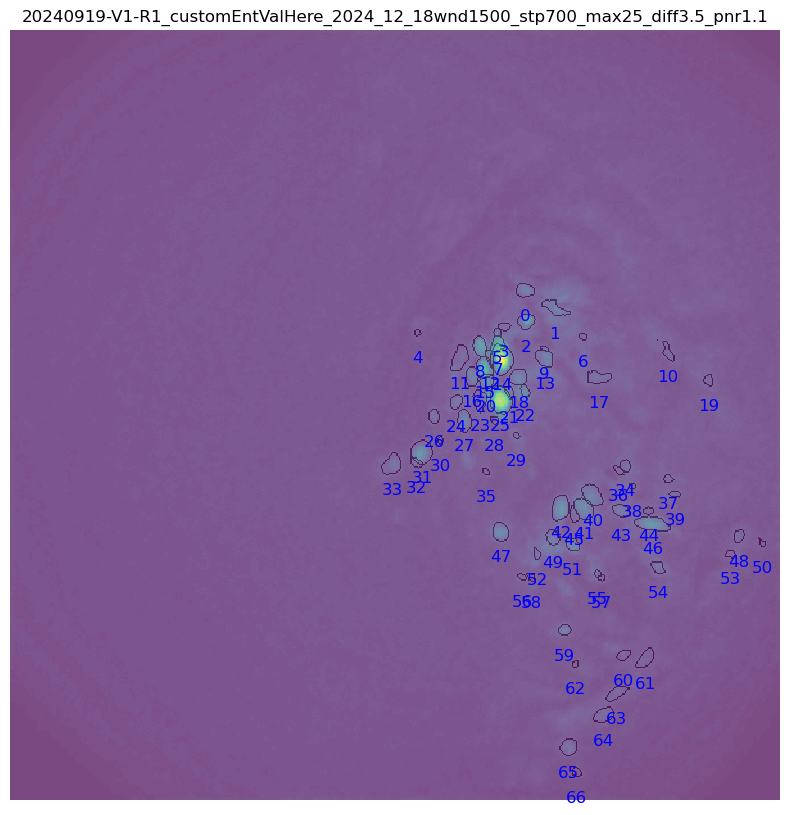

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240919-V1-R1/customEntValHere/2024_12_18/11_33_01/My_V4_Miniscope/minian_dataset_wnd1000_stp700_max25_diff4.0_pnr1.1.nc


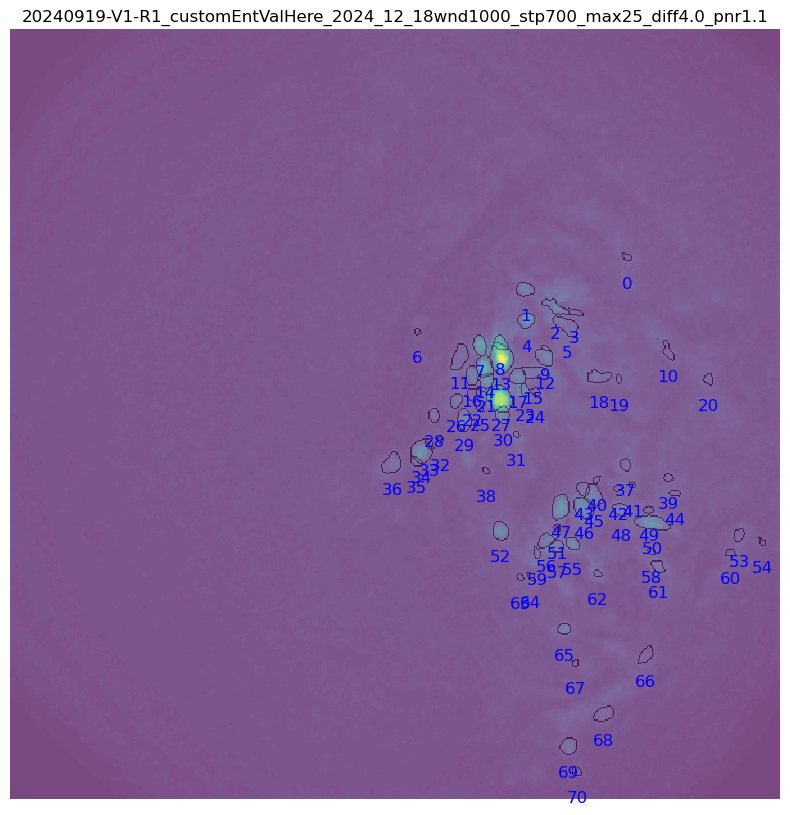

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240919-V1-R1/customEntValHere/2024_12_18/11_33_01/My_V4_Miniscope/minian_dataset_wnd700_stp700_max25_diff3.5_pnrauto.nc


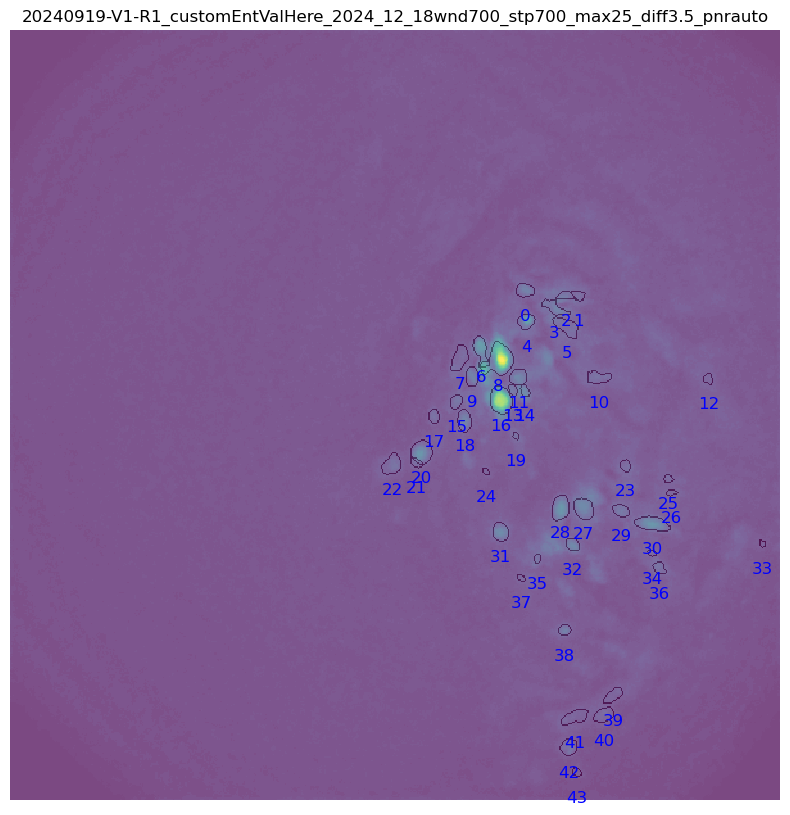

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240919-V1-R1/customEntValHere/2024_12_18/11_33_01/My_V4_Miniscope/minian_dataset_wnd700_stp700_max25_diff4.0_pnr1.1.nc


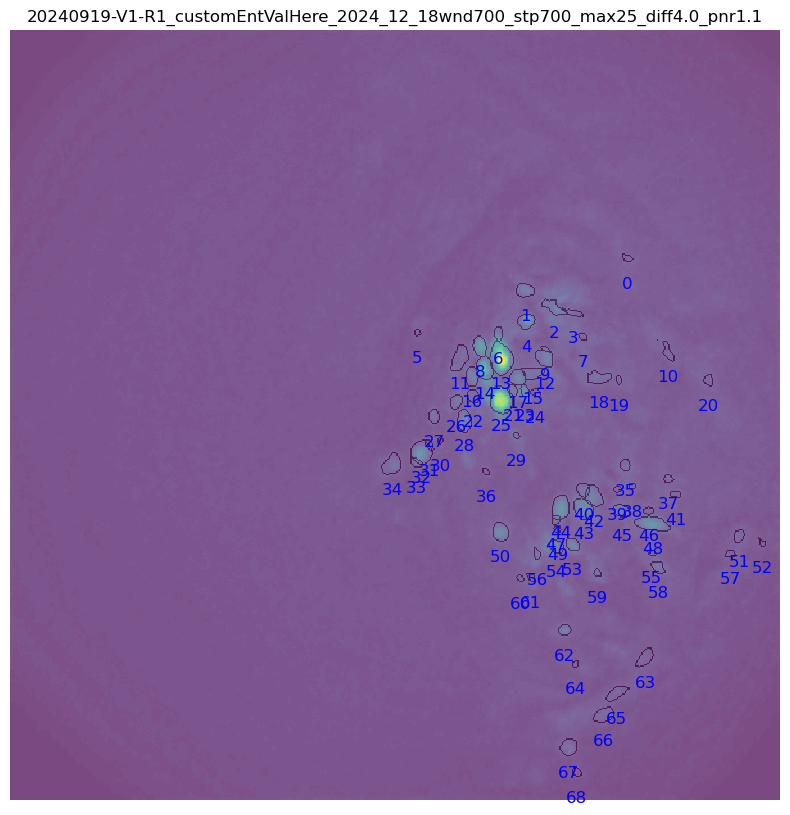

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240919-V1-R1/customEntValHere/2024_12_18/11_33_01/My_V4_Miniscope/minian_dataset_wnd1000_stp700_max25_diff4.0_pnrauto.nc


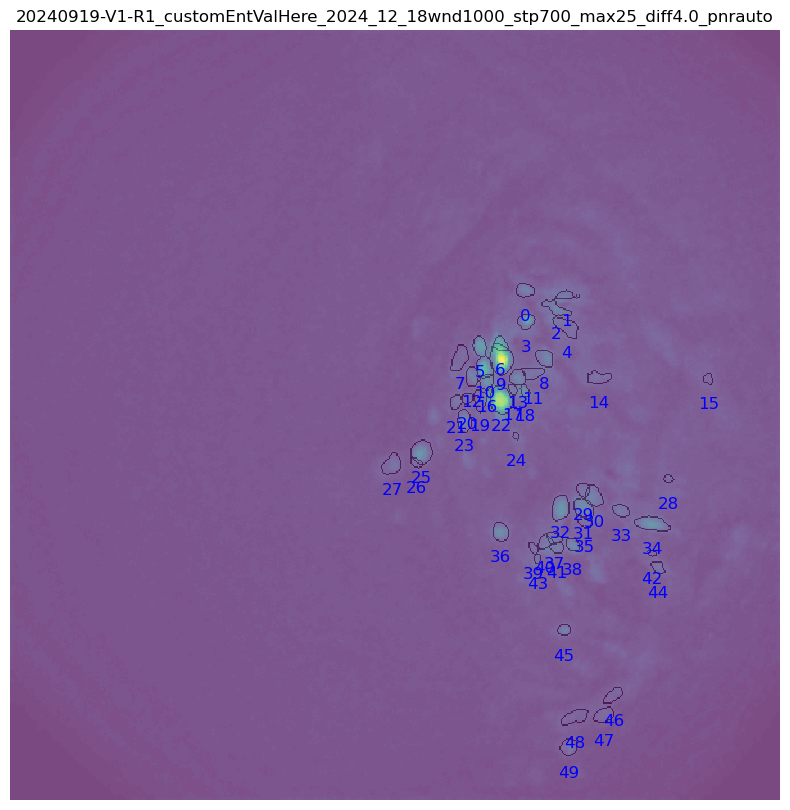

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240919-V1-R1/customEntValHere/2024_12_18/11_33_01/My_V4_Miniscope/minian_dataset_wnd700_stp700_max25_diff5.0_pnrauto.nc


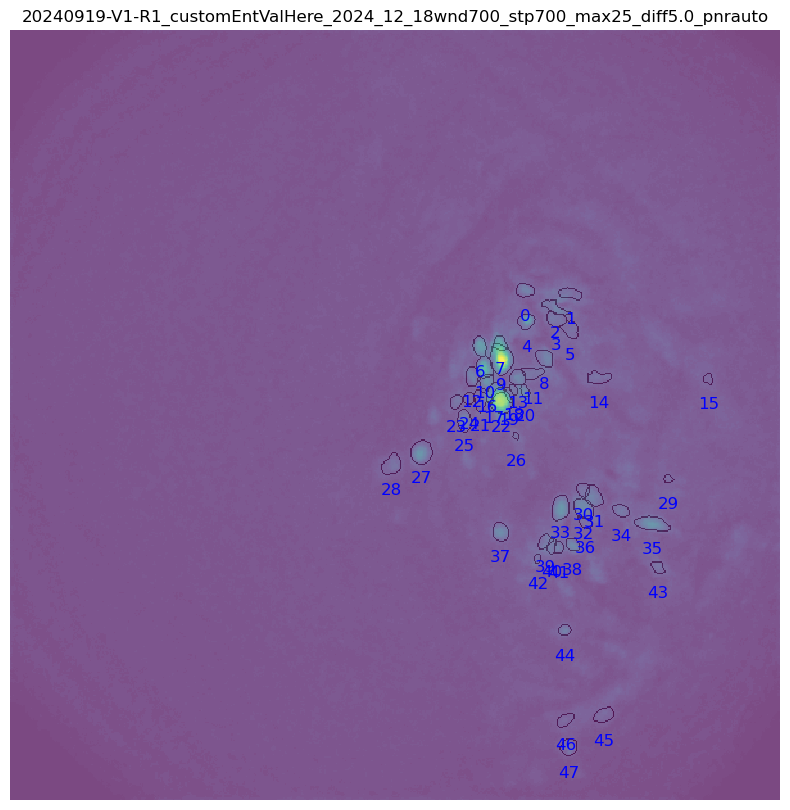

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240919-V1-R1/customEntValHere/2024_12_18/11_33_01/My_V4_Miniscope/minian_dataset_wnd1000_stp700_max25_diff5.0_pnr1.1.nc


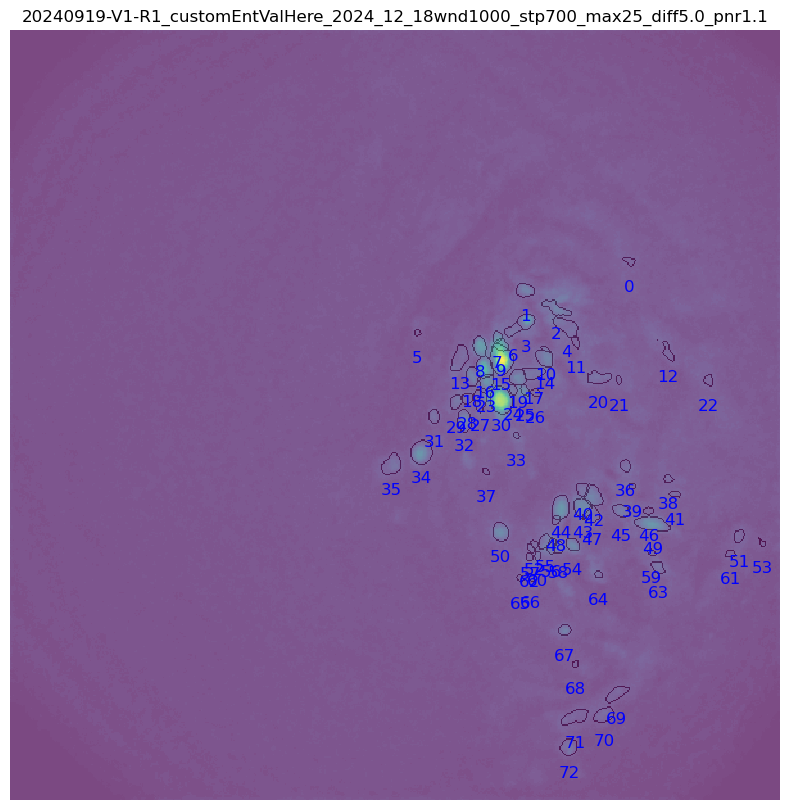


=== Running vis_param_opti for session ===
Animal:       20240919-V1-R1
Session dir:  /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240919-V1-R1/customEntValHere/2024_12_31/14_31_31/My_V4_Miniscope
Found 3 output files:
/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240919-V1-R1/customEntValHere/2024_12_31/14_31_31/My_V4_Miniscope/minian_dataset_wnd700_stp700_max25_diff3.5_pnr1.1.nc
/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240919-V1-R1/customEntValHere/2024_12_31/14_31_31/My_V4_Miniscope/minian_dataset_wnd700_stp700_max25_diff3.5_pnrauto.nc
/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240919-V1-R1/customEntValHere/2024_12_31/14_31_31/My_V4_Miniscope/minian_dataset_wnd700_stp700_max25_diff4.0_pnr1.1.nc
Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240919-V1-R1/customEntValHere/2024_12_31/14_31_31/My_V4_Miniscope/minian_dataset_wnd700_stp700_max25_diff3.5_pnr1.1.nc


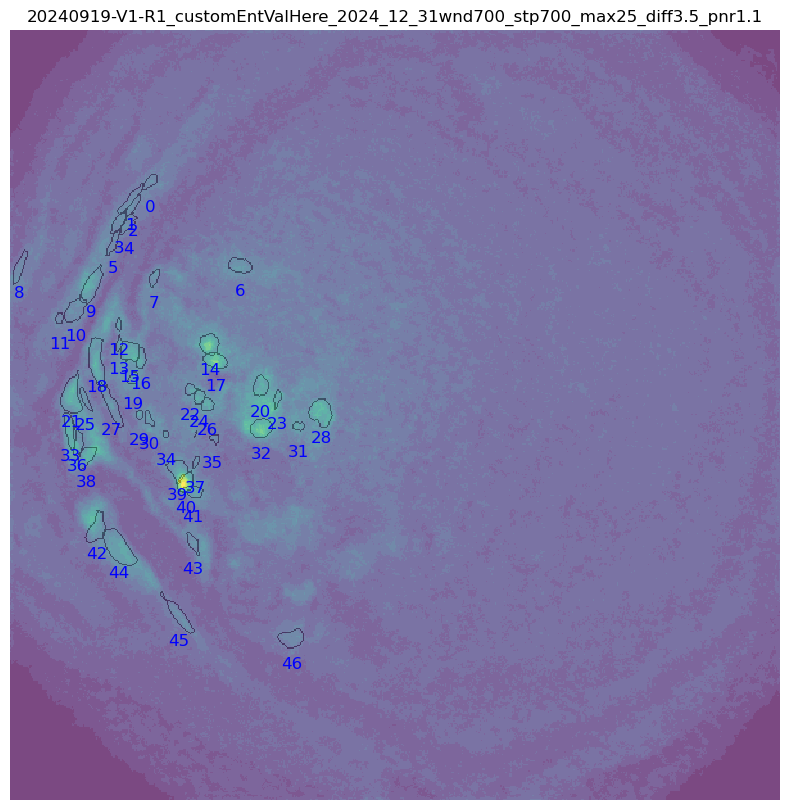

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240919-V1-R1/customEntValHere/2024_12_31/14_31_31/My_V4_Miniscope/minian_dataset_wnd700_stp700_max25_diff3.5_pnrauto.nc


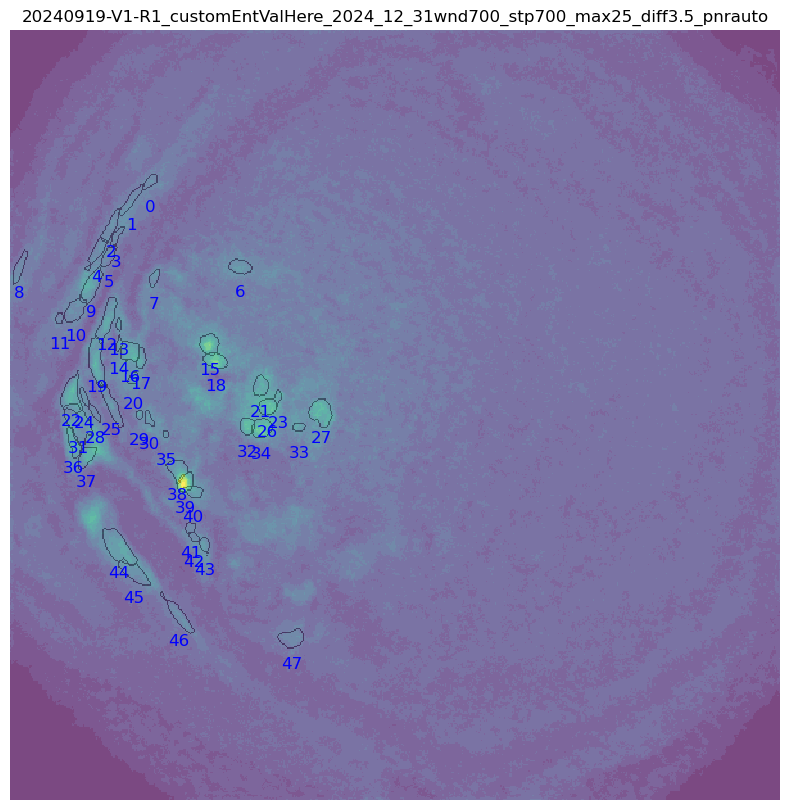

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240919-V1-R1/customEntValHere/2024_12_31/14_31_31/My_V4_Miniscope/minian_dataset_wnd700_stp700_max25_diff4.0_pnr1.1.nc


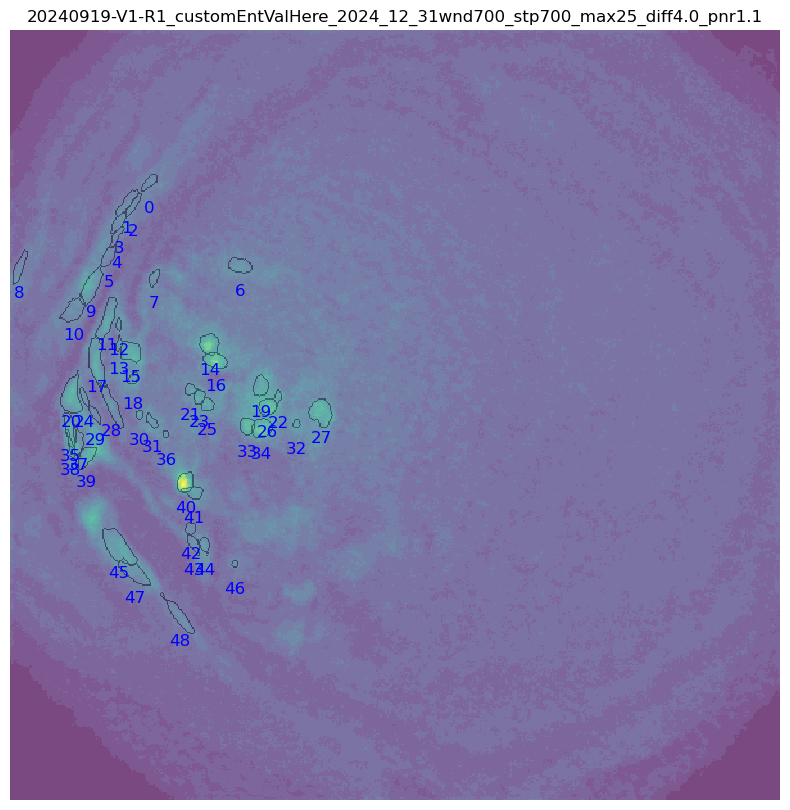


=== Running vis_param_opti for session ===
Animal:       20240919V1L5
Session dir:  /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240919V1L5/customEntValHere/2024_10_31/13_24_56/My_V4_Miniscope
Found 1 output files:
/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240919V1L5/customEntValHere/2024_10_31/13_24_56/My_V4_Miniscope/minian_dataset_241010_denoised.nc
Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20240919V1L5/customEntValHere/2024_10_31/13_24_56/My_V4_Miniscope/minian_dataset_241010_denoised.nc


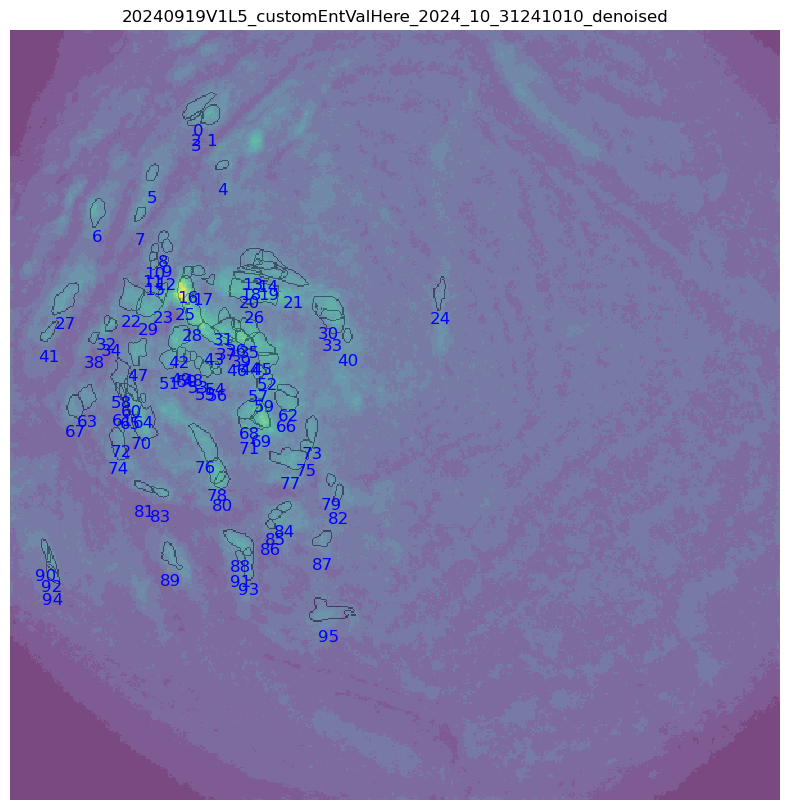


=== Running vis_param_opti for session ===
Animal:       20241001-PMC-r2
Session dir:  /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20241001-PMC-r2/customEntValHere/2024_10_24/15_27_55/My_V4_Miniscope
Found 1 output files:
/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20241001-PMC-r2/customEntValHere/2024_10_24/15_27_55/My_V4_Miniscope/minian_dataset_241104_denoised.nc
Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20241001-PMC-r2/customEntValHere/2024_10_24/15_27_55/My_V4_Miniscope/minian_dataset_241104_denoised.nc


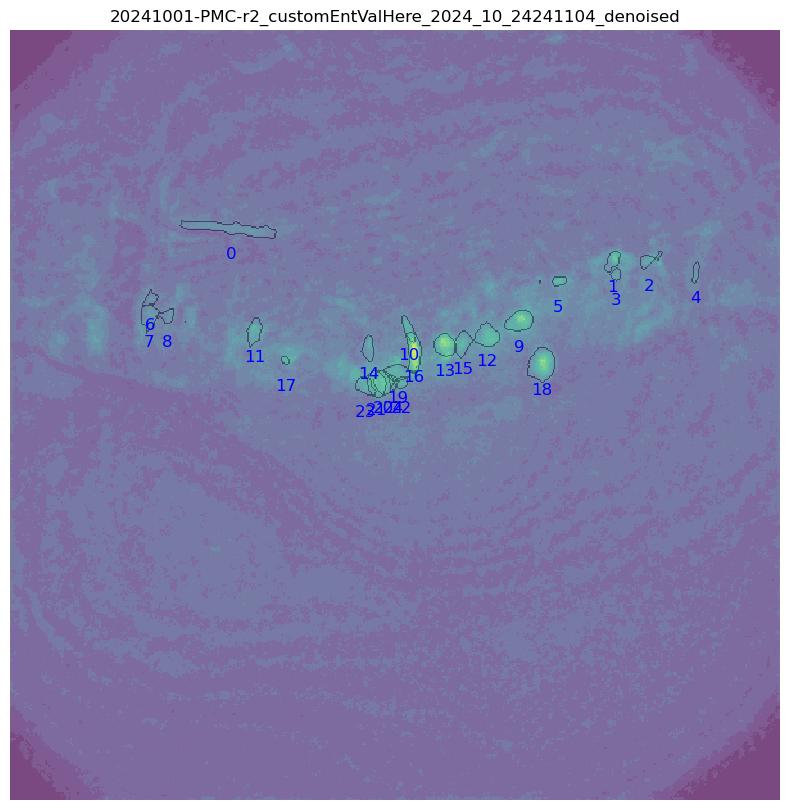


=== Running vis_param_opti for session ===
Animal:       20241002-PMC-R1
Session dir:  /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20241002-PMC-R1/customEntValHere/2024_10_24/13_07_09/My_V4_Miniscope
Found 1 output files:
/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20241002-PMC-R1/customEntValHere/2024_10_24/13_07_09/My_V4_Miniscope/minian_dataset_241105_2_denoised.nc
Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20241002-PMC-R1/customEntValHere/2024_10_24/13_07_09/My_V4_Miniscope/minian_dataset_241105_2_denoised.nc


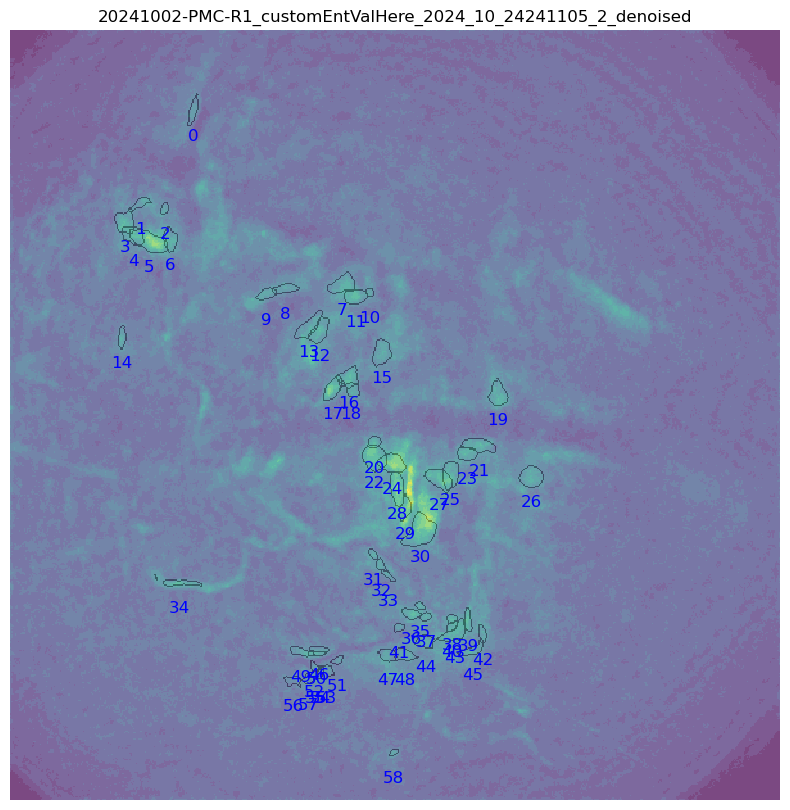


=== Running vis_param_opti for session ===
Animal:       20241002-PMC-R1
Session dir:  /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20241002-PMC-R1/customEntValHere/2024_10_25/15_02_11/My_V4_Miniscope
Found 1 output files:
/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20241002-PMC-R1/customEntValHere/2024_10_25/15_02_11/My_V4_Miniscope/minian_dataset_241105_3_denoised.nc
Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20241002-PMC-R1/customEntValHere/2024_10_25/15_02_11/My_V4_Miniscope/minian_dataset_241105_3_denoised.nc


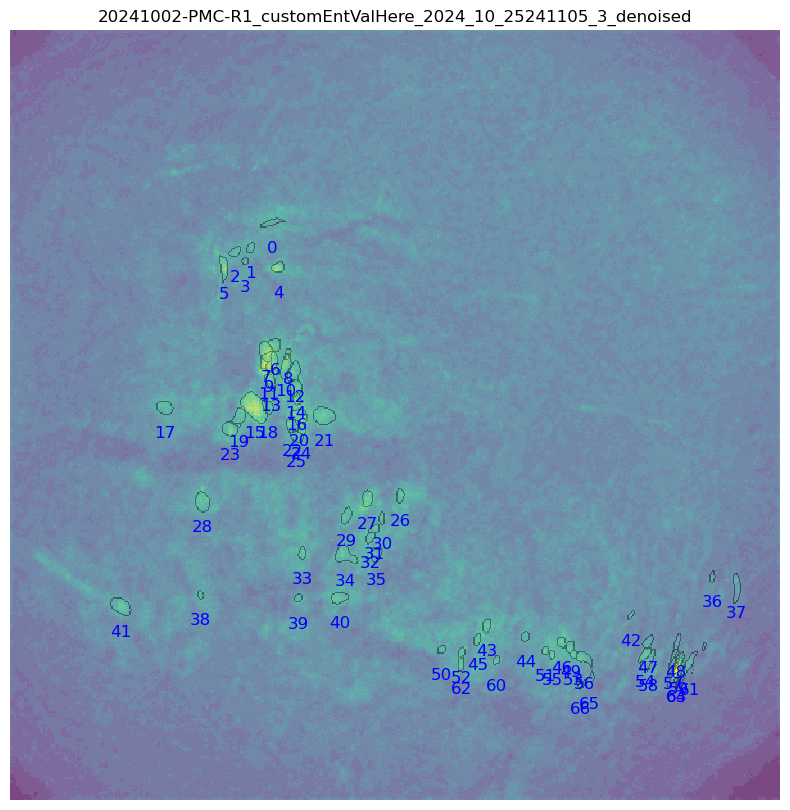


=== Running vis_param_opti for session ===
Animal:       20241002-pmc-r2
Session dir:  /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20241002-pmc-r2/customEntValHere/2024_10_25/15_50_39/My_V4_Miniscope
Found 1 output files:
/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20241002-pmc-r2/customEntValHere/2024_10_25/15_50_39/My_V4_Miniscope/minian_dataset_241104_denoised.nc
Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20241002-pmc-r2/customEntValHere/2024_10_25/15_50_39/My_V4_Miniscope/minian_dataset_241104_denoised.nc


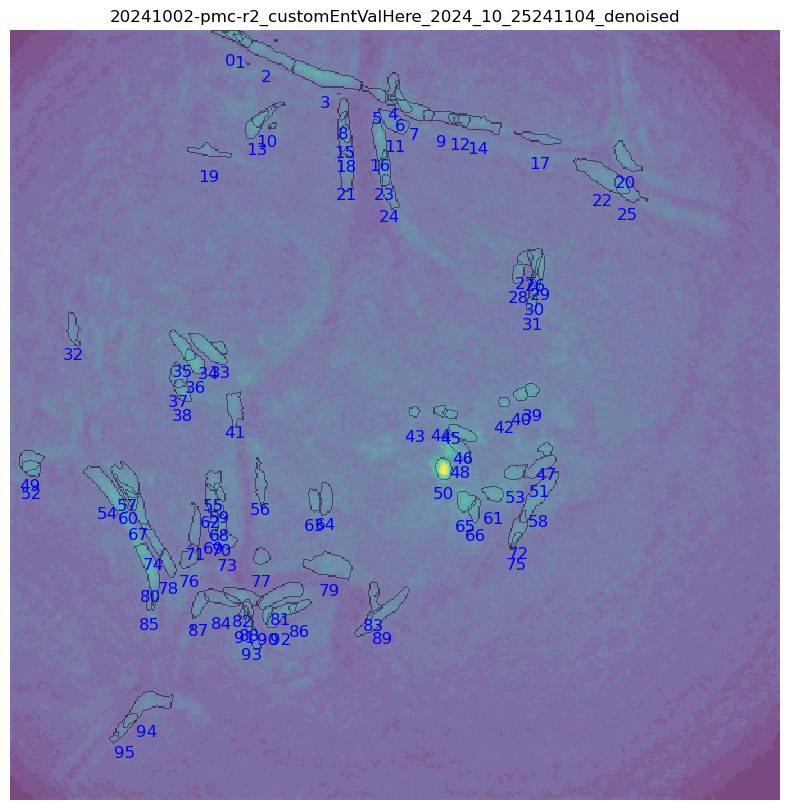


=== Running vis_param_opti for session ===
Animal:       20241015PMCBE1
Session dir:  /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20241015PMCBE1/customEntValHere/2025_02_27/12_25_53/My_V4_Miniscope
Found 19 output files:
/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20241015PMCBE1/customEntValHere/2025_02_27/12_25_53/My_V4_Miniscope/minian_dataset_stp_size_300.nc
/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20241015PMCBE1/customEntValHere/2025_02_27/12_25_53/My_V4_Miniscope/minian_dataset_wnd1500_stp700_max15_diff4.0_pnrauto.nc
/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20241015PMCBE1/customEntValHere/2025_02_27/12_25_53/My_V4_Miniscope/minian_dataset_wnd700_stp700_max15_diff5.0_pnr1.1.nc
/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20241015PMCBE1/customEntValHere/2025_02_27/12_25_53/My_V4_Miniscope/minian_dataset_wnd1000_stp700_max15_diff5.0_pnr1.1.nc
/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20241015PMCBE1/customEntValHere/2025_02_27/12_25_53/My_V4_Miniscope/minian_datase

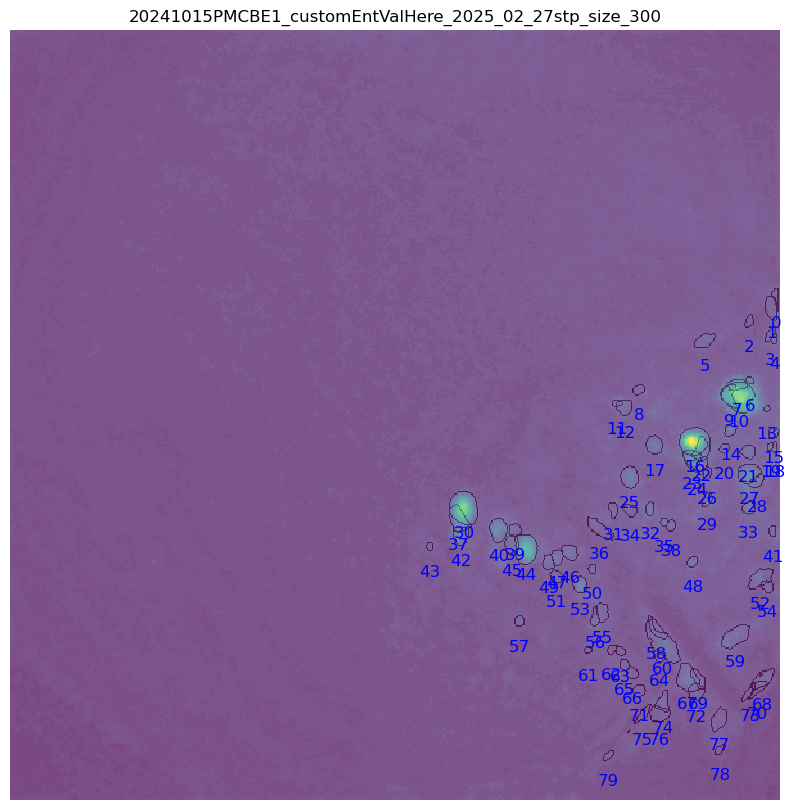

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20241015PMCBE1/customEntValHere/2025_02_27/12_25_53/My_V4_Miniscope/minian_dataset_wnd1500_stp700_max15_diff4.0_pnrauto.nc


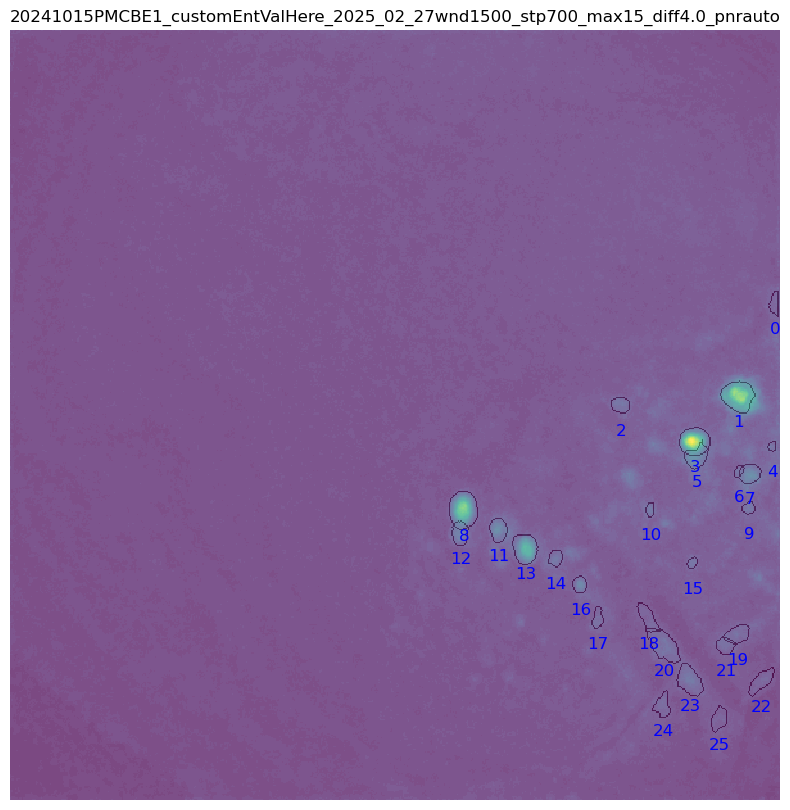

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20241015PMCBE1/customEntValHere/2025_02_27/12_25_53/My_V4_Miniscope/minian_dataset_wnd700_stp700_max15_diff5.0_pnr1.1.nc


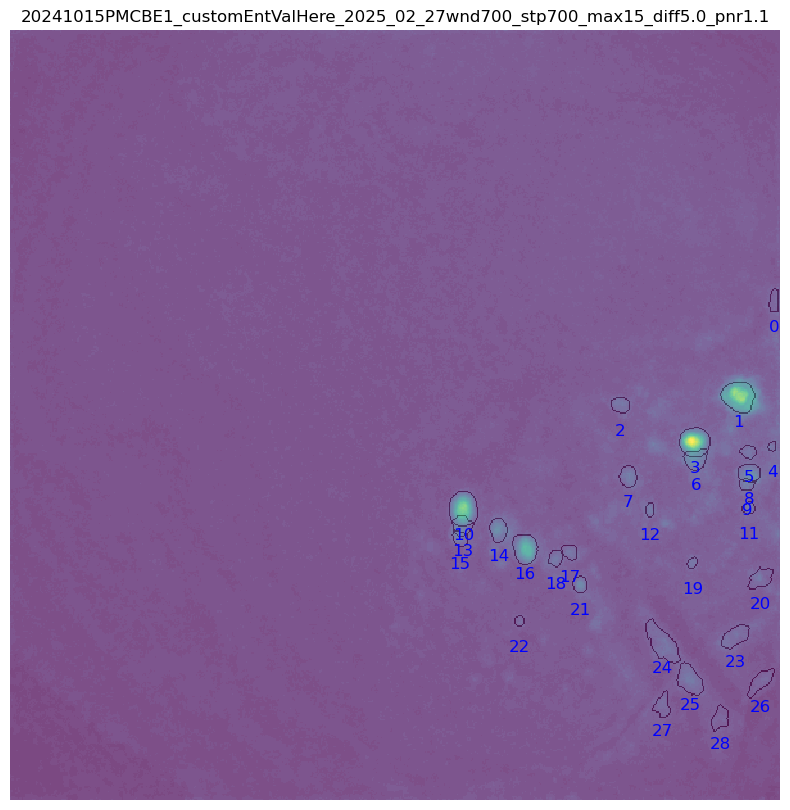

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20241015PMCBE1/customEntValHere/2025_02_27/12_25_53/My_V4_Miniscope/minian_dataset_wnd1000_stp700_max15_diff5.0_pnr1.1.nc


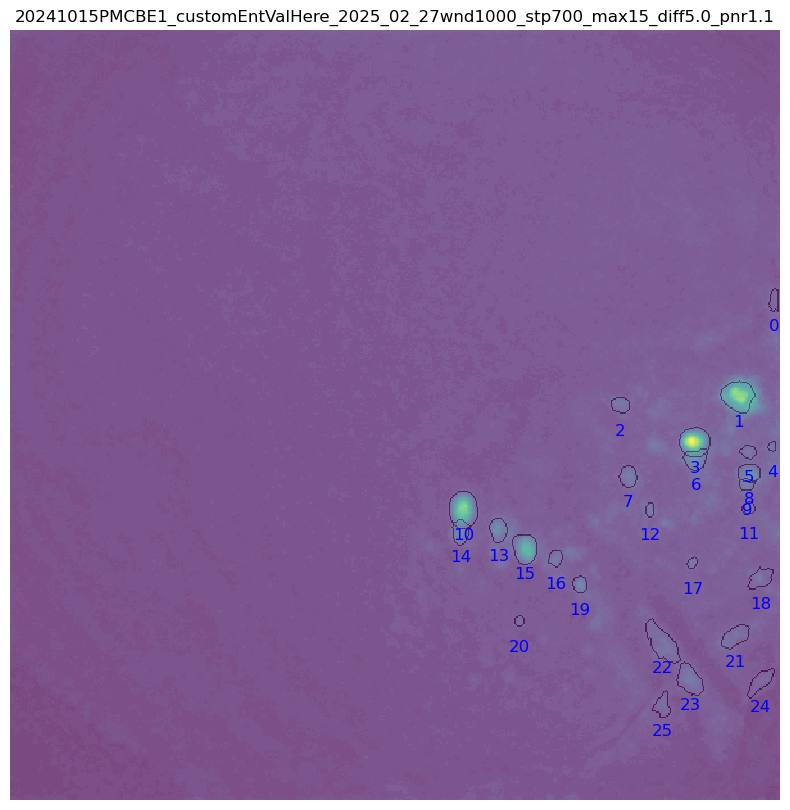

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20241015PMCBE1/customEntValHere/2025_02_27/12_25_53/My_V4_Miniscope/minian_dataset_wnd1500_stp700_max15_diff4.0_pnr1.1.nc


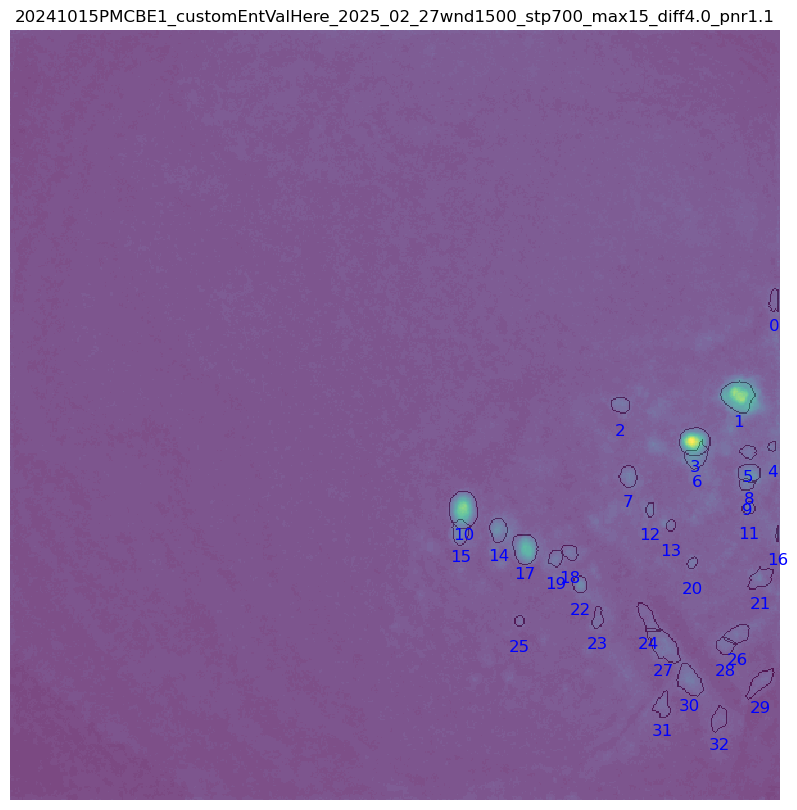

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20241015PMCBE1/customEntValHere/2025_02_27/12_25_53/My_V4_Miniscope/minian_dataset_wnd700_stp700_max15_diff4.0_pnr1.1.nc


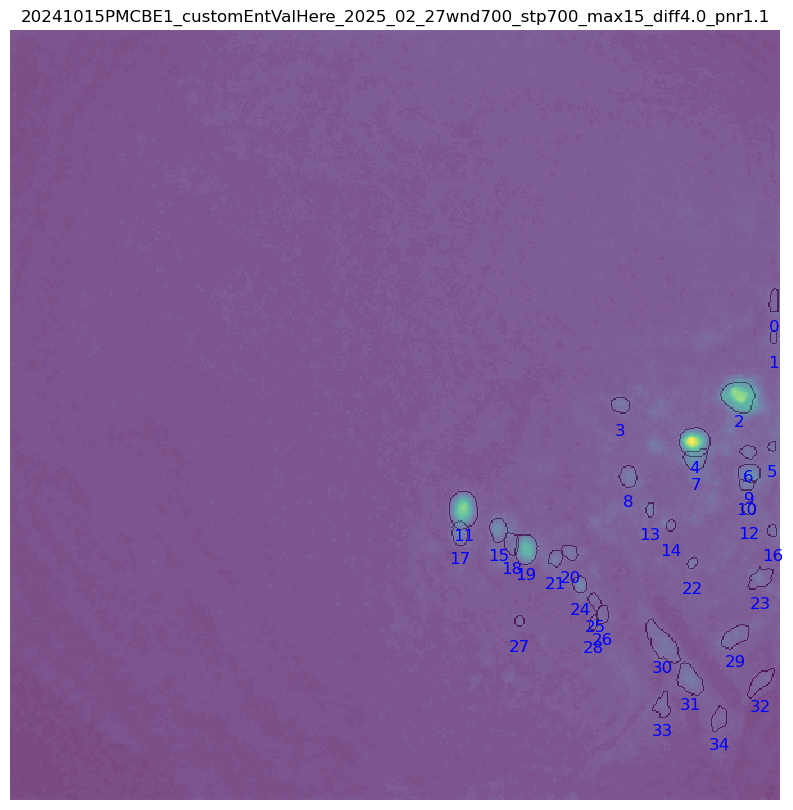

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20241015PMCBE1/customEntValHere/2025_02_27/12_25_53/My_V4_Miniscope/minian_dataset_wnd1000_stp700_max15_diff3.5_pnr1.1.nc


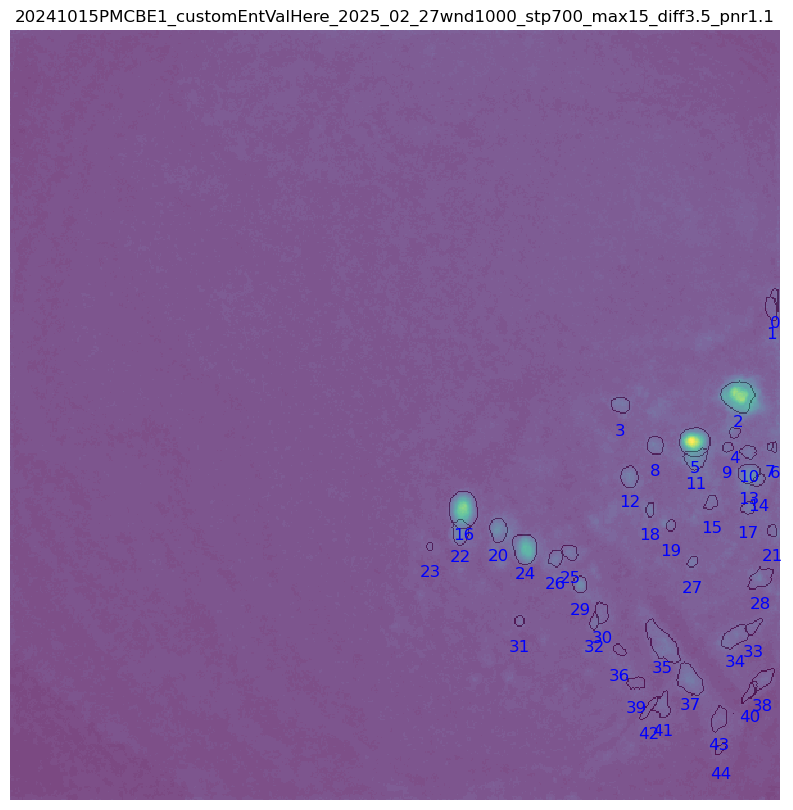

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20241015PMCBE1/customEntValHere/2025_02_27/12_25_53/My_V4_Miniscope/minian_dataset_wnd700_stp700_max15_diff3.5_pnrauto.nc


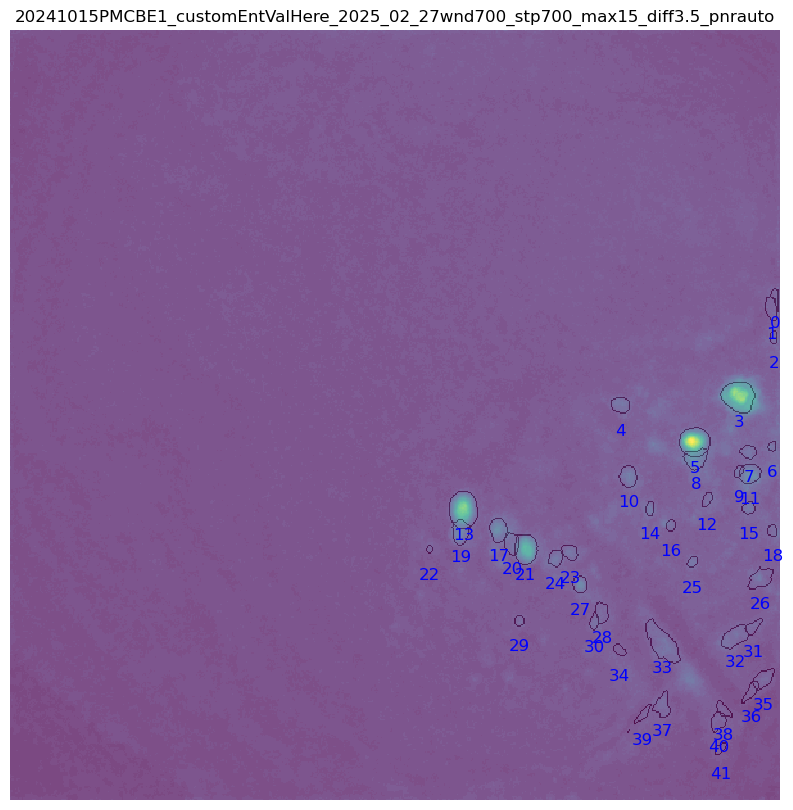

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20241015PMCBE1/customEntValHere/2025_02_27/12_25_53/My_V4_Miniscope/minian_dataset_baseline.nc


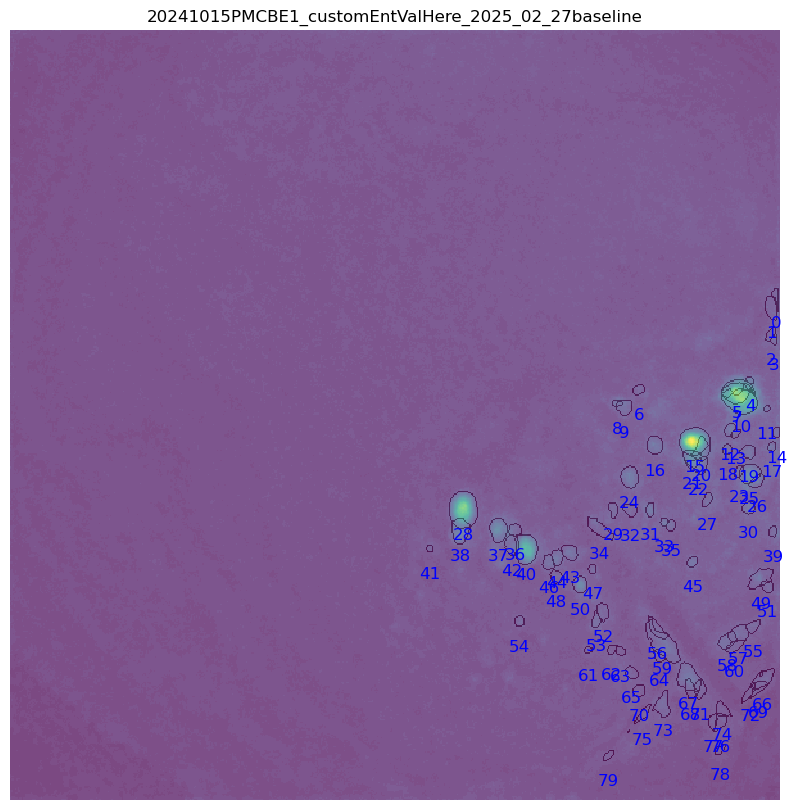

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20241015PMCBE1/customEntValHere/2025_02_27/12_25_53/My_V4_Miniscope/minian_dataset_wnd700_stp700_max15_diff5.0_pnrauto.nc


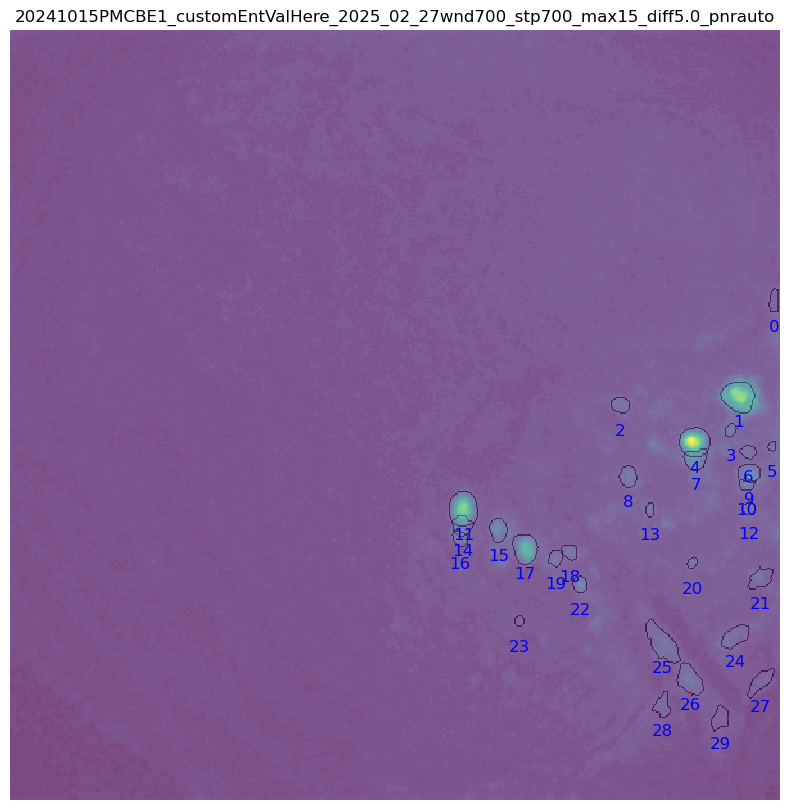

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20241015PMCBE1/customEntValHere/2025_02_27/12_25_53/My_V4_Miniscope/minian_dataset_wnd1500_stp700_max15_diff3.5_pnr1.1.nc


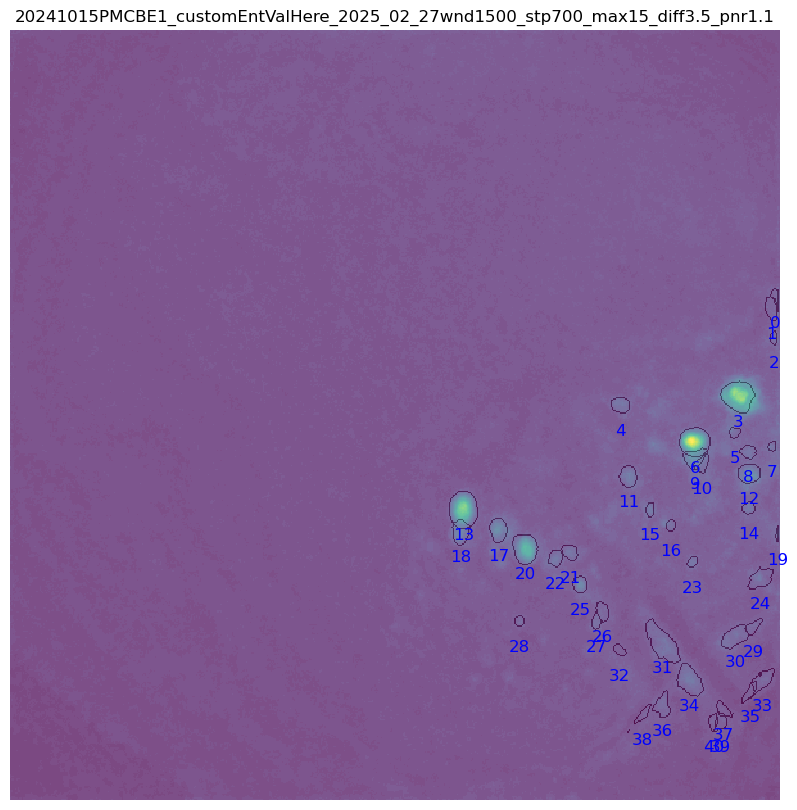

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20241015PMCBE1/customEntValHere/2025_02_27/12_25_53/My_V4_Miniscope/minian_dataset_wnd1000_stp700_max15_diff4.0_pnr1.1.nc


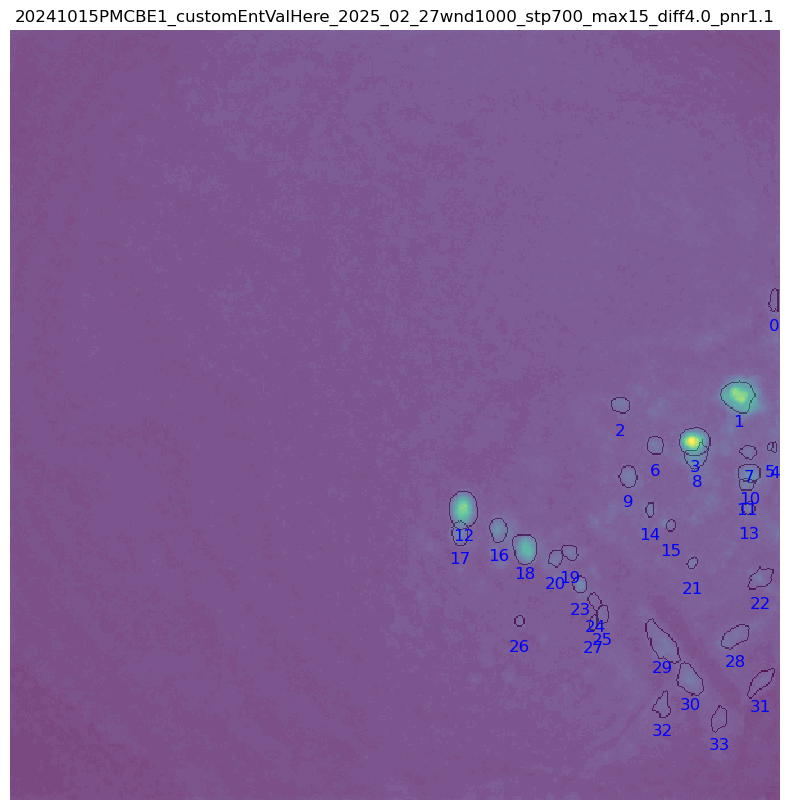

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20241015PMCBE1/customEntValHere/2025_02_27/12_25_53/My_V4_Miniscope/minian_dataset_max_wnd_15.nc


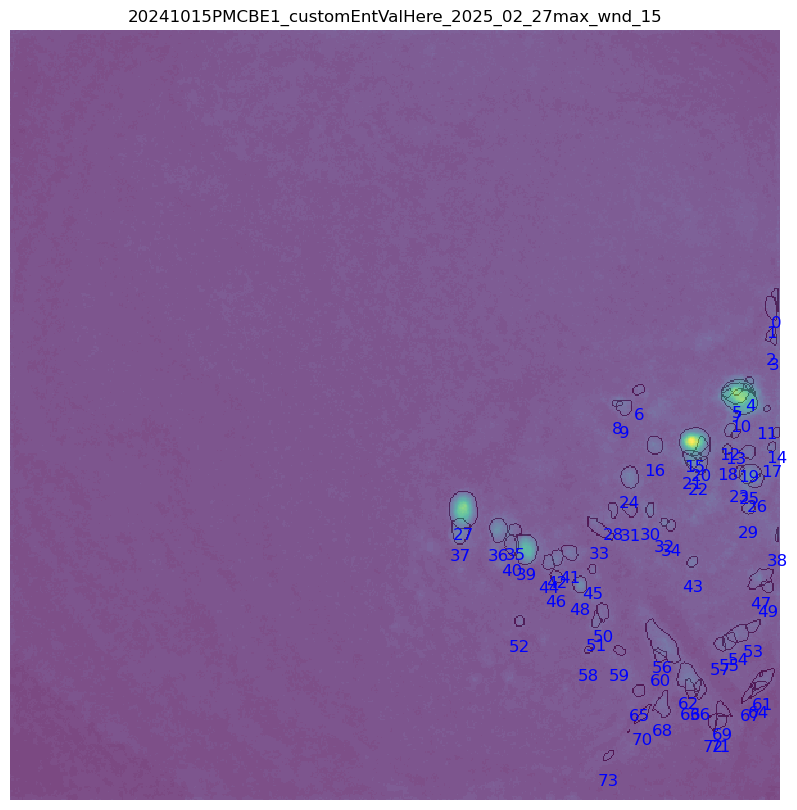

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20241015PMCBE1/customEntValHere/2025_02_27/12_25_53/My_V4_Miniscope/minian_dataset_wnd_size_700.nc


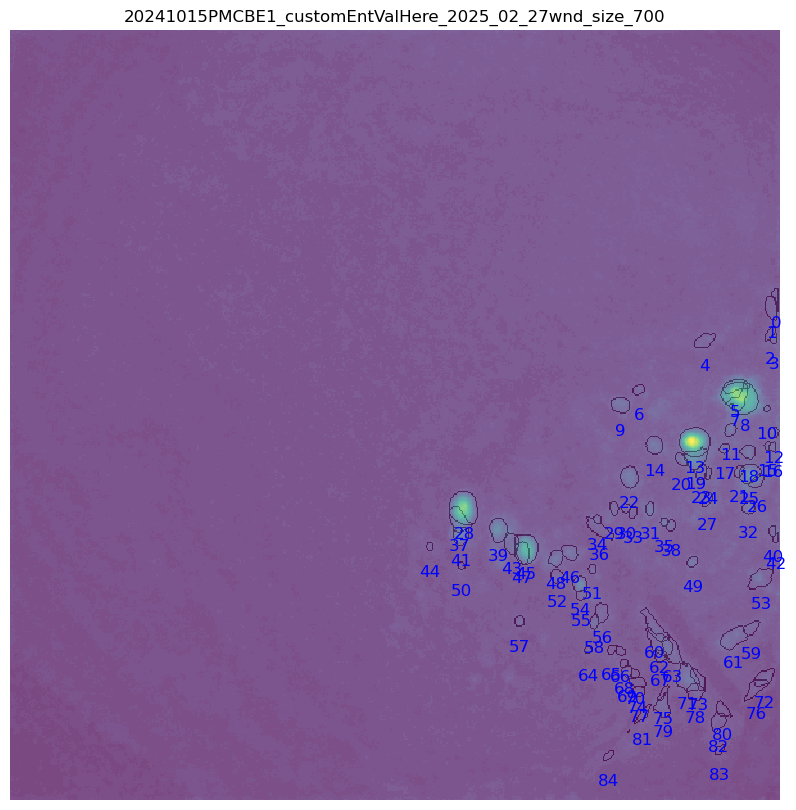

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20241015PMCBE1/customEntValHere/2025_02_27/12_25_53/My_V4_Miniscope/minian_dataset_wnd700_stp700_max15_diff3.5_pnr1.1.nc


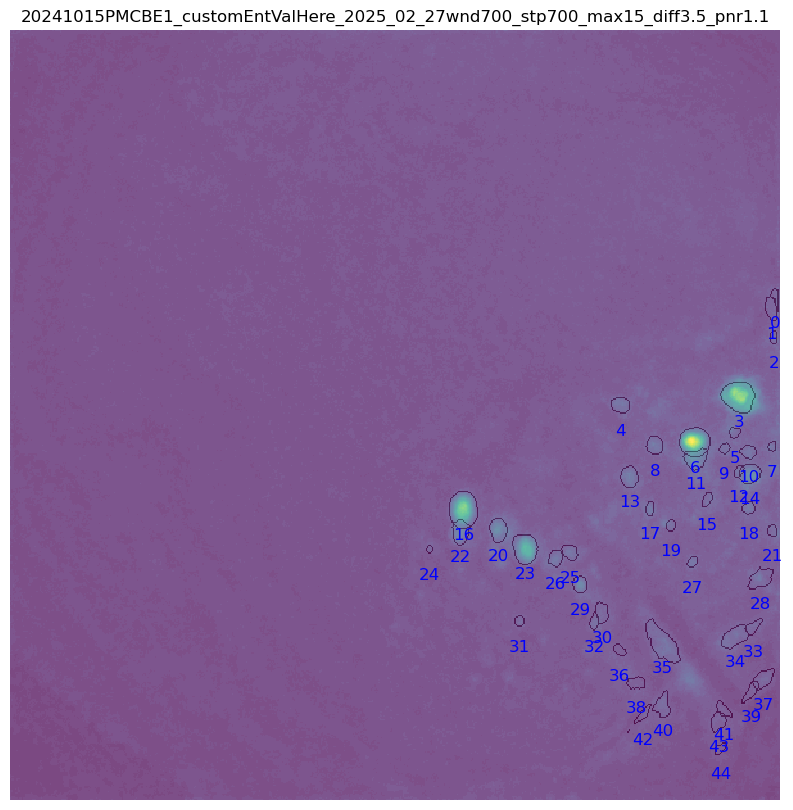

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20241015PMCBE1/customEntValHere/2025_02_27/12_25_53/My_V4_Miniscope/minian_dataset_wnd1500_stp700_max15_diff5.0_pnrauto.nc


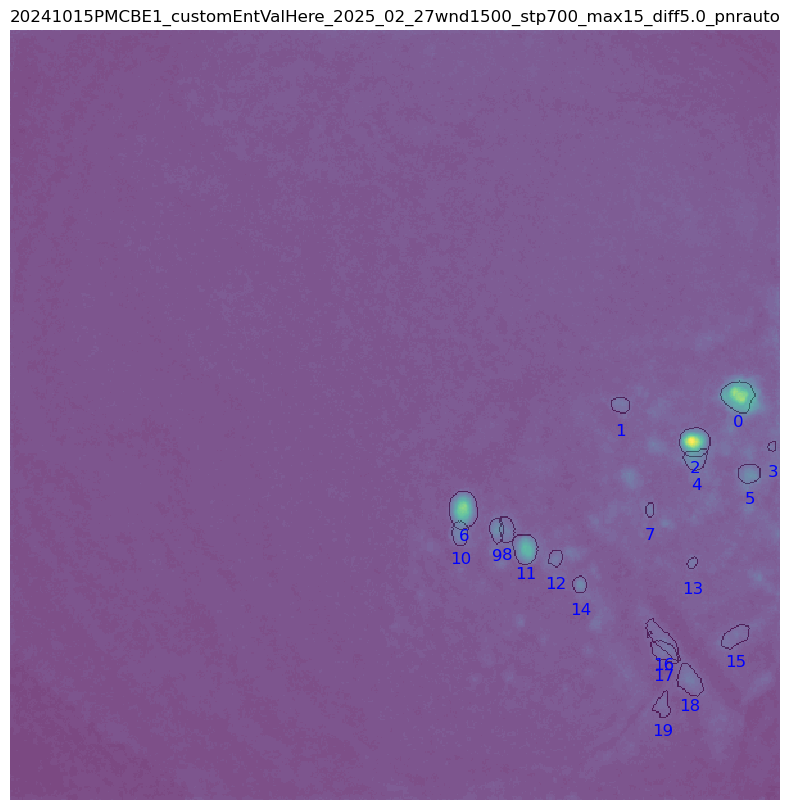

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20241015PMCBE1/customEntValHere/2025_02_27/12_25_53/My_V4_Miniscope/minian_dataset_wnd1500_stp700_max15_diff5.0_pnr1.1.nc


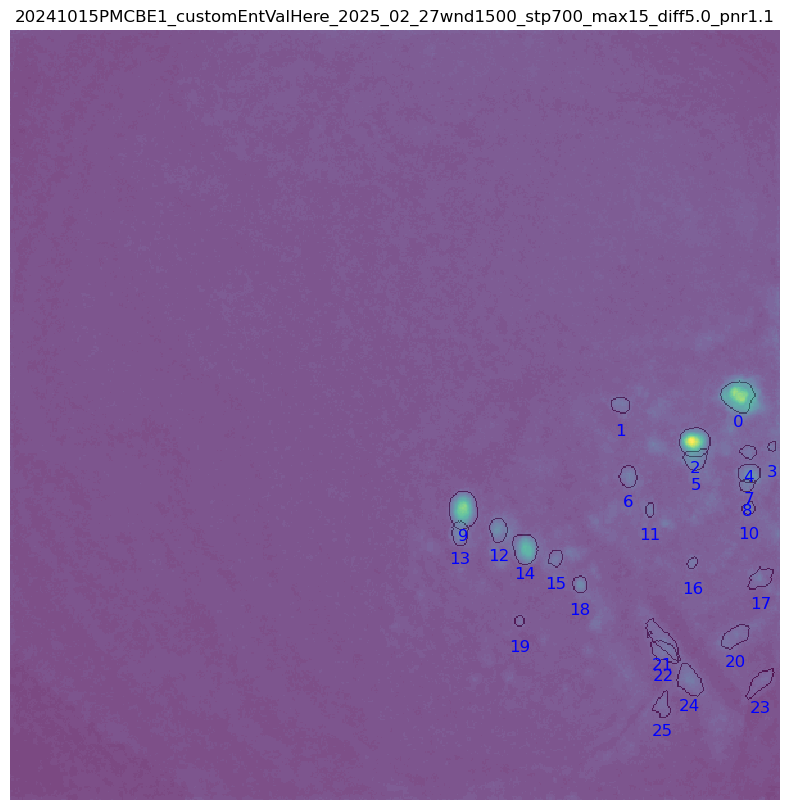

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20241015PMCBE1/customEntValHere/2025_02_27/12_25_53/My_V4_Miniscope/minian_dataset_wnd1500_stp700_max15_diff3.5_pnrauto.nc


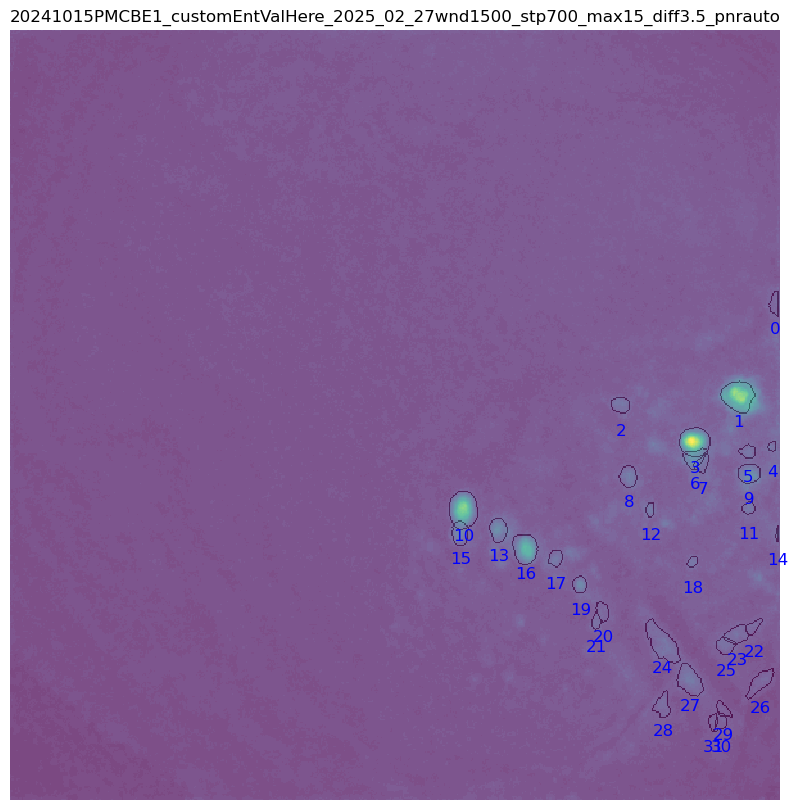

Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20241015PMCBE1/customEntValHere/2025_02_27/12_25_53/My_V4_Miniscope/minian_dataset_wnd700_stp700_max15_diff4.0_pnrauto.nc


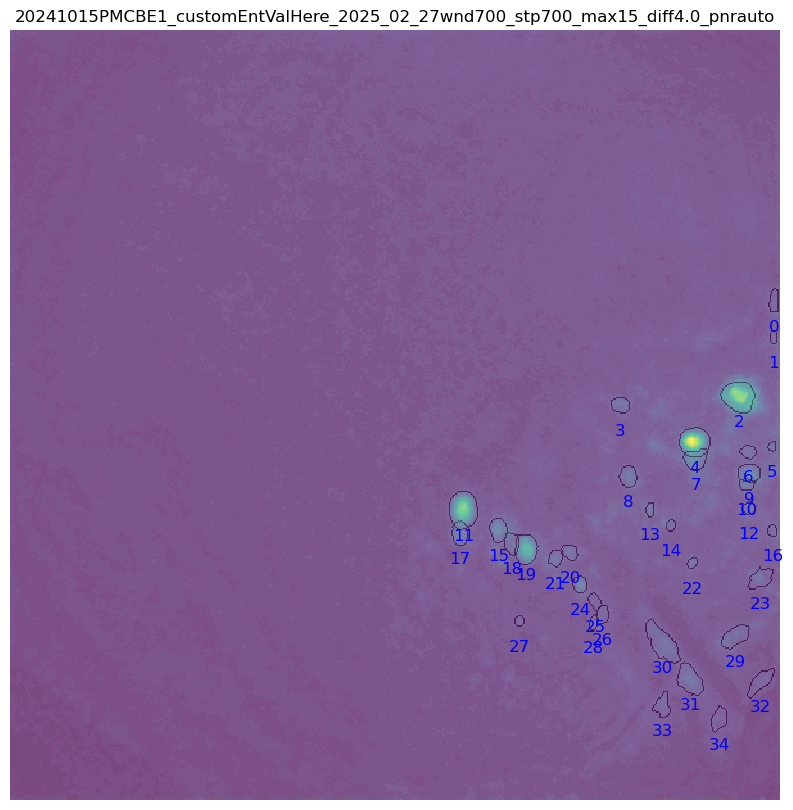


=== Running vis_param_opti for session ===
Animal:       20241224PMCLE1
Session dir:  /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20241224PMCLE1/customEntValHere/2025_02_13/11_07_37/My_V4_Miniscope
Found 1 output files:
/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20241224PMCLE1/customEntValHere/2025_02_13/11_07_37/My_V4_Miniscope/minian_dataset_wnd1500_stp700_max15_diff3.5_pnrauto.nc
Processing: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/20241224PMCLE1/customEntValHere/2025_02_13/11_07_37/My_V4_Miniscope/minian_dataset_wnd1500_stp700_max15_diff3.5_pnrauto.nc


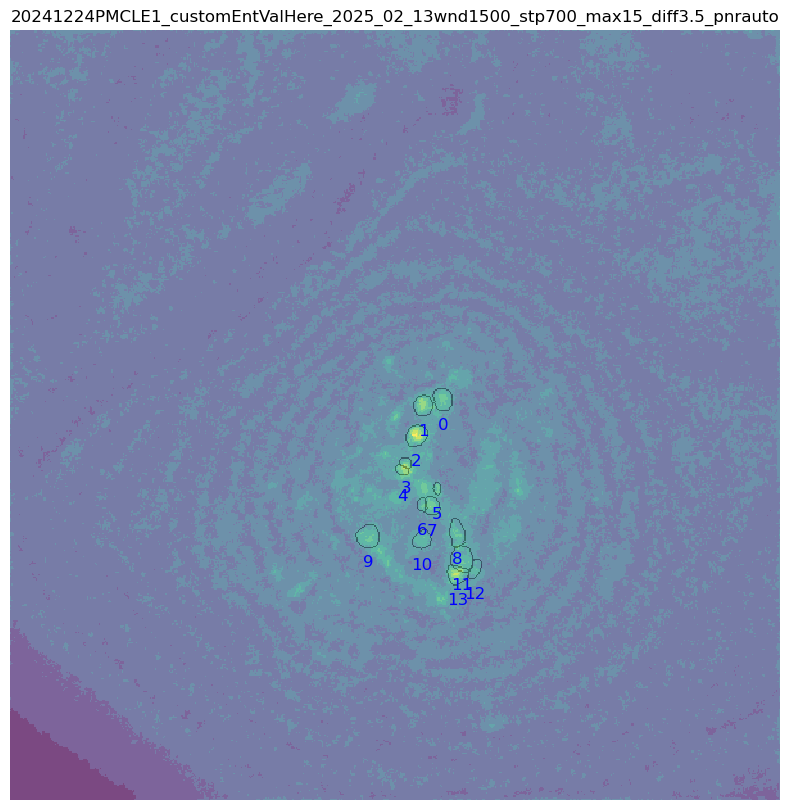

In [ ]:
# from utlis.Ca_tools.mini_param_vis_utlis import vis_param_opti

from utlis.Ca_tools.run_mini_param_utlis import run_vis_param_opti_from_table
run_vis_param_opti_from_table(mini_param_for_vis)


In [4]:
import pyarrow.compute as pc
table = all_mini #combined_df


filter_mask = pc.and_(
    pc.equal(table['minian'], '1'), 
    pc.equal(table['valid_rec'], '1') #not_equal
)


# Apply the filter and print the results
filtered_table_mini = table.filter(filter_mask)

# Print each row of the filtered table
print(filtered_table_mini.to_pandas())  # This will display the filtered data in a familiar pandas-like format


   minian valid_rec                   timestamp         animal_id  \
0       1         1  2025-03-19T14:27:32.192918    2024-016v1l1r1   
1       1         1  2025-03-19T14:27:32.226484  202401015-PMC-r1   
2       1         1  2025-03-19T14:27:32.224353  202401015-PMC-r1   
3       1         1  2025-03-19T14:27:32.223244  202401015-PMC-r1   
4       1         1  2025-03-19T14:27:32.222407  202401015-PMC-r2   
..    ...       ...                         ...               ...   
56      1         1  2025-03-19T14:27:32.208486   20241002-pmc-r2   
57      1         1  2025-03-19T14:27:32.202386   20241002-pmc-r2   
58      1         1  2025-03-19T14:27:32.205433   20241002-pmc-r2   
59      1         1  2025-03-19T14:27:32.227310    20241015PMCBE1   
60      1         1  2025-03-19T14:27:32.227365    20241224PMCLE1   

        custom_label        date      time  
0   customEntValHere  2025_01_23  19_17_52  
1   customEntValHere  2024_11_06  16_16_30  
2   customEntValHere  2024_11_07  14

In [8]:
import pyarrow.compute as pc
table = all_mini #combined_df


# filter_mask = pc.and_(
#     pc.equal(table['minian'], '1'), 
#     pc.equal(table['valid_rec'], '1') #not_equal
# )



# Apply the filter and print the results
mini_valid = table.filter(pc.equal(table['valid_rec'], '1'))

# Print each row of the filtered table
print(mini_valid.to_pandas())  # This will display the filtered data in a familiar pandas-like format


   minian valid_rec         rec_name                   timestamp  \
0       0         1  My_V4_Miniscope  2025-02-20T14:04:55.587550   
1       1         1  My_V4_Miniscope  2025-02-20T14:04:55.603356   
2       1         1  My_V4_Miniscope  2025-02-20T14:04:55.605187   
3       1         1  My_V4_Miniscope  2025-02-20T14:04:55.604662   
4       1         1  My_V4_Miniscope  2025-02-20T14:04:55.603020   
..    ...       ...              ...                         ...   
73      0         1  My_V4_Miniscope  2025-02-20T14:04:55.605502   
74      0         1  My_V4_Miniscope  2025-02-20T14:04:55.605380   
75      0         1  My_V4_Miniscope  2025-02-20T14:04:55.605005   
76      0         1  My_V4_Miniscope  2025-02-20T14:04:55.605462   
77      0         1  My_V4_Miniscope  2025-02-20T14:04:55.605342   

           animal_id      custom_label        date      time calib_files  
0     2024-016v1l1r1  customEntValHere  2025_01_23  19_17_52          []  
1   202401015-PMC-r1  customEntVa

In [7]:
# below works well, but, sometimes there is something that i filterted, or not yet processed, will lead to a mismatch.

#  import os
# import re
# import json
# import pyarrow.compute as pc

# # --- Helper functions ---

# def parse_time_str(time_str):
#     """Parse a time string 'HH_MM_SS' or 'HH_MM' into a tuple (hour, minute, second)."""
#     parts = time_str.split('_')
#     if len(parts) == 3:
#         return int(parts[0]), int(parts[1]), int(parts[2])
#     elif len(parts) == 2:
#         return int(parts[0]), int(parts[1]), 0
#     else:
#         raise ValueError(f"Invalid time format: {time_str}")

# def time_to_seconds(hour, minute, second):
#     return hour * 3600 + minute * 60 + second

# def parse_rec_time(rec_file):
#     """
#     Extract a time tuple from a rec_file string.
#     E.g., for "20241002PMCr2_15_42" it takes the last two underscore tokens as hour and minute.
#     """
#     tokens = rec_file.split('_')
#     if len(tokens) >= 2:
#         try:
#             hour = int(tokens[-2])
#             minute = int(tokens[-1])
#             return hour, minute, 0
#         except ValueError:
#             # fallback: use regex extraction
#             matches_hour = re.findall(r'\d+', tokens[-2])
#             matches_min = re.findall(r'\d+', tokens[-1])
#             if matches_hour and matches_min:
#                 return int(matches_hour[0]), int(matches_min[0]), 0
#     return None

# def build_mini_path(mini_root, animal_id, custom_label, date_str, time_str):
#     """
#     Build the miniscope path using:
#       mini_root / animal_id / custom_label / date_str / time_str / My_V4_Miniscope
#     """
#     return os.path.join(mini_root, animal_id, custom_label, date_str, time_str, "My_V4_Miniscope")

# def build_rec_path(rec_base, date_folder, rec_file):
#     """
#     Build the rec path as:
#       rec_base / date_folder / rec_file / DANNCE / predict00 / save_data_AVG.mat
#     """
#     return os.path.join(rec_base, date_folder, rec_file, "DANNCE", "predict00", "save_data_AVG.mat")

# # --- Main matching function using PyArrow filtering ---

# def match_mini_to_rec(filtered_table_mini, filtered_table, mini_root, rec_base, time_threshold=3600):
#     """
#     For each miniscope record (from filtered_table_mini), filter the rec table (filtered_table)
#     by matching the 'date' (in mini) to 'date_folder' (in rec) using pyarrow.compute.
    
#     Then, among rec candidates, pick the one with the smallest time difference
#     (using mini 'time' vs. time parsed from rec_file). Only candidates with a difference
#     less than time_threshold (in seconds) are accepted.
    
#     Returns a dictionary mapping the built mini_path to the matched rec_path (or None).
#     """
#     mapping = {}
    
#     # Iterate over mini records as a list of dicts (expected to be small after filtering)
#     for mini_rec in filtered_table_mini.to_pylist():
#         mini_date = mini_rec["date"]         # e.g., "2024_10_25"
#         mini_time_str = mini_rec["time"]      # e.g., "15_50_39"
#         animal_id = mini_rec["animal_id"]
#         custom_label = mini_rec["custom_label"]
        
#         try:
#             mini_h, mini_m, mini_s = parse_time_str(mini_time_str)
#         except Exception as e:
#             print(f"Skipping mini record with invalid time '{mini_time_str}': {e}")
#             continue
#         mini_seconds = time_to_seconds(mini_h, mini_m, mini_s)
        
#         # Build the full mini path
#         mini_path = build_mini_path(mini_root, animal_id, custom_label, mini_date, mini_time_str)
        
#         # Filter the rec table for rows with matching date_folder using pyarrow
#         cond = pc.equal(filtered_table.column("date_folder"), mini_date)
#         rec_date_table = filtered_table.filter(cond)
        
#         rec_candidates = rec_date_table.to_pylist()  # should be a small subset
#         best_diff = None
#         best_rec = None
        
#         for rec in rec_candidates:
#             rec_file = rec["rec_file"]
#             rec_time = parse_rec_time(rec_file)
#             if rec_time is None:
#                 continue
#             rec_seconds = time_to_seconds(*rec_time)
#             diff = abs(mini_seconds - rec_seconds)
#             if best_diff is None or diff < best_diff:
#                 best_diff = diff
#                 best_rec = rec
        
#         if best_rec is not None and best_diff <= time_threshold:
#             rec_path = build_rec_path(rec_base, mini_date, best_rec["rec_file"])
#         else:
#             rec_path = None
        
#         mapping[mini_path] = rec_path
#         print(f"Mini: {mini_path}\nMatched Rec: {rec_path} (Time diff: {best_diff})\n")
    
#     return mapping

# # --- Example usage in a Jupyter cell ---
# # (Assuming filtered_table_mini and filtered_table are already defined PyArrow Tables)

# # Define your root directories (update these as needed)
# mini_root = "/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted"  # e.g., the base directory for miniscope data
# rec_base  = "/data/big_rim/rsync_dcc_sum/Oct3V1"   # e.g., the base directory for rec prediction folders

# # Run the matching code (using the already-filtered PyArrow tables)
# mapping = match_mini_to_rec(mini_valid, all_df, mini_root, rec_base) #if we only use filtered, sometimes there will be mismatch, and that will be bad.

# # Optionally, you can save the mapping to a JSON file
# with open("mini_to_rec_mapping.json", "w") as f:
#     json.dump(mapping, f, indent=4)


Mini: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/202401015-PMC-r1/customEntValHere/2024_11_06/16_16_30/My_V4_Miniscope
Matched Rec: /data/big_rim/rsync_dcc_sum/Oct3V1/2024_11_06/20241015pmcr1_16_12/DANNCE/predict00/save_data_AVG.mat (Time diff: 270)

Mini: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/202401015-PMC-r1/customEntValHere/2024_11_07/14_36_12/My_V4_Miniscope
Matched Rec: None (Time diff: 6252)

Mini: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/202401015-PMC-r1/customEntValHere/2024_11_07/14_53_09/My_V4_Miniscope
Matched Rec: None (Time diff: 7269)

Mini: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/202401015-PMC-r2/customEntValHere/2024_11_06/16_57_35/My_V4_Miniscope
Matched Rec: /data/big_rim/rsync_dcc_sum/Oct3V1/2024_11_06/20241015pmcr2_16_53/DANNCE/predict00/save_data_AVG.mat (Time diff: 275)

Mini: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/202401015-PMC-r2/customEntValHere/2024_11_07/13_04_45/My_V4_Miniscope
Matched Rec: /data/big_rim/rsync_dcc_sum/Oct3V1/2024

In [16]:
import os
import re
import json
import datetime
import pyarrow.compute as pc

# ----- Helper Functions -----

def parse_time_str(time_str):
    """
    Parse a time string in the format 'HH_MM_SS' or 'HH_MM' into a tuple (hour, minute, second).
    """
    parts = time_str.split('_')
    if len(parts) == 3:
        return int(parts[0]), int(parts[1]), int(parts[2])
    elif len(parts) == 2:
        return int(parts[0]), int(parts[1]), 0
    else:
        raise ValueError(f"Invalid time format: {time_str}")

def time_to_seconds(hour, minute, second):
    return hour * 3600 + minute * 60 + second

def get_rec_time_from_videos(rec_base, date_folder, rec_file):
    """
    Given the rec_base, date_folder, and rec_file, build the videos folder path:
        videos_path = f"{rec_base}/{date_folder}/{rec_file}/videos"
    and return the time-of-day (hour, minute, second) based on its modification time.
    """
    videos_path = os.path.join(rec_base, date_folder, rec_file, "videos")
    try:
        # Using the modification time as a proxy for creation time.
        timestamp = os.path.getmtime(videos_path)
        dt = datetime.datetime.fromtimestamp(timestamp)
        return dt.hour, dt.minute, dt.second
    except Exception as e:
        print(f"Error getting time for {videos_path}: {e}")
        return None

def build_mini_path(mini_root, animal_id, custom_label, date_str, time_str):
    """
    Build the miniscope path using:
      mini_root / animal_id / custom_label / date_str / time_str / My_V4_Miniscope
    """
    return os.path.join(mini_root, animal_id, custom_label, date_str, time_str, "My_V4_Miniscope")

def build_rec_path(rec_base, date_folder, rec_file):
    """
    Build the rec path as:
      rec_base / date_folder / rec_file / DANNCE / predict00 / save_data_AVG.mat
    """
    return os.path.join(rec_base, date_folder, rec_file, "DANNCE", "predict00", "save_data_AVG.mat")

# ----- Matching Function Using PyArrow Filtering -----

def match_mini_to_rec_all(filtered_table_mini, all_rec_table, filtered_rec_table, mini_root, rec_base, time_threshold=3600):
    """
    For each processed miniscope record in filtered_table_mini, find the best matching rec candidate from all_rec_table.
    Instead of parsing the rec_file for a time, this version uses the modification time of the rec video's folder.
    Then check if the candidate is in filtered_rec_table to mark it as valid.
    
    Parameters:
      filtered_table_mini: PyArrow Table with processed miniscope records (columns: "date", "time", "animal_id", "custom_label", etc.)
      all_rec_table: PyArrow Table with all rec entries (columns: "date_folder", "rec_file", etc.)
      filtered_rec_table: PyArrow Table with rec entries that passed further processing.
      mini_root: Base directory for constructing the full miniscope path.
      rec_base: Base directory for constructing the rec prediction path.
      time_threshold: Maximum allowed time difference (in seconds) for a match to be considered valid.
    
    Returns:
      A dictionary mapping each constructed mini_path to a dict with:
          "rec_path": the constructed rec prediction file path (or None),
          "time_diff": the time difference (in seconds) between mini time and rec video time,
          "valid": True if the candidate is in filtered_rec_table and within threshold, else False.
    """
    mapping = {}
    
    # Loop over each processed miniscope record
    for mini_rec in filtered_table_mini.to_pylist():
        mini_date = mini_rec["date"]         # e.g., "2024_10_25"
        mini_time_str = mini_rec["time"]      # e.g., "15_50_39"
        animal_id = mini_rec["animal_id"]
        custom_label = mini_rec["custom_label"]
        
        try:
            mini_h, mini_m, mini_s = parse_time_str(mini_time_str)
        except Exception as e:
            print(f"Skipping mini record with invalid time '{mini_time_str}': {e}")
            continue
        mini_seconds = time_to_seconds(mini_h, mini_m, mini_s)
        
        # Build the full mini path
        mini_path = build_mini_path(mini_root, animal_id, custom_label, mini_date, mini_time_str)
        
        # Filter all_rec_table for rec entries with matching date_folder using pyarrow
        cond_date = pc.equal(all_rec_table.column("date_folder"), mini_date)
        rec_date_table = all_rec_table.filter(cond_date)
        rec_candidates = rec_date_table.to_pylist()  # This subset should be small
        
        best_diff = None
        best_rec = None
        
        # Loop through candidates to find the rec with the smallest time difference
        for rec in rec_candidates:
            rec_file = rec["rec_file"]
            rec_time = get_rec_time_from_videos(rec_base, mini_date, rec_file)
            if rec_time is None:
                continue
            rec_seconds = time_to_seconds(*rec_time)
            diff = abs(mini_seconds - rec_seconds)
            if best_diff is None or diff < best_diff:
                best_diff = diff
                best_rec = rec
        
        # Determine the rec_path and check validity
        if best_rec is not None:
            rec_path = build_rec_path(rec_base, mini_date, best_rec["rec_file"])
            # Check if this candidate is in the filtered_rec_table (i.e., further validated recs)
            cond_filtered = pc.equal(filtered_rec_table.column("rec_file"), best_rec["rec_file"])
            filtered_candidates = filtered_rec_table.filter(cond_filtered)
            is_filtered = filtered_candidates.num_rows > 0
            # Mark candidate as valid if within threshold and exists in filtered_rec_table
            valid_candidate = (best_diff is not None and best_diff <= time_threshold) and is_filtered
        else:
            rec_path = None
            best_diff = None
            valid_candidate = False
        
        mapping[mini_path] = {"rec_path": rec_path, "time_diff": best_diff, "valid": valid_candidate}
        print(f"Mini: {mini_path}\nMatched Rec: {rec_path} (Time diff: {best_diff}) Valid: {valid_candidate}\n")
    
    return mapping

def resolve_duplicates(mapping):
    """
    Ensure that each rec_path is only matched to one mini_path.
    For any rec_path that appears for multiple mini_paths, only keep the one with the smallest time_diff.
    The other mini_paths will have their rec_path set to None and valid flag set to False.
    """
    # Build a dictionary mapping rec_path to a list of (mini_path, time_diff) tuples.
    rec_to_mini = {}
    for mini_path, info in mapping.items():
        rec = info["rec_path"]
        if rec is None:
            continue
        rec_to_mini.setdefault(rec, []).append((mini_path, info["time_diff"]))
    
    # For each rec_path that is assigned to multiple mini_paths,
    # keep only the mini_path with the smallest time_diff.
    for rec, mini_list in rec_to_mini.items():
        if len(mini_list) > 1:
            best_mini, best_diff = min(mini_list, key=lambda x: x[1])
            for mini_path, diff in mini_list:
                if mini_path != best_mini:
                    mapping[mini_path]["rec_path"] = None
                    mapping[mini_path]["valid"] = False
                    print(f"Duplicate resolved: {mini_path} lost rec_path {rec} (time_diff {diff} > {best_diff})")
    return mapping

# ----- Example Usage in a Jupyter Cell -----

# Assume the following PyArrow tables are already defined in your notebook:
#   - filtered_table_mini: processed miniscope entries (valid miniscope data)
#   - all_rec_table: full set of rec entries (e.g., all_df)
#   - filtered_rec_table: rec entries that passed further processing (the "good" recs)

# Define your base directories (update these paths as needed)
mini_root = "/data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted"  # Base directory for miniscope data
rec_base  = "/data/big_rim/rsync_dcc_sum/Oct3V1"              # Base directory for rec prediction folders

# Run the matching function using the PyArrow tables and the specified time threshold
mapping = match_mini_to_rec_all(filtered_table_mini, all_df, filtered_table, mini_root, rec_base, time_threshold=20)

# Resolve duplicate rec_path assignments so that each rec is matched only once
mapping = resolve_duplicates(mapping)

# Optionally, save the mapping to a JSON file for further processing
with open("mini_to_rec_mapping.json", "w") as f:
    json.dump(mapping, f, indent=4)


Mini: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/202401015-PMC-r1/customEntValHere/2024_11_06/16_16_30/My_V4_Miniscope
Matched Rec: /data/big_rim/rsync_dcc_sum/Oct3V1/2024_11_06/20241015pmcr1_16_12/DANNCE/predict00/save_data_AVG.mat (Time diff: 109) Valid: False

Mini: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/202401015-PMC-r1/customEntValHere/2024_11_07/14_36_12/My_V4_Miniscope
Matched Rec: /data/big_rim/rsync_dcc_sum/Oct3V1/2024_11_07/20241015pmcr1_AO_14_52/DANNCE/predict00/save_data_AVG.mat (Time diff: 1012) Valid: False

Mini: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/202401015-PMC-r1/customEntValHere/2024_11_07/14_53_09/My_V4_Miniscope
Matched Rec: /data/big_rim/rsync_dcc_sum/Oct3V1/2024_11_07/20241015pmcr1_AO_14_52/DANNCE/predict00/save_data_AVG.mat (Time diff: 5) Valid: False

Mini: /data/big_rim/rsync_dcc_sum/Oct3V1mini_sorted/202401015-PMC-r2/customEntValHere/2024_11_06/16_57_35/My_V4_Miniscope
Matched Rec: /data/big_rim/rsync_dcc_sum/Oct3V1/2024_11_06/20241015pmcr2